In [1]:
# Tutorial: "A tour of Data Assimilation methods"
# Model: Lorenz-63
# DA Methods: Nudging, 3D-Var, 4D-Var, Particle Filter, EnKF, Hybrid
import numpy as np
from class_lorenz96_mdl import LORENZ96
from class_state_vec import state_vector
from class_obs import obs_da
from class_da_sys import da_system
import copy
from copy import deepcopy
import random
import sys
import math
import matplotlib.pyplot as plt
from scipy import ndimage

#-----------------------------------------------------------------------
# Read the da system object
#-----------------------------------------------------------------------
name = 'x_analysis'
infile = name+'_init.pkl'
das = da_system()
das = das.load(infile)#         
print(das)

#-----------------------------------------------------------------------
# Initialize the ensemble
#-----------------------------------------------------------------------
xa = das.x0
#np.random.seed(2)
#Xa = das.initEns(xa,mu=das.ens_bias_init,sigma=das.ens_sigma_init,edim=das.edim, separate = 'no')
Xa = das.initEns(xa,mu=das.ens_bias_init,sigma=1,edim=das.edim, separate = 'no')

print('ensemble dimension = ')
print(das.edim)
print('initial bias = ')
print(das.ens_bias_init)
print('initial standard deviation = ')
print(das.ens_sigma_init)


#-----------------------------------------------------------------------
# Get the nature run trajectory
#-----------------------------------------------------------------------
sv = das.getStateVector()
x_nature = sv.getTrajectory()
x_nature = x_nature[:,::5]
H = das.getH()
R = das.getR()

#-----------------------------------------------------------------------
# Get the S-I1-I2-R observations via the obs_da object
#-----------------------------------------------------------------------
obs = das.getObsData()
y_obs = obs.getVal()
y_pts = obs.getPos()
y_err = obs.getErr()


#-----------------------------------------------------------------------
# Initialize the timesteps
#-----------------------------------------------------------------------
t_nature = sv.getTimes()

acyc_step = das.acyc_step  # (how frequently to perform an analysis)
dtau = das.dtau
dt_output = das.dt
fcst_step= das.fcst_step
fcst_dt = das.fcst_dt
maxit = das.maxit
xdim = das.xdim
ydim = das.ydim
dt = 0.005
#-----------------------------------------------------------------------
# Choose DA method:
#-----------------------------------------------------------------------
#das.setMethod('EnKF')
method = das.getMethod() 

#-----------------------------------------------------------------------
# Conduct data assimilation process
#-----------------------------------------------------------------------
#
DA_count = 0
yo_hos = 0
flag = True
xa_history = np.hstack((np.zeros([maxit,das.xdim]),np.zeros([maxit,das.xdim])))
xa_history[:] = np.nan
KH_history = []
KH_idx = []

Xa_history = np.zeros([maxit, das.xdim, das.edim])
Xf_history = np.zeros([maxit, das.xdim, das.edim])

Xa_history[0,:,:] = Xa
stop
for i in range(0,maxit-acyc_step,acyc_step):
  t = np.arange(i,i+acyc_step + 0.05,0.1)
  for s in range(len(t)):
    t[s] = int(1000*(t[s] / 20)+0.05)/1000
  t_output = t
  yo = y_obs[:, i+acyc_step]
  yp = y_pts[:, i+acyc_step]

  Xf = np.zeros_like(Xa) # #states * edim
  
  xf_4d = 0
  smd = LORENZ96(N = 40, F = 8)
  
  xf_4d_box= np.zeros((das.edim, das.xdim, len(t)))
  
  for k in range(das.edim):
    #xf_4d_k = smd.run(Xa[:,k].A1, t, t_output) # A1:flatten the kth column of Xa
    #xf_4d_k = xf_4d_k.y # xdim * #(t_output)
    xf_4d_k = smd.run_rk4(t[0], t[-1], dt, Xa[:,k].A1)
    xf_4d_k = xf_4d_k.T
    xf_4d_box[k,:,:] = xf_4d_k    
    Xf[:,k] = np.matrix(xf_4d_k[:,-1]).T
  
  Xf_history[i+1,:,:] = Xf


  #----------------------------------------------
  # Compute analysis_state
  #----------------------------------------------
  local = 19
  yo_loc = np.zeros(2*local+1)
  Yb_loc = np.zeros((2*local+1,das.edim))
  ym_loc = np.zeros((2*local+1,1))
  
  Yb = np.dot(H,Xf)
  yo = np.matrix(yo).flatten().T
  ym = np.mean(Yb, axis = 1)
  xm = np.mean(Xf,axis=1)
  Xb = Xf - np.matlib.repmat(xm, 1, das.edim)
  Yb = Yb - np.matlib.repmat(ym, 1, das.edim) 
  Xa = np.zeros((xdim,das.edim))
  

  for b in range(xdim):
    ind = np.arange(b-local,b+local+1)
    ind = (ind + 40)%40
    nn = 0
    for bb in ind:
        yo_loc[nn] = yo[bb]
        Yb_loc[nn,:] = Yb[bb,:]
        ym_loc[nn] = ym[bb]
        nn = nn + 1
    Xb_loc = Xb[b,:]
    xm_loc = xm[b]
    Xa_loc, KH_loc = das.compute_analysis(Xb_loc,yo_loc,Yb_loc,ym_loc,xm_loc)
    Xa[b,:] = Xa_loc
  Xa = np.matrix(Xa)
    
  #Xa, KH = das.compute_analysis(Xf,yo)   # (#state+#para) * (#esemble)
  


  Xa_history[i+acyc_step,:,:] = Xa
  xa = np.mean(Xa,axis=1)
  xa = xa.T

  Xa_sd_comp = np.zeros((das.xdim,1))
  Xa_sd_comp =  np.std(Xa, axis = 1).T

  xa_history[i+acyc_step,:] = np.hstack((xa,Xa_sd_comp))

  # Archive the analysis
  
  DA_count = DA_count + 1
  print(DA_count)
  # Archive the KH matrix
  #KH_history.append(deepcopy(KH))
  #KH_idx.append(i+acyc_step)
Xa_predict_ini= Xa
#CUT to next block



xdim=  40
ydim=  40
x0=  [ 1.94757715  8.26844895  6.52229789  5.45856885  2.05486938 -5.65751587
  1.39186799  1.03628549  8.79215157  1.20477322 -1.1704235   4.02916572
  9.18215603  8.29929937  4.72876505  0.43399091 -0.18400331  1.13323613
  5.32712695  3.52626656  0.82417844  4.17704375  7.91069355  2.18867489
  4.11372222  2.72803286  1.086051    2.89296598  7.37458279  7.28059258
 -3.9507817   1.29280407  3.56581138  0.5507535   2.63868015  3.24319956
  4.2741164   6.70039374 -2.30268975 -2.05067079]
t0=  0.0
dt=  0.05
t= [  0.00000000e+00   5.00000000e-02   1.00000000e-01 ...,   7.29985000e+03
   7.29990000e+03   7.29995000e+03]
acyc_step= 1
dtau=  0.05
fcst_step=  1
fcst_dt= 0.05
B = 
[[ 1.  0.  0. ...,  0.  0.  0.]
 [ 0.  1.  0. ...,  0.  0.  0.]
 [ 0.  0.  1. ...,  0.  0.  0.]
 ..., 
 [ 0.  0.  0. ...,  1.  0.  0.]
 [ 0.  0.  0. ...,  0.  1.  0.]
 [ 0.  0.  0. ...,  0.  0.  1.]]
H = 
[[ 1.  0.  0. ...,  0.  0.  0.]
 [ 0.  1.  0. ...,  0.  0.  0.]
 [ 0.  0.  1. ...,  0.  0.  

NameError: name 'stop' is not defined

In [6]:
np.shape(x_nature)

(40, 146001)

In [17]:
#put all fcst error together
import glob
import natsort

path = 'fcst_rmse_store_*.txt'
files = glob.glob(path)
numb = 0
for file in natsort.natsorted(files):
    print(file)
    with open(file, "rb") as fp:   # Unpickling
        fcst_history = pickle.load(fp)
    if numb < 1:
        fcst_rmse_store = fcst_history
    else:
        fcst_rmse_store = np.vstack((fcst_rmse_store,fcst_history))
    numb = numb +1



fcst_rmse_store_100.txt
fcst_rmse_store_10000.txt
fcst_rmse_store_20000.txt
fcst_rmse_store_30000.txt
fcst_rmse_store_40000.txt
fcst_rmse_store_50000.txt
fcst_rmse_store_60000.txt
fcst_rmse_store_70000.txt
fcst_rmse_store_80000.txt
fcst_rmse_store_90000.txt
fcst_rmse_store_100000.txt
fcst_rmse_store_110000.txt
fcst_rmse_store_120000.txt
fcst_rmse_store_130000.txt
fcst_rmse_store_140000.txt


In [33]:
np.mean(fcst_rmse_store, axis = 0)

array([0.19888507, 0.2177817 , 0.23985927, 0.2649327 , 0.29284814,
       0.3235673 , 0.35718236, 0.39389373, 0.43396474, 0.47763685,
       0.52506363, 0.57630295, 0.63130984, 0.68991865, 0.7518648 ,
       0.81680474, 0.88435908, 0.95417582, 1.02594912, 1.0994163 ,
       1.1743104 , 1.25031482, 1.32708006, 1.40425645, 1.4815212 ,
       1.55858077, 1.63518672, 1.71115776, 1.78633795, 1.86052476,
       1.933511  , 2.0051662 , 2.07542569, 2.14421178, 2.21141568,
       2.27692241, 2.34062435, 2.40245403, 2.4624133 , 2.52053511,
       2.57679882, 2.63115441, 2.68359496, 2.73414869, 2.78285196,
       2.82973269, 2.87480165, 2.9180713 , 2.959562  , 2.99927106,
       3.03721134, 3.07348459, 3.1082268 , 3.14145228, 3.17310304,
       3.20318874, 3.23179528, 3.2590571 , 3.28509043, 3.30994049,
       3.33356882, 3.35594038, 3.37710881, 3.39718411, 3.41628188,
       3.43450324, 3.45189885, 3.46849444, 3.48432985, 3.49944269,
       3.51383638, 3.52747086, 3.54030769, 3.55236478, 3.56371

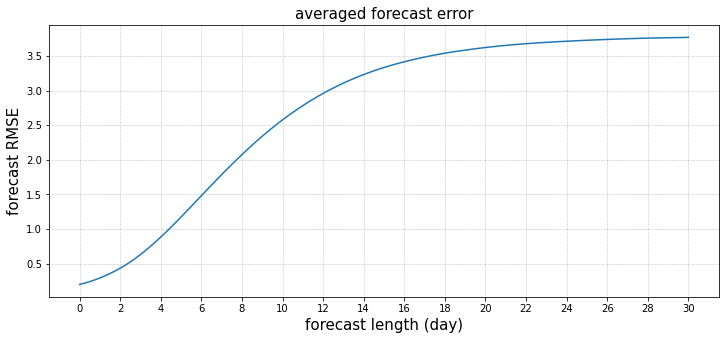

In [35]:
plt.figure(figsize = (12,5))
plt.plot(np.mean(fcst_rmse_store, axis = 0))
plt.ylabel('forecast RMSE', fontsize = 15)
plt.xlabel('forecast length (day)', fontsize = 15)
plt.xticks(np.arange(0,121,8), np.arange(0,31,2))
plt.grid(color = 'grey', linestyle = ':', linewidth = 0.5)
plt.title('averaged forecast error',fontsize = 15)
plt.savefig('averaged_fcst_err', bbox_inches = 'tight')

In [12]:
#study the forecast ability
fcst_days = 30
number_of_6h = int((fcst_days * 24)/6 + 1e-6)
tt = range(120001,130001)
fcst_rmse_store = np.zeros((len(tt),number_of_6h+1))
smd = LORENZ96(N = 40, F = 8)
for q in tt:
    print(q)
    xf_4d_box= np.zeros((das.edim, das.xdim, number_of_6h+1))
    for k in range(das.edim):
        xf_4d_k = smd.run_rk4(0, number_of_6h * 0.05, dt, Xa_history[q,:,k])
        xf_4d_k = xf_4d_k.T
        xf_4d_k = xf_4d_k[:,::10]
        xf_4d_box[k,:,:] = xf_4d_k
    step1 = (np.mean(xf_4d_box, axis = 0) - x_nature[:,q:q+number_of_6h+1])
    step2 =np.sqrt((np.sum(np.square(step1),axis = 0))/40)
    fcst_rmse_store[q-tt[0],:] = step2 
with open("fcst_rmse_store_120000.txt", "wb") as fp:
        pickle.dump(fcst_rmse_store, fp)

120001
120002
120003
120004
120005
120006
120007
120008
120009
120010
120011
120012
120013
120014
120015
120016
120017
120018
120019
120020
120021
120022
120023
120024
120025
120026
120027
120028
120029
120030
120031
120032
120033
120034
120035
120036
120037
120038
120039
120040
120041
120042
120043
120044
120045
120046
120047
120048
120049
120050
120051
120052
120053
120054
120055
120056
120057
120058
120059
120060
120061
120062
120063
120064
120065
120066
120067
120068
120069
120070
120071
120072
120073
120074
120075
120076
120077
120078
120079
120080
120081
120082
120083
120084
120085
120086
120087
120088
120089
120090
120091
120092
120093
120094
120095
120096
120097
120098
120099
120100
120101
120102
120103
120104
120105
120106
120107
120108
120109
120110
120111
120112
120113
120114
120115
120116
120117
120118
120119
120120
120121
120122
120123
120124
120125
120126
120127
120128
120129
120130
120131
120132
120133
120134
120135
120136
120137
120138
120139
120140
120141
120142
120143

121172
121173
121174
121175
121176
121177
121178
121179
121180
121181
121182
121183
121184
121185
121186
121187
121188
121189
121190
121191
121192
121193
121194
121195
121196
121197
121198
121199
121200
121201
121202
121203
121204
121205
121206
121207
121208
121209
121210
121211
121212
121213
121214
121215
121216
121217
121218
121219
121220
121221
121222
121223
121224
121225
121226
121227
121228
121229
121230
121231
121232
121233
121234
121235
121236
121237
121238
121239
121240
121241
121242
121243
121244
121245
121246
121247
121248
121249
121250
121251
121252
121253
121254
121255
121256
121257
121258
121259
121260
121261
121262
121263
121264
121265
121266
121267
121268
121269
121270
121271
121272
121273
121274
121275
121276
121277
121278
121279
121280
121281
121282
121283
121284
121285
121286
121287
121288
121289
121290
121291
121292
121293
121294
121295
121296
121297
121298
121299
121300
121301
121302
121303
121304
121305
121306
121307
121308
121309
121310
121311
121312
121313
121314

122343
122344
122345
122346
122347
122348
122349
122350
122351
122352
122353
122354
122355
122356
122357
122358
122359
122360
122361
122362
122363
122364
122365
122366
122367
122368
122369
122370
122371
122372
122373
122374
122375
122376
122377
122378
122379
122380
122381
122382
122383
122384
122385
122386
122387
122388
122389
122390
122391
122392
122393
122394
122395
122396
122397
122398
122399
122400
122401
122402
122403
122404
122405
122406
122407
122408
122409
122410
122411
122412
122413
122414
122415
122416
122417
122418
122419
122420
122421
122422
122423
122424
122425
122426
122427
122428
122429
122430
122431
122432
122433
122434
122435
122436
122437
122438
122439
122440
122441
122442
122443
122444
122445
122446
122447
122448
122449
122450
122451
122452
122453
122454
122455
122456
122457
122458
122459
122460
122461
122462
122463
122464
122465
122466
122467
122468
122469
122470
122471
122472
122473
122474
122475
122476
122477
122478
122479
122480
122481
122482
122483
122484
122485

123514
123515
123516
123517
123518
123519
123520
123521
123522
123523
123524
123525
123526
123527
123528
123529
123530
123531
123532
123533
123534
123535
123536
123537
123538
123539
123540
123541
123542
123543
123544
123545
123546
123547
123548
123549
123550
123551
123552
123553
123554
123555
123556
123557
123558
123559
123560
123561
123562
123563
123564
123565
123566
123567
123568
123569
123570
123571
123572
123573
123574
123575
123576
123577
123578
123579
123580
123581
123582
123583
123584
123585
123586
123587
123588
123589
123590
123591
123592
123593
123594
123595
123596
123597
123598
123599
123600
123601
123602
123603
123604
123605
123606
123607
123608
123609
123610
123611
123612
123613
123614
123615
123616
123617
123618
123619
123620
123621
123622
123623
123624
123625
123626
123627
123628
123629
123630
123631
123632
123633
123634
123635
123636
123637
123638
123639
123640
123641
123642
123643
123644
123645
123646
123647
123648
123649
123650
123651
123652
123653
123654
123655
123656

124685
124686
124687
124688
124689
124690
124691
124692
124693
124694
124695
124696
124697
124698
124699
124700
124701
124702
124703
124704
124705
124706
124707
124708
124709
124710
124711
124712
124713
124714
124715
124716
124717
124718
124719
124720
124721
124722
124723
124724
124725
124726
124727
124728
124729
124730
124731
124732
124733
124734
124735
124736
124737
124738
124739
124740
124741
124742
124743
124744
124745
124746
124747
124748
124749
124750
124751
124752
124753
124754
124755
124756
124757
124758
124759
124760
124761
124762
124763
124764
124765
124766
124767
124768
124769
124770
124771
124772
124773
124774
124775
124776
124777
124778
124779
124780
124781
124782
124783
124784
124785
124786
124787
124788
124789
124790
124791
124792
124793
124794
124795
124796
124797
124798
124799
124800
124801
124802
124803
124804
124805
124806
124807
124808
124809
124810
124811
124812
124813
124814
124815
124816
124817
124818
124819
124820
124821
124822
124823
124824
124825
124826
124827

125856
125857
125858
125859
125860
125861
125862
125863
125864
125865
125866
125867
125868
125869
125870
125871
125872
125873
125874
125875
125876
125877
125878
125879
125880
125881
125882
125883
125884
125885
125886
125887
125888
125889
125890
125891
125892
125893
125894
125895
125896
125897
125898
125899
125900
125901
125902
125903
125904
125905
125906
125907
125908
125909
125910
125911
125912
125913
125914
125915
125916
125917
125918
125919
125920
125921
125922
125923
125924
125925
125926
125927
125928
125929
125930
125931
125932
125933
125934
125935
125936
125937
125938
125939
125940
125941
125942
125943
125944
125945
125946
125947
125948
125949
125950
125951
125952
125953
125954
125955
125956
125957
125958
125959
125960
125961
125962
125963
125964
125965
125966
125967
125968
125969
125970
125971
125972
125973
125974
125975
125976
125977
125978
125979
125980
125981
125982
125983
125984
125985
125986
125987
125988
125989
125990
125991
125992
125993
125994
125995
125996
125997
125998

127027
127028
127029
127030
127031
127032
127033
127034
127035
127036
127037
127038
127039
127040
127041
127042
127043
127044
127045
127046
127047
127048
127049
127050
127051
127052
127053
127054
127055
127056
127057
127058
127059
127060
127061
127062
127063
127064
127065
127066
127067
127068
127069
127070
127071
127072
127073
127074
127075
127076
127077
127078
127079
127080
127081
127082
127083
127084
127085
127086
127087
127088
127089
127090
127091
127092
127093
127094
127095
127096
127097
127098
127099
127100
127101
127102
127103
127104
127105
127106
127107
127108
127109
127110
127111
127112
127113
127114
127115
127116
127117
127118
127119
127120
127121
127122
127123
127124
127125
127126
127127
127128
127129
127130
127131
127132
127133
127134
127135
127136
127137
127138
127139
127140
127141
127142
127143
127144
127145
127146
127147
127148
127149
127150
127151
127152
127153
127154
127155
127156
127157
127158
127159
127160
127161
127162
127163
127164
127165
127166
127167
127168
127169

128198
128199
128200
128201
128202
128203
128204
128205
128206
128207
128208
128209
128210
128211
128212
128213
128214
128215
128216
128217
128218
128219
128220
128221
128222
128223
128224
128225
128226
128227
128228
128229
128230
128231
128232
128233
128234
128235
128236
128237
128238
128239
128240
128241
128242
128243
128244
128245
128246
128247
128248
128249
128250
128251
128252
128253
128254
128255
128256
128257
128258
128259
128260
128261
128262
128263
128264
128265
128266
128267
128268
128269
128270
128271
128272
128273
128274
128275
128276
128277
128278
128279
128280
128281
128282
128283
128284
128285
128286
128287
128288
128289
128290
128291
128292
128293
128294
128295
128296
128297
128298
128299
128300
128301
128302
128303
128304
128305
128306
128307
128308
128309
128310
128311
128312
128313
128314
128315
128316
128317
128318
128319
128320
128321
128322
128323
128324
128325
128326
128327
128328
128329
128330
128331
128332
128333
128334
128335
128336
128337
128338
128339
128340

129369
129370
129371
129372
129373
129374
129375
129376
129377
129378
129379
129380
129381
129382
129383
129384
129385
129386
129387
129388
129389
129390
129391
129392
129393
129394
129395
129396
129397
129398
129399
129400
129401
129402
129403
129404
129405
129406
129407
129408
129409
129410
129411
129412
129413
129414
129415
129416
129417
129418
129419
129420
129421
129422
129423
129424
129425
129426
129427
129428
129429
129430
129431
129432
129433
129434
129435
129436
129437
129438
129439
129440
129441
129442
129443
129444
129445
129446
129447
129448
129449
129450
129451
129452
129453
129454
129455
129456
129457
129458
129459
129460
129461
129462
129463
129464
129465
129466
129467
129468
129469
129470
129471
129472
129473
129474
129475
129476
129477
129478
129479
129480
129481
129482
129483
129484
129485
129486
129487
129488
129489
129490
129491
129492
129493
129494
129495
129496
129497
129498
129499
129500
129501
129502
129503
129504
129505
129506
129507
129508
129509
129510
129511

In [153]:
def calculate():
    import math
    a = [math.sqrt(i) for i in range(100000)]

In [154]:
%%timeit 
calculate()

15.1 ms ± 361 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [8]:
import pickle

with open("6_h_Xf_history.txt", "wb") as fp:
            pickle.dump(Xf_history, fp)
with open("6_h_Xa_history.txt", "wb") as fp:
            pickle.dump(Xa_history, fp)
        
das.setKH(KH_history,KH_idx)
xa_history[0,0:das.xdim] = das.x0
#print('xa_history[:,:] = ')
#print(xa_history)
#print('Last background error covariance matrix Xa*Xa.T = ')
#print(np.dot(Xa,np.transpose(Xa)))
#sv.setEnsTrajectory(Ecorre_history)

sv.setXaTrajectory(Xa_history)
sv.setTrajectory(xa_history)
sv.setName(name)
das.setStateVector(sv)

outfile='6_h_x_analysis'+'_'+method+'.pkl'
das.save(outfile)

#print(das)

In [2]:
import pickle
#with open("6_h_Xf_history.txt", "rb") as fp:   # Unpickling
#    Xf_history = pickle.load(fp)
with open("6_h_Xa_history.txt", "rb") as fp:   # Unpickling
    Xa_history = pickle.load(fp)

In [3]:
#when you start from a bread down, please load the documents first
from class_state_vec import state_vector
from class_da_sys import da_system
sv = state_vector()
das = da_system()
#Xf_history = sv.load('6_h_Xf_history.txt')
#das = das.load('6_h_x_analysis_EnKF.pkl')
sv2 = das.getStateVector()
#xa_history = sv2.getTrajectory()
#Xa_history = sv2.getXaTrajectory() 
name = 'x_analysis'
infile = name+'_init.pkl'
das = da_system()
das = das.load(infile)#   
sv = das.getStateVector()
#x_nature = sv.getTrajectory()
acyc_step = das.acyc_step
print(acyc_step)

1


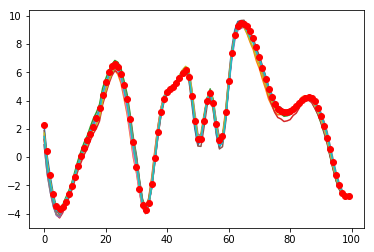

In [4]:
import matplotlib.pyplot as plt
plt.plot(Xa_history[1201:1301,2,:])
#plt.plot(Xf_history[1201:1301,2,:], linestyle = 'None', marker = 'o', color = 'b')
plt.plot(x_nature[2,1201:1301], linestyle = 'None', marker = 'o', color = 'r')
plt.rcParams['figure.figsize'] = [30/1, 8/1]

In [5]:
threshold = sv.load('extreme_threshold.txt') 
threshold

14.216876519713022

In [377]:
#t 0.05 = 6 hour
trial = 8
rk = 0.7
base_norm  = 0.1989 #the 100 years averaged 6-h analysis rmse
norm = rk*base_norm
inter_step = 5
days_before = 4
obs_error_std = 1
untouch_state = [] #random.sample(range(40),10)
#t_start = int(glo_extreme_series[2,-2] + 1e-6)
t_start = 1000
position = int((days_before * 24)/6 + 1e-6) # 1 position store each 6-hour observation
#Xa_initial = Xa_history[t_start - position, :, :]
Xa_initial = Xa_history[t_start, :, :]
Xa_initial = np.matrix(Xa_initial)
#x_original = x_nature[:,t_start - position]
x_original = x_nature[:,t_start]
experiment_step = 146000
evo_history = np.zeros((xdim, experiment_step * inter_step + 1))
evo_history[:,0]=x_original
t = np.arange(0, position * 0.01 * inter_step + 0.001, 0.01)
t_output = t

t_conti = np.arange(0, 0.01 * inter_step + 0.001, 0.01)
t_conti_output = np.arange(0.01, 0.01 * inter_step + 0.001, 0.01)

xf_4d_box= np.zeros((das.edim , das.xdim, len(t)))

ub = threshold
per_rad = 15

smd = LORENZ96(N = 40, F = 8)
perturbed = False

Xa_history_control = np.zeros((experiment_step+1, das.xdim, das.edim))
Xa_history_control[0, :, :] = Xa_initial

perturbed_time = []
success_perturbed_time = []
false_alarm_perturbed_time = []

#no_ch_bkp = np.zeros((experiment_step, das.xdim, das.edim))
no_ch_bkp = np.zeros((das.edim, das.xdim, len(t)))

control_t_all = []
fa_control_t_all = []
s_control_t_all = []

ready =0

fa_fcst_err_all = []
fa_fcst_sprd_all = []
fa_ana_err_all = []
s_fcst_err_all = []
s_fcst_sprd_all = []
s_ana_err_all = []
f_fcst_err_all = []
f_fcst_sprd_all = []
f_ana_err_all = []
np_fcst_err_all = []
np_fcst_sprd_all = []
np_ana_err_all = []

fcst_err_hist = np.zeros((experiment_step,position+1))
ana_err_hist = np.zeros((experiment_step,position+1))
fcst_sprd_hist = np.zeros((experiment_step,position+1))
ana_sprd_hist = np.zeros((experiment_step,position+1))
fail_c = 0
perturbation_all_history = np.zeros((xdim, experiment_step * inter_step + 1)) #20210704
for time in range(experiment_step):
    print(time)
    #if not all(item > lb and item < ub for item in (evo_history[:,(time-1)*inter_step+1:time * inter_step+1]).flatten()):
    if time>0:
        if max((evo_history[:,(time-1)*inter_step+1:time * inter_step+1]).flatten())>ub:
            cant_control = True
            print('fail control')
            fail_c = fail_c + 1
            #break
    amp = 1/norm
    change_ens = []
    unchange_ens = []
    p_change = 0
    if perturbed or time ==0:
        evol = smd.run_rk4(t[0],t[-1],dt,x_original)
        evol = evol[::2,:]
        evol = evol.T
        if perturbed and not false_alarm:
            #if all(item > lb and item < ub for item in (evol[:,0:-inter_step]).flatten()):
            if max((evol[:,0:-inter_step]).flatten())<ub:
                success_perturbed_time = np.hstack((success_perturbed_time,np.arange((time-1)*inter_step + 1, (time)*inter_step)))
    else:
        evol_conti = smd.run_rk4(t_conti[0], t_conti[-1], dt, evol[:,-1])
        evol_conti = evol_conti[2::2,:]
        evol_conti = evol_conti.T
        evol = np.hstack((evol[:,inter_step:], evol_conti))
    ex_find = False
    for k in range(das.edim):
        xf_ens = smd.run_rk4(t[0], t[-1], dt, Xa_initial[:,k].A1)
        xf_ens = xf_ens[::2,:]
        xf_ens = xf_ens.T
        #if all(item > lb and item < ub for item in (xf_ens[:,:]).flatten()):
        if max((xf_ens[:,:]).flatten())<ub:
            unchange_ens.append(k)
            #no_ch_bkp[time, :,k]= xf_ens[:,0]
            no_ch_bkp[k,:,:]= xf_ens
        else:
            ex_find = True
            change_ens.append(k)
            p_change = p_change + 1
           
        xf_4d_box[k,:,:] = xf_ens
    #ex_num = 0
    if ex_find:
        extreme_loc = np.where(xf_4d_box == xf_4d_box.max())
    '''
    if xf_4d_box.min() < lb:
        ex_num = ex_num + 1
        extreme_loc = np.where(xf_4d_box == xf_4d_box.min())
        ex_l = np.where(xf_4d_box == xf_4d_box.min())
        #print('l extreme = ', xf_4d_box[extreme_loc])
    if ex_num >1:
        if ex_u[2] >=ex_l[2]:
            extreme_loc = np.where(xf_4d_box == xf_4d_box.min())
        else:
            extreme_loc = np.where(xf_4d_box == xf_4d_box.max())
        print('WHAT!')
        #break
    '''
    
    if p_change < das.edim and p_change > 0:
        false_alarm = False
        perturbed = True
        perturbed_time = np.hstack((perturbed_time,np.arange(time*inter_step + 1, (time+1)*inter_step)))

        #if all(item > lb and item < ub for item in (evol[:,:]).flatten()):
        if max((evol[:,:]).flatten()) < ub:
            false_alarm = True
            false_alarm_perturbed_time = np.hstack((false_alarm_perturbed_time,np.arange(time*inter_step + 1, (time+1)*inter_step)))
        else:
            draw = True

        #perturbation_all = xf_4d_box[np.random.choice(unchange_ens),:,1:inter_step]-xf_4d_box[np.random.choice(change_ens),:,1:inter_step]
        p = np.where(abs(xf_4d_box[unchange_ens,extreme_loc[1],extreme_loc[2]] - xf_4d_box[extreme_loc]) == abs(xf_4d_box[unchange_ens,extreme_loc[1],extreme_loc[2]] - xf_4d_box[extreme_loc]).max())
        
        perturbation_all = xf_4d_box[unchange_ens[p[0][0]],:,1:inter_step] - xf_4d_box[extreme_loc[0],:,1:inter_step]
        
        perturbation_all = perturbation_all[0,:,:]
        touch_state =[]
        for i in range(extreme_loc[1][0]- per_rad, extreme_loc[1][0]+per_rad+1):
            touch_state.append((i+40)%40)
        untouch_state =np.array(list(set(np.arange(40))-set(touch_state)))
        #perturbation_all[untouch_state,:]=0
        perturbation_vector = perturbation_all/(amp*np.linalg.norm(perturbation_all,axis = 0))
        perturbation_vector[untouch_state,:]=0
        perturbation_all_history[:,time*inter_step+1:time*inter_step+inter_step] = perturbation_vector#20210704
        x_original_gen = smd.run_rk4(0,0.01, dt, x_original)
        x_original_gen = x_original_gen[::2,:]
        x_original_gen = x_original_gen.T
        x_original = x_original_gen[:,1]
        for q in range(inter_step-1):
            x_perturbed_ini = x_original + perturbation_vector[:,q]
            evo_history[:,time * inter_step + q + 1] = x_perturbed_ini
            perturbed_nature_evo = smd.run_rk4(0,0.01, dt, x_perturbed_ini)
            perturbed_nature_evo = perturbed_nature_evo[::2,:]
            perturbed_nature_evo = perturbed_nature_evo.T
            x_original = perturbed_nature_evo[:,1]
        evo_history[:, time * inter_step + inter_step] = x_original
        
        fcst_err = np.sqrt(np.mean(np.square(np.mean(xf_4d_box[:,:,::inter_step], axis = 0) - evol[:,::inter_step]), axis=0))
        fcst_sprd = np.mean(np.std(xf_4d_box[:,:,::inter_step], axis = 0), axis = 0)
        fcst_sprd_hist[time] = fcst_sprd
        fcst_err_hist[time]=fcst_err

        obs = x_original + np.random.normal(0,obs_error_std,das.xdim)
        
        local = 19
        yo_loc = np.zeros(2*local+1)
        #Xb_loc = np.zeros((2*local+1,das.edim))
        Yb_loc = np.zeros((2*local+1,das.edim))
        ym_loc = np.zeros((2*local+1,1))
        #xm_loc = np.zeros((2*local+1,1))

        Yb = np.dot(H,xf_4d_box[0:das.edim,:,inter_step].T)
        yo = np.matrix(obs).flatten().T
        ym = np.mean(Yb, axis = 1)
        xm = np.mean(xf_4d_box[0:das.edim,:,inter_step].T,axis=1)
        Xb = xf_4d_box[0:das.edim,:,inter_step].T - np.matlib.repmat(xm, das.edim,1).T
        Yb = Yb - np.matlib.repmat(ym, das.edim, 1).T 
        Xa = np.zeros((xdim,das.edim))

        for b in range(xdim):
            ind = np.arange(b-local,b+local+1)
            ind = (ind + 40)%40
            nn = 0
            for bb in ind:
                yo_loc[nn] = obs[bb]
                #Xb_loc[nn,:] = Xb[bb,:]
                Yb_loc[nn,:] = Yb[bb,:]
                ym_loc[nn] = ym[bb]
                #xm_loc[nn] = xm[bb]
                nn = nn + 1
            Xb_loc = Xb[b,:]
            xm_loc = xm[b]
            Xa_loc, KH_loc = das.compute_analysis(Xb_loc,yo_loc,Yb_loc,ym_loc,xm_loc)
            Xa[b,:] = Xa_loc
        Xa = np.matrix(Xa)

        #Xa, KH = das.compute_analysis(xf_4d_box[0:das.edim,:,inter_step].T,obs)
        Xa_history_control[time+1,:,:] = Xa
        Xa_initial = Xa 
        Xa_initial = np.matrix(Xa_initial)
        
    elif p_change < 1:
        per_times = 0
        perturbed = False

        evo_history[:, time * inter_step + 1 : time * inter_step + inter_step + 1] = evol[:,1:inter_step+1]
        x_original = evol[:,inter_step]

        fcst_err = np.sqrt(np.mean(np.square(np.mean(xf_4d_box[:,:,::inter_step], axis = 0) - evol[:,::inter_step]), axis=0))
        fcst_sprd = np.mean(np.std(xf_4d_box[:,:,::inter_step], axis = 0), axis = 0)
        fcst_sprd_hist[time] = fcst_sprd
        fcst_err_hist[time]=fcst_err

        obs = x_original + np.random.normal(0,obs_error_std,das.xdim)
        
        local = 19
        yo_loc = np.zeros(2*local+1)
        #Xb_loc = np.zeros((2*local+1,das.edim))
        Yb_loc = np.zeros((2*local+1,das.edim))
        ym_loc = np.zeros((2*local+1,1))
        #xm_loc = np.zeros((2*local+1,1))

        Yb = np.dot(H,xf_4d_box[0:das.edim,:,inter_step].T)
        yo = np.matrix(obs).flatten().T
        ym = np.mean(Yb, axis = 1)
        xm = np.mean(xf_4d_box[0:das.edim,:,inter_step].T,axis=1)
        Xb = xf_4d_box[0:das.edim,:,inter_step].T - np.matlib.repmat(xm, das.edim,1).T
        Yb = Yb - np.matlib.repmat(ym, das.edim,1).T
        Xa = np.zeros((xdim,das.edim))

        for b in range(xdim):
            ind = np.arange(b-local,b+local+1)
            ind = (ind + 40)%40
            nn = 0
            for bb in ind:
                yo_loc[nn] = obs[bb]
                #Xb_loc[nn,:] = Xb[bb,:]
                Yb_loc[nn,:] = Yb[bb,:]
                ym_loc[nn] = ym[bb]
                #xm_loc[nn] = xm[bb]
                nn = nn + 1
            Xb_loc = Xb[b,:]
            xm_loc = xm[b]
            Xa_loc, KH_loc = das.compute_analysis(Xb_loc,yo_loc,Yb_loc,ym_loc,xm_loc)
            Xa[b,:] = Xa_loc
        Xa = np.matrix(Xa)

        Xa_history_control[time+1,:,:] = Xa
        Xa_initial = Xa 
        Xa_initial = np.matrix(Xa_initial)
    else:
        print('search history')
        false_alarm = False
        perturbed = True
        perturbed_time = np.hstack((perturbed_time,np.arange(time*inter_step + 1, (time+1)*inter_step)))
        #if all(item > lb and item < ub for item in (evol[:,:]).flatten()):
        if max((evol[:,:]).flatten()) < ub:
            false_alarm = True
            false_alarm_perturbed_time = np.hstack((false_alarm_perturbed_time,np.arange(time*inter_step + 1, (time+1)*inter_step)))
        
        if time == 0:
            find = False
            #for l in range(1, t_start - position, 1):
            for l in range(1, t_start, 1):
                #Xa_before = Xa_hisory[(t_start - position)-l, :, :]
                Xa_before = Xa_hisory[t_start-l, :, :]
                Xa_before = np.matrix(Xa_before)
                t_b = np.arange(0, l * inter_step * 0.01 + position * 0.01 * inter_step + 0.001, 0.01)
                #t_b_output = t_b[l*inter_step+1:]
                for v in range(das.edim):
                    xf_ens = smd.run_rk4(t_b[0], t_b[-1], dt, Xa_before[:,v].A1)
                    xf_ens = xf_ens[2*(l*inter_step+1)::2,:]
                    xf_ens = xf_ens.T

                    #if all(item > lb and item < ub for item in (xf_ens[:,:]).flatten()):
                    if max((xf_ens[:,:]).flatten()) < ub:
                        find = True
                        #perturbation_all = xf_ens[:,0:inter_step-1] - xf_4d_box[np.random.choice(change_ens),:,1:inter_step]
                        perturbation_all = xf_ens[:,0:inter_step-1] - xf_4d_box[extreme_loc[0],:,1:inter_step][0]
                        touch_state =[]
                        for i in range(extreme_loc[1][0]- per_rad, extreme_loc[1][0]+per_rad+1):
                            touch_state.append((i+40)%40)
                        untouch_state =np.array(list(set(np.arange(40))-set(touch_state)))
                        #perturbation_all[untouch_state,:]=0
                        perturbation_vector = perturbation_all/(amp*np.linalg.norm(perturbation_all,axis = 0))
                        perturbation_vector[untouch_state,:]=0
                        perturbation_all_history[:,time*inter_step+1:time*inter_step+inter_step] = perturbation_vector#20210704
                        
                        x_original_gen = smd.run_rk4(0,0.01, dt, x_original)
                        x_original_gen = x_original_gen[::2,:]
                        x_original_gen = x_original_gen.T
                        x_original = x_original_gen[:,1]
                        for q in range(inter_step-1):
                            x_perturbed_ini = x_original + perturbation_vector[:,q]
                            evo_history[:, time * inter_step + q + 1] = x_perturbed_ini
                            perturbed_nature_evo = smd.run_rk4(0,0.01, dt, x_perturbed_ini)
                            perturbed_nature_evo = perturbed_nature_evo[::2,:]
                            perturbed_nature_evo = perturbed_nature_evo.T
                            x_original = perturbed_nature_evo[:,1]
                        evo_history[:, time * inter_step + inter_step] = x_original
                        
                        fcst_err = np.sqrt(np.mean(np.square(np.mean(xf_4d_box[:,:,::inter_step], axis = 0) - evol[:,::inter_step]), axis=0))
                        fcst_sprd = np.mean(np.std(xf_4d_box[:,:,::inter_step], axis = 0), axis = 0)
                        fcst_sprd_hist[time] = fcst_sprd
                        fcst_err_hist[time]=fcst_err
                        
                        obs = x_original + np.random.normal(0,obs_error_std,das.xdim)
                        local = 19
                        yo_loc = np.zeros(2*local+1)
                        Yb_loc = np.zeros((2*local+1,das.edim))
                        ym_loc = np.zeros((2*local+1,1))

                        Yb = np.dot(H,xf_4d_box[0:das.edim,:,inter_step].T)
                        yo = np.matrix(obs).flatten().T
                        ym = np.mean(Yb, axis = 1)
                        xm = np.mean(xf_4d_box[0:das.edim,:,inter_step].T,axis=1)
                        Xb = xf_4d_box[0:das.edim,:,inter_step].T - np.matlib.repmat(xm, das.edim,1).T
                        Yb = Yb - np.matlib.repmat(ym, das.edim,1).T
                        Xa = np.zeros((xdim,das.edim))

                        for b in range(xdim):
                            ind = np.arange(b-local,b+local+1)
                            ind = (ind + 40)%40
                            nn = 0
                            for bb in ind:
                                yo_loc[nn] = obs[bb]
                                Yb_loc[nn,:] = Yb[bb,:]
                                ym_loc[nn] = ym[bb]
                                nn = nn + 1
                            Xb_loc = Xb[b,:]
                            xm_loc = xm[b]
                            Xa_loc, KH_loc = das.compute_analysis(Xb_loc,yo_loc,Yb_loc,ym_loc,xm_loc)
                            Xa[b,:] = Xa_loc
                        Xa = np.matrix(Xa)
                        Xa_history_control[time+1,:,:] = Xa
                        Xa_initial = Xa  
                        Xa_initial = np.matrix(Xa_initial)
                        break
                if find:
                    break
                if not find and l == (t_start - position)-1:
                        sys.exit("Can't find any good perturbation")
        else:                           
            #for s in range(1,time + (t_start - position),1):
            for s in range(1,time + t_start,1):
               if s > time:
                   find = False
                   #for l in range(1, t_start - position, 1):
                   #Xa_before = Xa_history[(t_start - position) - (s-time), :, :]
                   Xa_before = Xa_history[t_start - (s-time), :, :]
                   Xa_before = np.matrix(Xa_before)
                   t_b = np.arange(0, 0.01 * inter_step * (position +  s) + 0.001, 0.01)
                   t_b_output = t_b[s * inter_step + 1:]
                   for v in range(das.edim):
                        xf_ens = smd.run_rk4(t_b[0], t_b[-1], dt, Xa_before[:,v].A1)
                        xf_ens = xf_ens[2*(s * inter_step + 1)::2,:]
                        xf_ens = xf_ens.T
                        #if all(item > lb and item < ub for item in (xf_ens[:,:]).flatten()):
                        if max((xf_ens[:,:]).flatten()) < ub:
                            find = True
                            #perturbation_all = xf_ens[:,0:inter_step-1] - xf_4d_box[np.random.choice(change_ens),:,1:inter_step]
                            perturbation_all = xf_ens[:,0:inter_step-1] - xf_4d_box[extreme_loc[0],:,1:inter_step][0]
                            touch_state =[]
                            for i in range(extreme_loc[1][0]- per_rad, extreme_loc[1][0]+per_rad+1):
                                touch_state.append((i+40)%40)
                            untouch_state =np.array(list(set(np.arange(40))-set(touch_state)))
                            #perturbation_all[untouch_state,:]=0
                            perturbation_vector = perturbation_all/(amp*np.linalg.norm(perturbation_all,axis = 0))
                            perturbation_vector[untouch_state,:]=0
                            perturbation_all_history[:,time*inter_step+1:time*inter_step+inter_step] = perturbation_vector#20210704
                            
                            x_original_gen = smd.run_rk4(0,0.01, dt, x_original)
                            x_original_gen = x_original_gen[::2,:]
                            x_original_gen = x_original_gen.T
                            x_original = x_original_gen[:,1]
                            for q in range(inter_step-1):
                                x_perturbed_ini = x_original + perturbation_vector[:,q]
                                evo_history[:, time * inter_step + q + 1] = x_perturbed_ini
                                perturbed_nature_evo = smd.run_rk4(0,0.01, dt, x_perturbed_ini)
                                perturbed_nature_evo = perturbed_nature_evo[::2,:]
                                perturbed_nature_evo = perturbed_nature_evo.T
                                x_original = perturbed_nature_evo[:,1]
                            evo_history[:, time * inter_step + inter_step] = x_original
                           
                            fcst_err = np.sqrt(np.mean(np.square(np.mean(xf_4d_box[:,:,::inter_step], axis = 0) - evol[:,::inter_step]), axis=0))
                            fcst_sprd = np.mean(np.std(xf_4d_box[:,:,::inter_step], axis = 0), axis = 0)
                            fcst_sprd_hist[time] = fcst_sprd
                            fcst_err_hist[time]=fcst_err
                           
                            obs = x_original + np.random.normal(0,obs_error_std,das.xdim)
                            local = 19
                            yo_loc = np.zeros(2*local+1)
                            Yb_loc = np.zeros((2*local+1,das.edim))
                            ym_loc = np.zeros((2*local+1,1))

                            Yb = np.dot(H,xf_4d_box[0:das.edim,:,inter_step].T)
                            yo = np.matrix(obs).flatten().T
                            ym = np.mean(Yb, axis = 1)
                            xm = np.mean(xf_4d_box[0:das.edim,:,inter_step].T,axis=1)
                            Xb = xf_4d_box[0:das.edim,:,inter_step].T - np.matlib.repmat(xm, das.edim,1).T
                            Yb = Yb - np.matlib.repmat(ym, das.edim,1).T
                            Xa = np.zeros((xdim,das.edim))

                            for b in range(xdim):
                                ind = np.arange(b-local,b+local+1)
                                ind = (ind + 40)%40
                                nn = 0
                                for bb in ind:
                                    yo_loc[nn] = obs[bb]
                                    Yb_loc[nn,:] = Yb[bb,:]
                                    ym_loc[nn] = ym[bb]
                                    nn = nn + 1
                                Xb_loc = Xb[b,:]
                                xm_loc = xm[b]
                                Xa_loc, KH_loc = das.compute_analysis(Xb_loc,yo_loc,Yb_loc,ym_loc,xm_loc)
                                Xa[b,:] = Xa_loc
                            Xa = np.matrix(Xa)
                            Xa_history_control[time+1,:,:] = Xa
                            Xa_initial = Xa
                            Xa_initial = np.matrix(Xa_initial)
                            break
                   if find:
                        break
                   #elif not find and s== time + (t_start - position)-1:
                   elif not find and s== time + (t_start)-1:
                        sys.exit("Can't find any good perturbation")
               else:
                    find = False
                    for w in range(das.edim):
                        t_help = np.arange(0, 0.01 * inter_step * (position +  s) + 0.001, 0.01)
                        t_help_output = t_help[s*inter_step +1:]
                        uc_help = smd.run_rk4(t_help[0], t_help[-1], dt,Xa_history_control[time-s,:, w])
                        uc_help = uc_help[2*(s*inter_step +1)::2,:]
                        uc_help =uc_help.T
                        #if all(item > lb and item < ub for item in (uc_help[:,:]).flatten()):
                        if max((uc_help[:,:]).flatten())<ub:
                            find = True
                            #perturbation_all = uc_help[:,0:inter_step-1] - xf_4d_box[np.random.choice(change_ens),:,1:inter_step]
                            perturbation_all = uc_help[:,0:inter_step-1] - xf_4d_box[extreme_loc[0],:,1:inter_step][0]
                            touch_state =[]
                            for i in range(extreme_loc[1][0]- per_rad, extreme_loc[1][0]+per_rad+1):
                                touch_state.append((i+40)%40)
                            untouch_state =np.array(list(set(np.arange(40))-set(touch_state)))
                            #perturbation_all[untouch_state,:]=0
                            perturbation_vector = perturbation_all/(amp*np.linalg.norm(perturbation_all,axis = 0))
                            perturbation_vector[untouch_state,:]=0
                            perturbation_all_history[:,time*inter_step+1:time*inter_step+inter_step] = perturbation_vector#20210704

                            x_original_gen = smd.run_rk4(0,0.01, dt, x_original)
                            x_original_gen = x_original_gen[::2,:]
                            x_original_gen = x_original_gen.T
                            x_original = x_original_gen[:,1]
                            
                            for q in range(inter_step-1):
                                x_perturbed_ini = x_original + perturbation_vector[:,q]
                                evo_history[:, time * inter_step + q + 1] = x_perturbed_ini
                                perturbed_nature_evo = smd.run_rk4(0,0.01, dt, x_perturbed_ini)
                                perturbed_nature_evo = perturbed_nature_evo[::2,:]
                                perturbed_nature_evo = perturbed_nature_evo.T
                                x_original = perturbed_nature_evo[:,1]
                            evo_history[:, time * inter_step + inter_step] = x_original
                            
                            fcst_err = np.sqrt(np.mean(np.square(np.mean(xf_4d_box[:,:,::inter_step], axis = 0) - evol[:,::inter_step]), axis=0))
                            fcst_sprd = np.mean(np.std(xf_4d_box[:,:,::inter_step], axis = 0), axis = 0)
                            fcst_sprd_hist[time] = fcst_sprd
                            fcst_err_hist[time]=fcst_err
                            
                            obs = x_original + np.random.normal(0,obs_error_std,das.xdim)
                            local = 19
                            yo_loc = np.zeros(2*local+1)
                            Yb_loc = np.zeros((2*local+1,das.edim))
                            ym_loc = np.zeros((2*local+1,1))

                            Yb = np.dot(H,xf_4d_box[0:das.edim,:,inter_step].T)
                            yo = np.matrix(obs).flatten().T
                            ym = np.mean(Yb, axis = 1)
                            xm = np.mean(xf_4d_box[0:das.edim,:,inter_step].T,axis=1)
                            Xb = xf_4d_box[0:das.edim,:,inter_step].T - np.matlib.repmat(xm, das.edim,1).T
                            Yb = Yb - np.matlib.repmat(ym, das.edim,1).T
                            Xa = np.zeros((xdim,das.edim))

                            for b in range(xdim):
                                ind = np.arange(b-local,b+local+1)
                                ind = (ind + 40)%40
                                nn = 0
                                for bb in ind:
                                    yo_loc[nn] = obs[bb]
                                    Yb_loc[nn,:] = Yb[bb,:]
                                    ym_loc[nn] = ym[bb]
                                    nn = nn + 1
                                Xb_loc = Xb[b,:]
                                xm_loc = xm[b]
                                Xa_loc, KH_loc = das.compute_analysis(Xb_loc,yo_loc,Yb_loc,ym_loc,xm_loc)
                                Xa[b,:] = Xa_loc
                            Xa = np.matrix(Xa)
                            Xa_history_control[time+1,:,:] = Xa
                            Xa_initial = Xa
                            Xa_initial = np.matrix(Xa_initial)
                            break
                    if find:
                        break

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1861
1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060


3500
3501
3502
3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699


5139
5140
5141
5142
5143
5144
5145
5146
5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338


6778
6779
6780
6781
6782
6783
6784
6785
6786
6787
6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977


8417
8418
8419
8420
8421
8422
8423
8424
8425
8426
8427
8428
8429
8430
8431
8432
8433
8434
8435
8436
8437
8438
8439
8440
8441
8442
8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616


10047
10048
10049
10050
10051
10052
10053
10054
10055
10056
10057
10058
10059
10060
10061
10062
10063
10064
10065
10066
10067
10068
10069
10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
1021

11413
11414
11415
11416
11417
11418
11419
11420
11421
11422
11423
11424
11425
11426
11427
11428
11429
11430
11431
11432
11433
11434
11435
11436
11437
11438
11439
11440
11441
11442
11443
11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
1157

12779
12780
12781
12782
12783
12784
12785
12786
12787
12788
12789
12790
12791
12792
12793
12794
12795
12796
12797
12798
12799
12800
12801
12802
12803
12804
12805
12806
12807
12808
12809
12810
12811
12812
12813
12814
12815
12816
12817
12818
12819
12820
12821
12822
12823
12824
12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
12934
12935
12936
12937
12938
12939
12940
12941
12942
12943
12944
1294

14145
14146
14147
14148
14149
14150
14151
14152
14153
14154
14155
14156
14157
14158
14159
14160
14161
14162
14163
14164
14165
14166
14167
14168
14169
14170
14171
14172
14173
14174
14175
14176
14177
14178
14179
14180
14181
14182
14183
14184
14185
14186
14187
14188
14189
14190
14191
14192
14193
14194
14195
14196
14197
14198
14199
14200
14201
14202
14203
14204
14205
14206
14207
14208
14209
14210
14211
14212
14213
14214
14215
14216
14217
14218
14219
14220
14221
14222
14223
14224
14225
14226
14227
14228
14229
14230
14231
14232
14233
14234
14235
14236
14237
14238
14239
14240
14241
14242
14243
14244
14245
14246
14247
14248
14249
14250
14251
14252
14253
14254
14255
14256
14257
14258
14259
14260
14261
14262
14263
14264
14265
14266
14267
14268
14269
14270
14271
14272
14273
14274
14275
14276
14277
14278
14279
14280
14281
14282
14283
14284
14285
14286
14287
14288
14289
14290
14291
14292
14293
14294
14295
14296
14297
14298
14299
14300
14301
14302
14303
14304
14305
14306
14307
14308
14309
14310
1431

15511
15512
15513
15514
15515
15516
15517
15518
15519
15520
15521
15522
15523
15524
15525
15526
15527
15528
15529
15530
15531
15532
15533
15534
15535
15536
15537
15538
15539
15540
15541
15542
15543
15544
15545
15546
15547
15548
15549
15550
15551
15552
15553
15554
15555
15556
15557
15558
15559
15560
15561
15562
15563
15564
15565
15566
15567
15568
15569
15570
15571
15572
15573
15574
15575
15576
15577
15578
15579
15580
15581
15582
15583
15584
15585
15586
15587
15588
15589
15590
15591
15592
15593
15594
15595
15596
15597
15598
15599
15600
15601
15602
15603
15604
15605
15606
15607
15608
15609
15610
15611
15612
15613
15614
15615
15616
15617
15618
15619
15620
15621
15622
15623
15624
15625
15626
15627
15628
15629
15630
15631
15632
15633
15634
15635
15636
15637
15638
15639
15640
15641
15642
15643
15644
15645
15646
15647
15648
15649
15650
15651
15652
15653
15654
15655
15656
15657
15658
15659
15660
15661
15662
15663
15664
15665
15666
15667
15668
15669
15670
15671
15672
15673
15674
15675
15676
1567

16877
16878
16879
16880
16881
16882
16883
16884
16885
16886
16887
16888
16889
16890
16891
16892
16893
16894
16895
16896
16897
16898
16899
16900
16901
16902
16903
16904
16905
16906
16907
16908
16909
16910
16911
16912
16913
16914
16915
16916
16917
16918
16919
16920
16921
16922
16923
16924
16925
16926
16927
16928
16929
16930
16931
16932
16933
16934
16935
16936
16937
16938
16939
16940
16941
16942
16943
16944
16945
16946
16947
16948
16949
16950
16951
16952
16953
16954
16955
16956
16957
16958
16959
16960
16961
16962
16963
16964
16965
16966
16967
16968
16969
16970
16971
16972
16973
16974
16975
16976
16977
16978
16979
16980
16981
16982
16983
16984
16985
16986
16987
16988
16989
16990
16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17023
17024
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
1704

18243
18244
18245
18246
18247
18248
18249
18250
18251
18252
18253
18254
18255
18256
18257
18258
18259
18260
18261
18262
18263
18264
18265
18266
18267
18268
18269
18270
18271
18272
18273
18274
18275
18276
18277
18278
18279
18280
18281
18282
18283
18284
18285
18286
18287
18288
18289
18290
18291
18292
18293
18294
18295
18296
18297
18298
18299
18300
18301
18302
18303
18304
18305
18306
18307
18308
18309
18310
18311
18312
18313
18314
18315
18316
18317
18318
18319
18320
18321
18322
18323
18324
18325
18326
18327
18328
18329
18330
18331
18332
18333
18334
18335
18336
18337
18338
18339
18340
18341
18342
18343
18344
18345
18346
18347
18348
18349
18350
18351
18352
18353
18354
18355
18356
18357
18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18386
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
1840

19609
19610
19611
19612
19613
19614
19615
19616
19617
19618
19619
19620
19621
19622
19623
19624
19625
19626
19627
19628
19629
19630
19631
19632
19633
19634
19635
19636
19637
19638
19639
19640
19641
19642
19643
19644
19645
19646
19647
19648
19649
19650
19651
19652
19653
19654
19655
19656
19657
19658
19659
19660
19661
19662
19663
19664
19665
19666
19667
19668
19669
19670
19671
19672
19673
19674
19675
19676
19677
19678
19679
19680
19681
19682
19683
19684
19685
19686
19687
19688
19689
19690
19691
19692
19693
19694
19695
19696
19697
19698
19699
19700
19701
19702
19703
19704
19705
19706
19707
19708
19709
19710
19711
19712
19713
19714
19715
19716
19717
19718
19719
19720
19721
19722
19723
19724
19725
19726
19727
19728
19729
19730
19731
19732
19733
19734
19735
19736
19737
19738
19739
19740
19741
19742
19743
19744
19745
19746
19747
19748
19749
19750
19751
19752
19753
19754
19755
19756
19757
19758
19759
19760
19761
19762
19763
19764
19765
19766
19767
19768
19769
19770
19771
19772
19773
19774
1977

20975
20976
20977
20978
20979
20980
20981
20982
20983
20984
20985
20986
20987
20988
20989
20990
20991
20992
20993
20994
20995
20996
20997
20998
20999
21000
21001
21002
21003
21004
21005
21006
21007
21008
21009
21010
21011
21012
21013
21014
21015
21016
21017
21018
21019
21020
21021
21022
21023
21024
21025
21026
21027
21028
21029
21030
21031
21032
21033
21034
21035
21036
21037
21038
21039
21040
21041
21042
21043
21044
21045
21046
21047
21048
21049
21050
21051
21052
21053
21054
21055
21056
21057
21058
21059
21060
21061
21062
21063
21064
21065
21066
21067
21068
21069
21070
21071
21072
21073
21074
21075
21076
21077
21078
21079
21080
21081
21082
21083
21084
21085
21086
21087
21088
21089
21090
21091
21092
21093
21094
21095
21096
21097
21098
21099
21100
21101
21102
21103
21104
21105
21106
21107
21108
21109
21110
21111
21112
21113
21114
21115
21116
21117
21118
21119
21120
21121
21122
21123
21124
21125
21126
21127
21128
21129
21130
21131
21132
21133
21134
21135
21136
21137
21138
21139
21140
2114

22341
22342
22343
22344
22345
22346
22347
22348
22349
22350
22351
22352
22353
22354
22355
22356
22357
22358
22359
22360
22361
22362
22363
22364
22365
22366
22367
22368
22369
22370
22371
22372
22373
22374
22375
22376
22377
22378
22379
22380
22381
22382
22383
22384
22385
22386
22387
22388
22389
22390
22391
22392
22393
22394
22395
22396
22397
22398
22399
22400
22401
22402
22403
22404
22405
22406
22407
22408
22409
22410
22411
22412
22413
22414
22415
22416
22417
22418
22419
22420
22421
22422
22423
22424
22425
22426
22427
22428
22429
22430
22431
22432
22433
22434
22435
22436
22437
22438
22439
22440
22441
22442
22443
22444
22445
22446
22447
22448
22449
22450
22451
22452
22453
22454
22455
22456
22457
22458
22459
22460
22461
22462
22463
22464
22465
22466
22467
22468
22469
22470
22471
22472
22473
22474
22475
22476
22477
22478
22479
22480
22481
22482
22483
22484
22485
22486
22487
22488
22489
22490
22491
22492
22493
22494
22495
22496
22497
22498
22499
22500
22501
22502
22503
22504
22505
22506
2250

23707
23708
23709
23710
23711
23712
23713
23714
23715
23716
23717
23718
23719
23720
23721
23722
23723
23724
23725
23726
23727
23728
23729
23730
23731
23732
23733
23734
23735
23736
23737
23738
23739
23740
23741
23742
23743
23744
23745
23746
23747
23748
23749
23750
23751
23752
23753
23754
23755
23756
23757
23758
23759
23760
23761
23762
23763
23764
23765
23766
23767
23768
23769
23770
23771
23772
23773
23774
23775
23776
23777
23778
23779
23780
23781
23782
23783
23784
23785
23786
23787
23788
23789
23790
23791
23792
23793
23794
23795
23796
23797
23798
23799
23800
23801
23802
23803
23804
23805
23806
23807
23808
23809
23810
23811
23812
23813
23814
23815
23816
23817
23818
23819
23820
23821
23822
23823
23824
23825
23826
23827
23828
23829
23830
23831
23832
23833
23834
23835
23836
23837
23838
23839
23840
23841
23842
23843
23844
23845
23846
23847
23848
23849
23850
23851
23852
23853
23854
23855
23856
23857
23858
23859
23860
23861
23862
23863
23864
23865
23866
23867
23868
23869
23870
23871
23872
2387

25073
25074
25075
25076
25077
25078
25079
25080
25081
25082
25083
25084
25085
25086
25087
25088
25089
25090
25091
25092
25093
25094
25095
25096
25097
25098
25099
25100
25101
25102
25103
25104
25105
25106
25107
25108
25109
25110
25111
25112
25113
25114
25115
25116
25117
25118
25119
25120
25121
25122
25123
25124
25125
25126
25127
25128
25129
25130
25131
25132
25133
25134
25135
25136
25137
25138
25139
25140
25141
25142
25143
25144
25145
25146
25147
25148
25149
25150
25151
25152
25153
25154
25155
25156
25157
25158
25159
25160
25161
25162
25163
25164
25165
25166
25167
25168
25169
25170
25171
25172
25173
25174
25175
25176
25177
25178
25179
25180
25181
25182
25183
25184
25185
25186
25187
25188
25189
25190
25191
25192
25193
25194
25195
25196
25197
25198
25199
25200
25201
25202
25203
25204
25205
25206
25207
25208
25209
25210
25211
25212
25213
25214
25215
25216
25217
25218
25219
25220
25221
25222
25223
25224
25225
25226
25227
25228
25229
25230
25231
25232
25233
25234
25235
25236
25237
25238
2523

26439
26440
26441
26442
26443
26444
26445
26446
26447
26448
26449
26450
26451
26452
26453
26454
26455
26456
26457
26458
26459
26460
26461
26462
26463
26464
26465
26466
26467
26468
26469
26470
26471
26472
26473
26474
26475
26476
26477
26478
26479
26480
26481
26482
26483
26484
26485
26486
26487
26488
26489
26490
26491
26492
26493
26494
26495
26496
26497
26498
26499
26500
26501
26502
26503
26504
26505
26506
26507
26508
26509
26510
26511
26512
26513
26514
26515
26516
26517
26518
26519
26520
26521
26522
26523
26524
26525
26526
26527
26528
26529
26530
26531
26532
26533
26534
26535
26536
26537
26538
26539
26540
26541
26542
26543
26544
26545
26546
26547
26548
26549
26550
26551
26552
26553
26554
26555
26556
26557
26558
26559
26560
26561
26562
26563
26564
26565
26566
26567
26568
26569
26570
26571
26572
26573
26574
26575
26576
26577
26578
26579
26580
26581
26582
26583
26584
26585
26586
26587
26588
26589
26590
26591
26592
26593
26594
26595
26596
26597
26598
26599
26600
26601
26602
26603
26604
2660

27805
27806
27807
27808
27809
27810
27811
27812
27813
27814
27815
27816
27817
27818
27819
27820
27821
27822
27823
27824
27825
27826
27827
27828
27829
27830
27831
27832
27833
27834
27835
27836
27837
27838
27839
27840
27841
27842
27843
27844
27845
27846
27847
27848
27849
27850
27851
27852
27853
27854
27855
27856
27857
27858
27859
27860
27861
27862
27863
27864
27865
27866
27867
27868
27869
27870
27871
27872
27873
27874
27875
27876
27877
27878
27879
27880
27881
27882
27883
27884
27885
27886
27887
27888
27889
27890
27891
27892
27893
27894
27895
27896
27897
27898
27899
27900
27901
27902
27903
27904
27905
27906
27907
27908
27909
27910
27911
27912
27913
27914
27915
27916
27917
27918
27919
27920
27921
27922
27923
27924
27925
27926
27927
27928
27929
27930
27931
27932
27933
27934
27935
27936
27937
27938
27939
27940
27941
27942
27943
27944
27945
27946
27947
27948
27949
27950
27951
27952
27953
27954
27955
27956
27957
27958
27959
27960
27961
27962
27963
27964
27965
27966
27967
27968
27969
27970
2797

29172
29173
29174
29175
29176
29177
29178
29179
29180
29181
29182
29183
29184
29185
29186
29187
29188
29189
29190
29191
29192
29193
29194
29195
29196
29197
29198
29199
29200
29201
29202
29203
29204
29205
29206
29207
29208
29209
29210
29211
29212
29213
29214
29215
29216
29217
29218
29219
29220
29221
29222
29223
29224
29225
29226
29227
29228
29229
29230
29231
29232
29233
29234
29235
29236
29237
29238
29239
29240
29241
29242
29243
29244
29245
29246
29247
29248
29249
29250
29251
29252
29253
29254
29255
29256
29257
29258
29259
29260
29261
29262
29263
29264
29265
29266
29267
29268
29269
29270
29271
29272
29273
29274
29275
29276
29277
29278
29279
29280
29281
29282
29283
29284
29285
29286
29287
29288
29289
29290
29291
29292
29293
29294
29295
29296
29297
29298
29299
29300
29301
29302
29303
29304
29305
29306
29307
29308
29309
29310
29311
29312
29313
29314
29315
29316
29317
29318
29319
29320
29321
29322
29323
29324
29325
29326
29327
29328
29329
29330
29331
29332
29333
29334
29335
29336
29337
2933

30538
30539
30540
30541
30542
30543
30544
30545
30546
30547
30548
30549
30550
30551
30552
30553
30554
30555
30556
30557
30558
30559
30560
30561
30562
30563
30564
30565
30566
30567
30568
30569
30570
30571
30572
30573
30574
30575
30576
30577
30578
30579
30580
30581
30582
30583
30584
30585
30586
30587
30588
30589
30590
30591
30592
30593
30594
30595
30596
30597
30598
30599
30600
30601
30602
30603
30604
30605
30606
30607
30608
30609
30610
30611
30612
30613
30614
30615
30616
30617
30618
30619
30620
30621
30622
30623
30624
30625
30626
30627
30628
30629
30630
30631
30632
30633
30634
30635
30636
30637
30638
30639
30640
30641
30642
30643
30644
30645
30646
30647
30648
30649
30650
30651
30652
30653
30654
30655
30656
30657
30658
30659
30660
30661
30662
30663
30664
30665
30666
30667
30668
30669
30670
30671
30672
30673
30674
30675
30676
30677
30678
30679
30680
30681
30682
30683
30684
30685
30686
30687
30688
30689
30690
30691
30692
30693
30694
30695
30696
30697
30698
30699
30700
30701
30702
30703
3070

31904
31905
31906
31907
31908
31909
31910
31911
31912
31913
31914
31915
31916
31917
31918
31919
31920
31921
31922
31923
31924
31925
31926
31927
31928
31929
31930
31931
31932
31933
31934
31935
31936
31937
31938
31939
31940
31941
31942
31943
31944
31945
31946
31947
31948
31949
31950
31951
31952
31953
31954
31955
31956
31957
31958
31959
31960
31961
31962
31963
31964
31965
31966
31967
31968
31969
31970
31971
31972
31973
31974
31975
31976
31977
31978
31979
31980
31981
31982
31983
31984
31985
31986
31987
31988
31989
31990
31991
31992
31993
31994
31995
31996
31997
31998
31999
32000
32001
32002
32003
32004
32005
32006
32007
32008
32009
32010
32011
32012
32013
32014
32015
32016
32017
32018
32019
32020
32021
32022
32023
32024
32025
32026
32027
32028
32029
32030
32031
32032
32033
32034
32035
32036
32037
32038
32039
32040
32041
32042
32043
32044
32045
32046
32047
32048
32049
32050
32051
32052
32053
32054
32055
32056
32057
32058
32059
32060
32061
32062
32063
32064
32065
32066
32067
32068
32069
3207

33270
33271
33272
33273
33274
33275
33276
33277
33278
33279
33280
33281
33282
33283
33284
33285
33286
33287
33288
33289
33290
33291
33292
33293
33294
33295
33296
33297
33298
33299
33300
33301
33302
33303
33304
33305
33306
33307
33308
33309
33310
33311
33312
33313
33314
33315
33316
33317
33318
33319
33320
33321
33322
33323
33324
33325
33326
33327
33328
33329
33330
33331
33332
33333
33334
33335
33336
33337
33338
33339
33340
33341
33342
33343
33344
33345
33346
33347
33348
33349
33350
33351
33352
33353
33354
33355
33356
33357
33358
33359
33360
33361
33362
33363
33364
33365
33366
33367
33368
33369
33370
33371
33372
33373
33374
33375
33376
33377
33378
33379
33380
33381
33382
33383
33384
33385
33386
33387
33388
33389
33390
33391
33392
33393
33394
33395
33396
33397
33398
33399
33400
33401
33402
33403
33404
33405
33406
33407
33408
33409
33410
33411
33412
33413
33414
33415
33416
33417
33418
33419
33420
33421
33422
33423
33424
33425
33426
33427
33428
33429
33430
33431
33432
33433
33434
33435
3343

34636
34637
34638
34639
34640
34641
34642
34643
34644
34645
34646
34647
34648
34649
34650
34651
34652
34653
34654
34655
34656
34657
34658
34659
34660
34661
34662
34663
34664
34665
34666
34667
34668
34669
34670
34671
34672
34673
34674
34675
34676
34677
34678
34679
34680
34681
34682
34683
34684
34685
34686
34687
34688
34689
34690
34691
34692
34693
34694
34695
34696
34697
34698
34699
34700
34701
34702
34703
34704
34705
34706
34707
34708
34709
34710
34711
34712
34713
34714
34715
34716
34717
34718
34719
34720
34721
34722
34723
34724
34725
34726
34727
34728
34729
34730
34731
34732
34733
34734
34735
34736
34737
34738
34739
34740
34741
34742
34743
34744
34745
34746
34747
34748
34749
34750
34751
34752
34753
34754
34755
34756
34757
34758
34759
34760
34761
34762
34763
34764
34765
34766
34767
34768
34769
34770
34771
34772
34773
34774
34775
34776
34777
34778
34779
34780
34781
34782
34783
34784
34785
34786
34787
34788
34789
34790
34791
34792
34793
34794
34795
34796
34797
34798
34799
34800
34801
3480

36002
36003
36004
36005
36006
36007
36008
36009
36010
36011
36012
36013
36014
36015
36016
36017
36018
36019
36020
36021
36022
36023
36024
36025
36026
36027
36028
36029
36030
36031
36032
36033
36034
36035
36036
36037
36038
36039
36040
36041
36042
36043
36044
36045
36046
36047
36048
36049
36050
36051
36052
36053
36054
36055
36056
36057
36058
36059
36060
36061
36062
36063
36064
36065
36066
36067
36068
36069
36070
36071
36072
36073
36074
36075
36076
36077
36078
36079
36080
36081
36082
36083
36084
36085
36086
36087
36088
36089
36090
36091
36092
36093
36094
36095
36096
36097
36098
36099
36100
36101
36102
36103
36104
36105
36106
36107
36108
36109
36110
36111
36112
36113
36114
36115
36116
36117
36118
36119
36120
36121
36122
36123
36124
36125
36126
36127
36128
36129
36130
36131
36132
36133
36134
36135
36136
36137
36138
36139
36140
36141
36142
36143
36144
36145
36146
36147
36148
36149
36150
36151
36152
36153
36154
36155
36156
36157
36158
36159
36160
36161
36162
36163
36164
36165
36166
36167
3616

37368
37369
37370
37371
37372
37373
37374
37375
37376
37377
37378
37379
37380
37381
37382
37383
37384
37385
37386
37387
37388
37389
37390
37391
37392
37393
37394
37395
37396
37397
37398
37399
37400
37401
37402
37403
37404
37405
37406
37407
37408
37409
37410
37411
37412
37413
37414
37415
37416
37417
37418
37419
37420
37421
37422
37423
37424
37425
37426
37427
37428
37429
37430
37431
37432
37433
37434
37435
37436
37437
37438
37439
37440
37441
37442
37443
37444
37445
37446
37447
37448
37449
37450
37451
37452
37453
37454
37455
37456
37457
37458
37459
37460
37461
37462
37463
37464
37465
37466
37467
37468
37469
37470
37471
37472
37473
37474
37475
37476
37477
37478
37479
37480
37481
37482
37483
37484
37485
37486
37487
37488
37489
37490
37491
37492
37493
37494
37495
37496
37497
37498
37499
37500
37501
37502
37503
37504
37505
37506
37507
37508
37509
37510
37511
37512
37513
37514
37515
37516
37517
37518
37519
37520
37521
37522
37523
37524
37525
37526
37527
37528
37529
37530
37531
37532
37533
3753

38734
38735
38736
38737
38738
38739
38740
38741
38742
38743
38744
38745
38746
38747
38748
38749
38750
38751
38752
38753
38754
38755
38756
38757
38758
38759
38760
38761
38762
38763
38764
38765
38766
38767
38768
38769
38770
38771
38772
38773
38774
38775
38776
38777
38778
38779
38780
38781
38782
38783
38784
38785
38786
38787
38788
38789
38790
38791
38792
38793
38794
38795
38796
38797
38798
38799
38800
38801
38802
38803
38804
38805
38806
38807
38808
38809
38810
38811
38812
38813
38814
38815
38816
38817
38818
38819
38820
38821
38822
38823
38824
38825
38826
38827
38828
38829
38830
38831
38832
38833
38834
38835
38836
38837
38838
38839
38840
38841
38842
38843
38844
38845
38846
38847
38848
38849
38850
38851
38852
38853
38854
38855
38856
38857
38858
38859
38860
38861
38862
38863
38864
38865
38866
38867
38868
38869
38870
38871
38872
38873
38874
38875
38876
38877
38878
38879
38880
38881
38882
38883
38884
38885
38886
38887
38888
38889
38890
38891
38892
38893
38894
38895
38896
38897
38898
38899
3890

40100
40101
40102
40103
40104
40105
40106
40107
40108
40109
40110
40111
40112
40113
40114
40115
40116
40117
40118
40119
40120
40121
40122
40123
40124
40125
40126
40127
40128
40129
40130
40131
40132
40133
40134
40135
40136
40137
40138
40139
40140
40141
40142
40143
40144
40145
40146
40147
40148
40149
40150
40151
40152
40153
40154
40155
40156
40157
40158
40159
40160
40161
40162
40163
40164
40165
40166
40167
40168
40169
40170
40171
40172
40173
40174
40175
40176
40177
40178
40179
40180
40181
40182
40183
40184
40185
40186
40187
40188
40189
40190
40191
40192
40193
40194
40195
40196
40197
40198
40199
40200
40201
40202
40203
40204
40205
40206
40207
40208
40209
40210
40211
40212
40213
40214
40215
40216
40217
40218
40219
40220
40221
40222
40223
40224
40225
40226
40227
40228
40229
40230
40231
40232
40233
40234
40235
40236
40237
40238
40239
40240
40241
40242
40243
40244
40245
40246
40247
40248
40249
40250
40251
40252
40253
40254
40255
40256
40257
40258
40259
40260
40261
40262
40263
40264
40265
4026

41466
41467
41468
41469
41470
41471
41472
41473
41474
41475
41476
41477
41478
41479
41480
41481
41482
41483
41484
41485
41486
41487
41488
41489
41490
41491
41492
41493
41494
41495
41496
41497
41498
41499
41500
41501
41502
41503
41504
41505
41506
41507
41508
41509
41510
41511
41512
41513
41514
41515
41516
41517
41518
41519
41520
41521
41522
41523
41524
41525
41526
41527
41528
41529
41530
41531
41532
41533
41534
41535
41536
41537
41538
41539
41540
41541
41542
41543
41544
41545
41546
41547
41548
41549
41550
41551
41552
41553
41554
41555
41556
41557
41558
41559
41560
41561
41562
41563
41564
41565
41566
41567
41568
41569
41570
41571
41572
41573
41574
41575
41576
41577
41578
41579
41580
41581
41582
41583
41584
41585
41586
41587
41588
41589
41590
41591
41592
41593
41594
41595
41596
41597
41598
41599
41600
41601
41602
41603
41604
41605
41606
41607
41608
41609
41610
41611
41612
41613
41614
41615
41616
41617
41618
41619
41620
41621
41622
41623
41624
41625
41626
41627
41628
41629
41630
41631
4163

42832
42833
42834
42835
42836
42837
42838
42839
42840
42841
42842
42843
42844
42845
42846
42847
42848
42849
42850
42851
42852
42853
42854
42855
42856
42857
42858
42859
42860
42861
42862
42863
42864
42865
42866
42867
42868
42869
42870
42871
42872
42873
42874
42875
42876
42877
42878
42879
42880
42881
42882
42883
42884
42885
42886
42887
42888
42889
42890
42891
42892
42893
42894
42895
42896
42897
42898
42899
42900
42901
42902
42903
42904
42905
42906
42907
42908
42909
42910
42911
42912
42913
42914
42915
42916
42917
42918
42919
42920
42921
42922
42923
42924
42925
42926
42927
42928
42929
42930
42931
42932
42933
42934
42935
42936
42937
42938
42939
42940
42941
42942
42943
42944
42945
42946
42947
42948
42949
42950
42951
42952
42953
42954
42955
42956
42957
42958
42959
42960
42961
42962
42963
42964
42965
42966
42967
42968
42969
42970
42971
42972
42973
42974
42975
42976
42977
42978
42979
42980
42981
42982
42983
42984
42985
42986
42987
42988
42989
42990
42991
42992
42993
42994
42995
42996
42997
4299

44198
44199
44200
44201
44202
44203
44204
44205
44206
44207
44208
44209
44210
44211
44212
44213
44214
44215
44216
44217
44218
44219
44220
44221
44222
44223
44224
44225
44226
44227
44228
44229
44230
44231
44232
44233
44234
44235
44236
44237
44238
44239
44240
44241
44242
44243
44244
44245
44246
44247
44248
44249
44250
44251
44252
44253
44254
44255
44256
44257
44258
44259
44260
44261
44262
44263
44264
44265
44266
44267
44268
44269
44270
44271
44272
44273
44274
44275
44276
44277
44278
44279
44280
44281
44282
44283
44284
44285
44286
44287
44288
44289
44290
44291
44292
44293
44294
44295
44296
44297
44298
44299
44300
44301
44302
44303
44304
44305
44306
44307
44308
44309
44310
44311
44312
44313
44314
44315
44316
44317
44318
44319
44320
44321
44322
44323
44324
44325
44326
44327
44328
44329
44330
44331
44332
44333
44334
44335
44336
44337
44338
44339
44340
44341
44342
44343
44344
44345
44346
44347
44348
44349
44350
44351
44352
44353
44354
44355
44356
44357
44358
44359
44360
44361
44362
44363
4436

45564
45565
45566
45567
45568
45569
45570
45571
45572
45573
45574
45575
45576
45577
45578
45579
45580
45581
45582
45583
45584
45585
45586
45587
45588
45589
45590
45591
45592
45593
45594
45595
45596
45597
45598
45599
45600
45601
45602
45603
45604
45605
45606
45607
45608
45609
45610
45611
45612
45613
45614
45615
45616
45617
45618
45619
45620
45621
45622
45623
45624
45625
45626
45627
45628
45629
45630
45631
45632
45633
45634
45635
45636
45637
45638
45639
45640
45641
45642
45643
45644
45645
45646
45647
45648
45649
45650
45651
45652
45653
45654
45655
45656
45657
45658
45659
45660
45661
45662
45663
45664
45665
45666
45667
45668
45669
45670
45671
45672
45673
45674
45675
45676
45677
45678
45679
45680
45681
45682
45683
45684
45685
45686
45687
45688
45689
45690
45691
45692
45693
45694
45695
45696
45697
45698
45699
45700
45701
45702
45703
45704
45705
45706
45707
45708
45709
45710
45711
45712
45713
45714
45715
45716
45717
45718
45719
45720
45721
45722
45723
45724
45725
45726
45727
45728
45729
4573

46930
46931
46932
46933
46934
46935
46936
46937
46938
46939
46940
46941
46942
46943
46944
46945
46946
46947
46948
46949
46950
46951
46952
46953
46954
46955
46956
46957
46958
46959
46960
46961
46962
46963
46964
46965
46966
46967
46968
46969
46970
46971
46972
46973
46974
46975
46976
46977
46978
46979
46980
46981
46982
46983
46984
46985
46986
46987
46988
46989
46990
46991
46992
46993
46994
46995
46996
46997
46998
46999
47000
47001
47002
47003
47004
47005
47006
47007
47008
47009
47010
47011
47012
47013
47014
47015
47016
47017
47018
47019
47020
47021
47022
47023
47024
47025
47026
47027
47028
47029
47030
47031
47032
47033
47034
47035
47036
47037
47038
47039
47040
47041
47042
47043
47044
47045
47046
47047
47048
47049
47050
47051
47052
47053
47054
47055
47056
47057
47058
47059
47060
47061
47062
47063
47064
47065
47066
47067
47068
47069
47070
47071
47072
47073
47074
47075
47076
47077
47078
47079
47080
47081
47082
47083
47084
47085
47086
47087
47088
47089
47090
47091
47092
47093
47094
47095
4709

48296
48297
48298
48299
48300
48301
48302
48303
48304
48305
48306
48307
48308
48309
48310
48311
48312
48313
48314
48315
48316
48317
48318
48319
48320
48321
48322
48323
48324
48325
48326
48327
48328
48329
48330
48331
48332
48333
48334
48335
48336
48337
48338
48339
48340
48341
48342
48343
48344
48345
48346
48347
48348
48349
48350
48351
48352
48353
48354
48355
48356
48357
48358
48359
48360
48361
48362
48363
48364
48365
48366
48367
48368
48369
48370
48371
48372
48373
48374
48375
48376
48377
48378
48379
48380
48381
48382
48383
48384
48385
48386
48387
48388
48389
48390
48391
48392
48393
48394
48395
48396
48397
48398
48399
48400
48401
48402
48403
48404
48405
48406
48407
48408
48409
48410
48411
48412
48413
48414
48415
48416
48417
48418
48419
48420
48421
48422
48423
48424
48425
48426
48427
48428
48429
48430
48431
48432
48433
48434
48435
48436
48437
48438
48439
48440
48441
48442
48443
48444
48445
48446
48447
48448
48449
48450
48451
48452
48453
48454
48455
48456
48457
48458
48459
48460
48461
4846

49657
49658
49659
49660
49661
49662
49663
49664
49665
49666
49667
49668
49669
49670
49671
49672
49673
49674
49675
49676
49677
49678
49679
49680
49681
49682
49683
49684
49685
49686
49687
49688
49689
49690
49691
49692
49693
49694
49695
49696
49697
49698
49699
49700
49701
49702
49703
49704
49705
49706
49707
49708
49709
49710
49711
49712
49713
49714
49715
49716
49717
49718
49719
49720
49721
49722
49723
49724
49725
49726
49727
49728
49729
49730
49731
49732
49733
49734
49735
49736
49737
49738
49739
49740
49741
49742
49743
49744
49745
49746
49747
49748
49749
49750
49751
49752
49753
49754
49755
49756
49757
49758
49759
49760
49761
49762
49763
49764
49765
49766
49767
49768
49769
49770
49771
49772
49773
49774
49775
49776
49777
49778
49779
49780
49781
49782
49783
49784
49785
49786
49787
49788
49789
49790
49791
49792
49793
49794
49795
49796
49797
49798
49799
49800
49801
49802
49803
49804
49805
49806
49807
49808
49809
49810
49811
49812
49813
49814
49815
49816
49817
49818
49819
49820
49821
49822
4982

51023
51024
51025
51026
51027
51028
51029
51030
51031
51032
51033
51034
51035
51036
51037
51038
51039
51040
51041
51042
51043
51044
51045
51046
51047
51048
51049
51050
51051
51052
51053
51054
51055
51056
51057
51058
51059
51060
51061
51062
51063
51064
51065
51066
51067
51068
51069
51070
51071
51072
51073
51074
51075
51076
51077
51078
51079
51080
51081
51082
51083
51084
51085
51086
51087
51088
51089
51090
51091
51092
51093
51094
51095
51096
51097
51098
51099
51100
51101
51102
51103
51104
51105
51106
51107
51108
51109
51110
51111
51112
51113
51114
51115
51116
51117
51118
51119
51120
51121
51122
51123
51124
51125
51126
51127
51128
51129
51130
51131
51132
51133
51134
51135
51136
51137
51138
51139
51140
51141
51142
51143
51144
51145
51146
51147
51148
51149
51150
51151
51152
51153
51154
51155
51156
51157
51158
51159
51160
51161
51162
51163
51164
51165
51166
51167
51168
51169
51170
51171
51172
51173
51174
51175
51176
51177
51178
51179
51180
51181
51182
51183
51184
51185
51186
51187
51188
5118

52389
52390
52391
52392
52393
52394
52395
52396
52397
52398
52399
52400
52401
52402
52403
52404
52405
52406
52407
52408
52409
52410
52411
52412
52413
52414
52415
52416
52417
52418
52419
52420
52421
52422
52423
52424
52425
52426
52427
52428
52429
52430
52431
52432
52433
52434
52435
52436
52437
52438
52439
52440
52441
52442
52443
52444
52445
52446
52447
52448
52449
52450
52451
52452
52453
52454
52455
52456
52457
52458
52459
52460
52461
52462
52463
52464
52465
52466
52467
52468
52469
52470
52471
52472
52473
52474
52475
52476
52477
52478
52479
52480
52481
52482
52483
52484
52485
52486
52487
52488
52489
52490
52491
52492
52493
52494
52495
52496
52497
52498
52499
52500
52501
52502
52503
52504
52505
52506
52507
52508
52509
52510
52511
52512
52513
52514
52515
52516
52517
52518
52519
52520
52521
52522
52523
52524
52525
52526
52527
52528
52529
52530
52531
52532
52533
52534
52535
52536
52537
52538
52539
52540
52541
52542
52543
52544
52545
52546
52547
52548
52549
52550
52551
52552
52553
52554
5255

53755
53756
53757
53758
53759
53760
53761
53762
53763
53764
53765
53766
53767
53768
53769
53770
53771
53772
53773
53774
53775
53776
53777
53778
53779
53780
53781
53782
53783
53784
53785
53786
53787
53788
53789
53790
53791
53792
53793
53794
53795
53796
53797
53798
53799
53800
53801
53802
53803
53804
53805
53806
53807
53808
53809
53810
53811
53812
53813
53814
53815
53816
53817
53818
53819
53820
53821
53822
53823
53824
53825
53826
53827
53828
53829
53830
53831
53832
53833
53834
53835
53836
53837
53838
53839
53840
53841
53842
53843
53844
53845
53846
53847
53848
53849
53850
53851
53852
53853
53854
53855
53856
53857
53858
53859
53860
53861
53862
53863
53864
53865
53866
53867
53868
53869
53870
53871
53872
53873
53874
53875
53876
53877
53878
53879
53880
53881
53882
53883
53884
53885
53886
53887
53888
53889
53890
53891
53892
53893
53894
53895
53896
53897
53898
53899
53900
53901
53902
53903
53904
53905
53906
53907
53908
53909
53910
53911
53912
53913
53914
53915
53916
53917
53918
53919
53920
5392

55121
55122
55123
55124
55125
55126
55127
55128
55129
55130
55131
55132
55133
55134
55135
55136
55137
55138
55139
55140
55141
55142
55143
55144
55145
55146
55147
55148
55149
55150
55151
55152
55153
55154
55155
55156
55157
55158
55159
55160
55161
55162
55163
55164
55165
55166
55167
55168
55169
55170
55171
55172
55173
55174
55175
55176
55177
55178
55179
55180
55181
55182
55183
55184
55185
55186
55187
55188
55189
55190
55191
55192
55193
55194
55195
55196
55197
55198
55199
55200
55201
55202
55203
55204
55205
55206
55207
55208
55209
55210
55211
55212
55213
55214
55215
55216
55217
55218
55219
55220
55221
55222
55223
55224
55225
55226
55227
55228
55229
55230
55231
55232
55233
55234
55235
55236
55237
55238
55239
55240
55241
55242
55243
55244
55245
55246
55247
55248
55249
55250
55251
55252
55253
55254
55255
55256
55257
55258
55259
55260
55261
55262
55263
55264
55265
55266
55267
55268
55269
55270
55271
55272
55273
55274
55275
55276
55277
55278
55279
55280
55281
55282
55283
55284
55285
55286
5528

56487
56488
56489
56490
56491
56492
56493
56494
56495
56496
56497
56498
56499
56500
56501
56502
56503
56504
56505
56506
56507
56508
56509
56510
56511
56512
56513
56514
56515
56516
56517
56518
56519
56520
56521
56522
56523
56524
56525
56526
56527
56528
56529
56530
56531
56532
56533
56534
56535
56536
56537
56538
56539
56540
56541
56542
56543
56544
56545
56546
56547
56548
56549
56550
56551
56552
56553
56554
56555
56556
56557
56558
56559
56560
56561
56562
56563
56564
56565
56566
56567
56568
56569
56570
56571
56572
56573
56574
56575
56576
56577
56578
56579
56580
56581
56582
56583
56584
56585
56586
56587
56588
56589
56590
56591
56592
56593
56594
56595
56596
56597
56598
56599
56600
56601
56602
56603
56604
56605
56606
56607
56608
56609
56610
56611
56612
56613
56614
56615
56616
56617
56618
56619
56620
56621
56622
56623
56624
56625
56626
56627
56628
56629
56630
56631
56632
56633
56634
56635
56636
56637
56638
56639
56640
56641
56642
56643
56644
56645
56646
56647
56648
56649
56650
56651
56652
5665

57853
57854
57855
57856
57857
57858
57859
57860
57861
57862
57863
57864
57865
57866
57867
57868
57869
57870
57871
57872
57873
57874
57875
57876
57877
57878
57879
57880
57881
57882
57883
57884
57885
57886
57887
57888
57889
57890
57891
57892
57893
57894
57895
57896
57897
57898
57899
57900
57901
57902
57903
57904
57905
57906
57907
57908
57909
57910
57911
57912
57913
57914
57915
57916
57917
57918
57919
57920
57921
57922
57923
57924
57925
57926
57927
57928
57929
57930
57931
57932
57933
57934
57935
57936
57937
57938
57939
57940
57941
57942
57943
57944
57945
57946
57947
57948
57949
57950
57951
57952
57953
57954
57955
57956
57957
57958
57959
57960
57961
57962
57963
57964
57965
57966
57967
57968
57969
57970
57971
57972
57973
57974
57975
57976
57977
57978
57979
57980
57981
57982
57983
57984
57985
57986
57987
57988
57989
57990
57991
57992
57993
57994
57995
57996
57997
57998
57999
58000
58001
58002
58003
58004
58005
58006
58007
58008
58009
58010
58011
58012
58013
58014
58015
58016
58017
58018
5801

59219
59220
59221
59222
59223
59224
59225
59226
59227
59228
59229
59230
59231
59232
59233
59234
59235
59236
59237
59238
59239
59240
59241
59242
59243
59244
59245
59246
59247
59248
59249
59250
59251
59252
59253
59254
59255
59256
59257
59258
59259
59260
59261
59262
59263
59264
59265
59266
59267
59268
59269
59270
59271
59272
59273
59274
59275
59276
59277
59278
59279
59280
59281
59282
59283
59284
59285
59286
59287
59288
59289
59290
59291
59292
59293
59294
59295
59296
59297
59298
59299
59300
59301
59302
59303
59304
59305
59306
59307
59308
59309
59310
59311
59312
59313
59314
59315
59316
59317
59318
59319
59320
59321
59322
59323
59324
59325
59326
59327
59328
59329
59330
59331
59332
59333
59334
59335
59336
59337
59338
59339
59340
59341
59342
59343
59344
59345
59346
59347
59348
59349
59350
59351
59352
59353
59354
59355
59356
59357
59358
59359
59360
59361
59362
59363
59364
59365
59366
59367
59368
59369
59370
59371
59372
59373
59374
59375
59376
59377
59378
59379
59380
59381
59382
59383
59384
5938

60585
60586
60587
60588
60589
60590
60591
60592
60593
60594
60595
60596
60597
60598
60599
60600
60601
60602
60603
60604
60605
60606
60607
60608
60609
60610
60611
60612
60613
60614
60615
60616
60617
60618
60619
60620
60621
60622
60623
60624
60625
60626
60627
60628
60629
60630
60631
60632
60633
60634
60635
60636
60637
60638
60639
60640
60641
60642
60643
60644
60645
60646
60647
60648
60649
60650
60651
60652
60653
60654
60655
60656
60657
60658
60659
60660
60661
60662
60663
60664
60665
60666
60667
60668
60669
60670
60671
60672
60673
60674
60675
60676
60677
60678
60679
60680
60681
60682
60683
60684
60685
60686
60687
60688
60689
60690
60691
60692
60693
60694
60695
60696
60697
60698
60699
60700
60701
60702
60703
60704
60705
60706
60707
60708
60709
60710
60711
60712
60713
60714
60715
60716
60717
60718
60719
60720
60721
60722
60723
60724
60725
60726
60727
60728
60729
60730
60731
60732
60733
60734
60735
60736
60737
60738
60739
60740
60741
60742
60743
60744
60745
60746
60747
60748
60749
60750
6075

61951
61952
61953
61954
61955
61956
61957
61958
61959
61960
61961
61962
61963
61964
61965
61966
61967
61968
61969
61970
61971
61972
61973
61974
61975
61976
61977
61978
61979
61980
61981
61982
61983
61984
61985
61986
61987
61988
61989
61990
61991
61992
61993
61994
61995
61996
61997
61998
61999
62000
62001
62002
62003
62004
62005
62006
62007
62008
62009
62010
62011
62012
62013
62014
62015
62016
62017
62018
62019
62020
62021
62022
62023
62024
62025
62026
62027
62028
62029
62030
62031
62032
62033
62034
62035
62036
62037
62038
62039
62040
62041
62042
62043
62044
62045
62046
62047
62048
62049
62050
62051
62052
62053
62054
62055
62056
62057
62058
62059
62060
62061
62062
62063
62064
62065
62066
62067
62068
62069
62070
62071
62072
62073
62074
62075
62076
62077
62078
62079
62080
62081
62082
62083
62084
62085
62086
62087
62088
62089
62090
62091
62092
62093
62094
62095
62096
62097
62098
62099
62100
62101
62102
62103
62104
62105
62106
62107
62108
62109
62110
62111
62112
62113
62114
62115
62116
6211

63317
63318
63319
63320
63321
63322
63323
63324
63325
63326
63327
63328
63329
63330
63331
63332
63333
63334
63335
63336
63337
63338
63339
63340
63341
63342
63343
63344
63345
63346
63347
63348
63349
63350
63351
63352
63353
63354
63355
63356
63357
63358
63359
63360
63361
63362
63363
63364
63365
63366
63367
63368
63369
63370
63371
63372
63373
63374
63375
63376
63377
63378
63379
63380
63381
63382
63383
63384
63385
63386
63387
63388
63389
63390
63391
63392
63393
63394
63395
63396
63397
63398
63399
63400
63401
63402
63403
63404
63405
63406
63407
63408
63409
63410
63411
63412
63413
63414
63415
63416
63417
63418
63419
63420
63421
63422
63423
63424
63425
63426
63427
63428
63429
63430
63431
63432
63433
63434
63435
63436
63437
63438
63439
63440
63441
63442
63443
63444
63445
63446
63447
63448
63449
63450
63451
63452
63453
63454
63455
63456
63457
63458
63459
63460
63461
63462
63463
63464
63465
63466
63467
63468
63469
63470
63471
63472
63473
63474
63475
63476
63477
63478
63479
63480
63481
63482
6348

64683
64684
64685
64686
64687
64688
64689
64690
64691
64692
64693
64694
64695
64696
64697
64698
64699
64700
64701
64702
64703
64704
64705
64706
64707
64708
64709
64710
64711
64712
64713
64714
64715
64716
64717
64718
64719
64720
64721
64722
64723
64724
64725
64726
64727
64728
64729
64730
64731
64732
64733
64734
64735
64736
64737
64738
64739
64740
64741
64742
64743
64744
64745
64746
64747
64748
64749
64750
64751
64752
64753
64754
64755
64756
64757
64758
64759
64760
64761
64762
64763
64764
64765
64766
64767
64768
64769
64770
64771
64772
64773
64774
64775
64776
64777
64778
64779
64780
64781
64782
64783
64784
64785
64786
64787
64788
64789
64790
64791
64792
64793
64794
64795
64796
64797
64798
64799
64800
64801
64802
64803
64804
64805
64806
64807
64808
64809
64810
64811
64812
64813
64814
64815
64816
64817
64818
64819
64820
64821
64822
64823
64824
64825
64826
64827
64828
64829
64830
64831
64832
64833
64834
64835
64836
64837
64838
64839
64840
64841
64842
64843
64844
64845
64846
64847
64848
6484

66049
66050
66051
66052
66053
66054
66055
66056
66057
66058
66059
66060
66061
66062
66063
66064
66065
66066
66067
66068
66069
66070
66071
66072
66073
66074
66075
66076
66077
66078
66079
66080
66081
66082
66083
66084
66085
66086
66087
66088
66089
66090
66091
66092
66093
66094
66095
66096
66097
66098
66099
66100
66101
66102
66103
66104
66105
66106
66107
66108
66109
66110
66111
66112
66113
66114
66115
66116
66117
66118
66119
66120
66121
66122
66123
66124
66125
66126
66127
66128
66129
66130
66131
66132
66133
66134
66135
66136
66137
66138
66139
66140
66141
66142
66143
66144
66145
66146
66147
66148
66149
66150
66151
66152
66153
66154
66155
66156
66157
66158
66159
66160
66161
66162
66163
66164
66165
66166
66167
66168
66169
66170
66171
66172
66173
66174
66175
66176
66177
66178
66179
66180
66181
66182
66183
66184
66185
66186
66187
66188
66189
66190
66191
66192
66193
66194
66195
66196
66197
66198
66199
66200
66201
66202
66203
66204
66205
66206
66207
66208
66209
66210
66211
66212
66213
66214
6621

67415
67416
67417
67418
67419
67420
67421
67422
67423
67424
67425
67426
67427
67428
67429
67430
67431
67432
67433
67434
67435
67436
67437
67438
67439
67440
67441
67442
67443
67444
67445
67446
67447
67448
67449
67450
67451
67452
67453
67454
67455
67456
67457
67458
67459
67460
67461
67462
67463
67464
67465
67466
67467
67468
67469
67470
67471
67472
67473
67474
67475
67476
67477
67478
67479
67480
67481
67482
67483
67484
67485
67486
67487
67488
67489
67490
67491
67492
67493
67494
67495
67496
67497
67498
67499
67500
67501
67502
67503
67504
67505
67506
67507
67508
67509
67510
67511
67512
67513
67514
67515
67516
67517
67518
67519
67520
67521
67522
67523
67524
67525
67526
67527
67528
67529
67530
67531
67532
67533
67534
67535
67536
67537
67538
67539
67540
67541
67542
67543
67544
67545
67546
67547
67548
67549
67550
67551
67552
67553
67554
67555
67556
67557
67558
67559
67560
67561
67562
67563
67564
67565
67566
67567
67568
67569
67570
67571
67572
67573
67574
67575
67576
67577
67578
67579
67580
6758

68781
68782
68783
68784
68785
68786
68787
68788
68789
68790
68791
68792
68793
68794
68795
68796
68797
68798
68799
68800
68801
68802
68803
68804
68805
68806
68807
68808
68809
68810
68811
68812
68813
68814
68815
68816
68817
68818
68819
68820
68821
68822
68823
68824
68825
68826
68827
68828
68829
68830
68831
68832
68833
68834
68835
68836
68837
68838
68839
68840
68841
68842
68843
68844
68845
68846
68847
68848
68849
68850
68851
68852
68853
68854
68855
68856
68857
68858
68859
68860
68861
68862
68863
68864
68865
68866
68867
68868
68869
68870
68871
68872
68873
68874
68875
68876
68877
68878
68879
68880
68881
68882
68883
68884
68885
68886
68887
68888
68889
68890
68891
68892
68893
68894
68895
68896
68897
68898
68899
68900
68901
68902
68903
68904
68905
68906
68907
68908
68909
68910
68911
68912
68913
68914
68915
68916
68917
68918
68919
68920
68921
68922
68923
68924
68925
68926
68927
68928
68929
68930
68931
68932
68933
68934
68935
68936
68937
68938
68939
68940
68941
68942
68943
68944
68945
68946
6894

70147
70148
70149
70150
70151
70152
70153
70154
70155
70156
70157
70158
70159
70160
70161
70162
70163
70164
70165
70166
70167
70168
70169
70170
70171
70172
70173
70174
70175
70176
70177
70178
70179
70180
70181
70182
70183
70184
70185
70186
70187
70188
70189
70190
70191
70192
70193
70194
70195
70196
70197
70198
70199
70200
70201
70202
70203
70204
70205
70206
70207
70208
70209
70210
70211
70212
70213
70214
70215
70216
70217
70218
70219
70220
70221
70222
70223
70224
70225
70226
70227
70228
70229
70230
70231
70232
70233
70234
70235
70236
70237
70238
70239
70240
70241
70242
70243
70244
70245
70246
70247
70248
70249
70250
70251
70252
70253
70254
70255
70256
70257
70258
70259
70260
70261
70262
70263
70264
70265
70266
70267
70268
70269
70270
70271
70272
70273
70274
70275
70276
70277
70278
70279
70280
70281
70282
70283
70284
70285
70286
70287
70288
70289
70290
70291
70292
70293
70294
70295
70296
70297
70298
70299
70300
70301
70302
70303
70304
70305
70306
70307
70308
70309
70310
70311
70312
7031

71513
71514
71515
71516
71517
71518
71519
71520
71521
71522
71523
71524
71525
71526
71527
71528
71529
71530
71531
71532
71533
71534
71535
71536
71537
71538
71539
71540
71541
71542
71543
71544
71545
71546
71547
71548
71549
71550
71551
71552
71553
71554
71555
71556
71557
71558
71559
71560
71561
71562
71563
71564
71565
71566
71567
71568
71569
71570
71571
71572
71573
71574
71575
71576
71577
71578
71579
71580
71581
71582
71583
71584
71585
71586
71587
71588
71589
71590
71591
71592
71593
71594
71595
71596
71597
71598
71599
71600
71601
71602
71603
71604
71605
71606
71607
71608
71609
71610
71611
71612
71613
71614
71615
71616
71617
71618
71619
71620
71621
71622
71623
71624
71625
71626
71627
71628
71629
71630
71631
71632
71633
71634
71635
71636
71637
71638
71639
71640
71641
71642
71643
71644
71645
71646
71647
71648
71649
71650
71651
71652
71653
71654
71655
71656
71657
71658
71659
71660
71661
71662
71663
71664
71665
71666
71667
71668
71669
71670
71671
71672
71673
71674
71675
71676
71677
71678
7167

72879
72880
72881
72882
72883
72884
72885
72886
72887
72888
72889
72890
72891
72892
72893
72894
72895
72896
72897
72898
72899
72900
72901
72902
72903
72904
72905
72906
72907
72908
72909
72910
72911
72912
72913
72914
72915
72916
72917
72918
72919
72920
72921
72922
72923
72924
72925
72926
72927
72928
72929
72930
72931
72932
72933
72934
72935
72936
72937
72938
72939
72940
72941
72942
72943
72944
72945
72946
72947
72948
72949
72950
72951
72952
72953
72954
72955
72956
72957
72958
72959
72960
72961
72962
72963
72964
72965
72966
72967
72968
72969
72970
72971
72972
72973
72974
72975
72976
72977
72978
72979
72980
72981
72982
72983
72984
72985
72986
72987
72988
72989
72990
72991
72992
72993
72994
72995
72996
72997
72998
72999
73000
73001
73002
73003
73004
73005
73006
73007
73008
73009
73010
73011
73012
73013
73014
73015
73016
73017
73018
73019
73020
73021
73022
73023
73024
73025
73026
73027
73028
73029
73030
73031
73032
73033
73034
73035
73036
73037
73038
73039
73040
73041
73042
73043
73044
7304

74245
74246
74247
74248
74249
74250
74251
74252
74253
74254
74255
74256
74257
74258
74259
74260
74261
74262
74263
74264
74265
74266
74267
74268
74269
74270
74271
74272
74273
74274
74275
74276
74277
74278
74279
74280
74281
74282
74283
74284
74285
74286
74287
74288
74289
74290
74291
74292
74293
74294
74295
74296
74297
74298
74299
74300
74301
74302
74303
74304
74305
74306
74307
74308
74309
74310
74311
74312
74313
74314
74315
74316
74317
74318
74319
74320
74321
74322
74323
74324
74325
74326
74327
74328
74329
74330
74331
74332
74333
74334
74335
74336
74337
74338
74339
74340
74341
74342
74343
74344
74345
74346
74347
74348
74349
74350
74351
74352
74353
74354
74355
74356
74357
74358
74359
74360
74361
74362
74363
74364
74365
74366
74367
74368
74369
74370
74371
74372
74373
74374
74375
74376
74377
74378
74379
74380
74381
74382
74383
74384
74385
74386
74387
74388
74389
74390
74391
74392
74393
74394
74395
74396
74397
74398
74399
74400
74401
74402
74403
74404
74405
74406
74407
74408
74409
74410
7441

75611
75612
75613
75614
75615
75616
75617
75618
75619
75620
75621
75622
75623
75624
75625
75626
75627
75628
75629
75630
75631
75632
75633
75634
75635
75636
75637
75638
75639
75640
75641
75642
75643
75644
75645
75646
75647
75648
75649
75650
75651
75652
75653
75654
75655
75656
75657
75658
75659
75660
75661
75662
75663
75664
75665
75666
75667
75668
75669
75670
75671
75672
75673
75674
75675
75676
75677
75678
75679
75680
75681
75682
75683
75684
75685
75686
75687
75688
75689
75690
75691
75692
75693
75694
75695
75696
75697
75698
75699
75700
75701
75702
75703
75704
75705
75706
75707
75708
75709
75710
75711
75712
75713
75714
75715
75716
75717
75718
75719
75720
75721
75722
75723
75724
75725
75726
75727
75728
75729
75730
75731
75732
75733
75734
75735
75736
75737
75738
75739
75740
75741
75742
75743
75744
75745
75746
75747
75748
75749
75750
75751
75752
75753
75754
75755
75756
75757
75758
75759
75760
75761
75762
75763
75764
75765
75766
75767
75768
75769
75770
75771
75772
75773
75774
75775
75776
7577

76977
76978
76979
76980
76981
76982
76983
76984
76985
76986
76987
76988
76989
76990
76991
76992
76993
76994
76995
76996
76997
76998
76999
77000
77001
77002
77003
77004
77005
77006
77007
77008
77009
77010
77011
77012
77013
77014
77015
77016
77017
77018
77019
77020
77021
77022
77023
77024
77025
77026
77027
77028
77029
77030
77031
77032
77033
77034
77035
77036
77037
77038
77039
77040
77041
77042
77043
77044
77045
77046
77047
77048
77049
77050
77051
77052
77053
77054
77055
77056
77057
77058
77059
77060
77061
77062
77063
77064
77065
77066
77067
77068
77069
77070
77071
77072
77073
77074
77075
77076
77077
77078
77079
77080
77081
77082
77083
77084
77085
77086
77087
77088
77089
77090
77091
77092
77093
77094
77095
77096
77097
77098
77099
77100
77101
77102
77103
77104
77105
77106
77107
77108
77109
77110
77111
77112
77113
77114
77115
77116
77117
77118
77119
77120
77121
77122
77123
77124
77125
77126
77127
77128
77129
77130
77131
77132
77133
77134
77135
77136
77137
77138
77139
77140
77141
77142
7714

78343
78344
78345
78346
78347
78348
78349
78350
78351
78352
78353
78354
78355
78356
78357
78358
78359
78360
78361
78362
78363
78364
78365
78366
78367
78368
78369
78370
78371
78372
78373
78374
78375
78376
78377
78378
78379
78380
78381
78382
78383
78384
78385
78386
78387
78388
78389
78390
78391
78392
78393
78394
78395
78396
78397
78398
78399
78400
78401
78402
78403
78404
78405
78406
78407
78408
78409
78410
78411
78412
78413
78414
78415
78416
78417
78418
78419
78420
78421
78422
78423
78424
78425
78426
78427
78428
78429
78430
78431
78432
78433
78434
78435
78436
78437
78438
78439
78440
78441
78442
78443
78444
78445
78446
78447
78448
78449
78450
78451
78452
78453
78454
78455
78456
78457
78458
78459
78460
78461
78462
78463
78464
78465
78466
78467
78468
78469
78470
78471
78472
78473
78474
78475
78476
78477
78478
78479
78480
78481
78482
78483
78484
78485
78486
78487
78488
78489
78490
78491
78492
78493
78494
78495
78496
78497
78498
78499
78500
78501
78502
78503
78504
78505
78506
78507
78508
7850

79694
79695
79696
79697
79698
79699
79700
79701
79702
79703
79704
79705
79706
79707
79708
79709
79710
79711
79712
79713
79714
79715
79716
79717
79718
79719
79720
79721
79722
79723
79724
79725
79726
79727
79728
79729
79730
79731
79732
79733
79734
79735
79736
79737
79738
79739
79740
79741
79742
79743
79744
79745
79746
79747
79748
79749
79750
79751
79752
79753
79754
79755
79756
79757
79758
79759
79760
79761
79762
79763
79764
79765
79766
79767
79768
79769
79770
79771
79772
79773
79774
79775
79776
79777
79778
79779
79780
79781
79782
79783
79784
79785
79786
79787
79788
79789
79790
79791
79792
79793
79794
79795
79796
79797
79798
79799
79800
79801
79802
79803
79804
79805
79806
79807
79808
79809
79810
79811
79812
79813
79814
79815
79816
79817
79818
79819
79820
79821
79822
79823
79824
79825
79826
79827
79828
79829
79830
79831
79832
79833
79834
79835
79836
79837
79838
79839
79840
79841
79842
79843
79844
79845
79846
79847
79848
79849
79850
79851
79852
79853
79854
79855
79856
79857
79858
79859
7986

81060
81061
81062
81063
81064
81065
81066
81067
81068
81069
81070
81071
81072
81073
81074
81075
81076
81077
81078
81079
81080
81081
81082
81083
81084
81085
81086
81087
81088
81089
81090
81091
81092
81093
81094
81095
81096
81097
81098
81099
81100
81101
81102
81103
81104
81105
81106
81107
81108
81109
81110
81111
81112
81113
81114
81115
81116
81117
81118
81119
81120
81121
81122
81123
81124
81125
81126
81127
81128
81129
81130
81131
81132
81133
81134
81135
81136
81137
81138
81139
81140
81141
81142
81143
81144
81145
81146
81147
81148
81149
81150
81151
81152
81153
81154
81155
81156
81157
81158
81159
81160
81161
81162
81163
81164
81165
81166
81167
81168
81169
81170
81171
81172
81173
81174
81175
81176
81177
81178
81179
81180
81181
81182
81183
81184
81185
81186
81187
81188
81189
81190
81191
81192
81193
81194
81195
81196
81197
81198
81199
81200
81201
81202
81203
81204
81205
81206
81207
81208
81209
81210
81211
81212
81213
81214
81215
81216
81217
81218
81219
81220
81221
81222
81223
81224
81225
8122

82426
82427
82428
82429
82430
82431
82432
82433
82434
82435
82436
82437
82438
82439
82440
82441
82442
82443
82444
82445
82446
82447
82448
82449
82450
82451
82452
82453
82454
82455
82456
82457
82458
82459
82460
82461
82462
82463
82464
82465
82466
82467
82468
82469
82470
82471
82472
82473
82474
82475
82476
82477
82478
82479
82480
82481
82482
82483
82484
82485
82486
82487
82488
82489
82490
82491
82492
82493
82494
82495
82496
82497
82498
82499
82500
82501
82502
82503
82504
82505
82506
82507
82508
82509
82510
82511
82512
82513
82514
82515
82516
82517
82518
82519
82520
82521
82522
82523
82524
82525
82526
82527
82528
82529
82530
82531
82532
82533
82534
82535
82536
82537
82538
82539
82540
82541
82542
82543
82544
82545
82546
82547
82548
82549
82550
82551
82552
82553
82554
82555
82556
82557
82558
82559
82560
82561
82562
82563
82564
82565
82566
82567
82568
82569
82570
82571
82572
82573
82574
82575
82576
82577
82578
82579
82580
82581
82582
82583
82584
82585
82586
82587
82588
82589
82590
82591
8259

83792
83793
83794
83795
83796
83797
83798
83799
83800
83801
83802
83803
83804
83805
83806
83807
83808
83809
83810
83811
83812
83813
83814
83815
83816
83817
83818
83819
83820
83821
83822
83823
83824
83825
83826
83827
83828
83829
83830
83831
83832
83833
83834
83835
83836
83837
83838
83839
83840
83841
83842
83843
83844
83845
83846
83847
83848
83849
83850
83851
83852
83853
83854
83855
83856
83857
83858
83859
83860
83861
83862
83863
83864
83865
83866
83867
83868
83869
83870
83871
83872
83873
83874
83875
83876
83877
83878
83879
83880
83881
83882
83883
83884
83885
83886
83887
83888
83889
83890
83891
83892
83893
83894
83895
83896
83897
83898
83899
83900
83901
83902
83903
83904
83905
83906
83907
83908
83909
83910
83911
83912
83913
83914
83915
83916
83917
83918
83919
83920
83921
83922
83923
83924
83925
83926
83927
83928
83929
83930
83931
83932
83933
83934
83935
83936
83937
83938
83939
83940
83941
83942
83943
83944
83945
83946
83947
83948
83949
83950
83951
83952
83953
83954
83955
83956
83957
8395

85158
85159
85160
85161
85162
85163
85164
85165
85166
85167
85168
85169
85170
85171
85172
85173
85174
85175
85176
85177
85178
85179
85180
85181
85182
85183
85184
85185
85186
85187
85188
85189
85190
85191
85192
85193
85194
85195
85196
85197
85198
85199
85200
85201
85202
85203
85204
85205
85206
85207
85208
85209
85210
85211
85212
85213
85214
85215
85216
85217
85218
85219
85220
85221
85222
85223
85224
85225
85226
85227
85228
85229
85230
85231
85232
85233
85234
85235
85236
85237
85238
85239
85240
85241
85242
85243
85244
85245
85246
85247
85248
85249
85250
85251
85252
85253
85254
85255
85256
85257
85258
85259
85260
85261
85262
85263
85264
85265
85266
85267
85268
85269
85270
85271
85272
85273
85274
85275
85276
85277
85278
85279
85280
85281
85282
85283
85284
85285
85286
85287
85288
85289
85290
85291
85292
85293
85294
85295
85296
85297
85298
85299
85300
85301
85302
85303
85304
85305
85306
85307
85308
85309
85310
85311
85312
85313
85314
85315
85316
85317
85318
85319
85320
85321
85322
85323
8532

86524
86525
86526
86527
86528
86529
86530
86531
86532
86533
86534
86535
86536
86537
86538
86539
86540
86541
86542
86543
86544
86545
86546
86547
86548
86549
86550
86551
86552
86553
86554
86555
86556
86557
86558
86559
86560
86561
86562
86563
86564
86565
86566
86567
86568
86569
86570
86571
86572
86573
86574
86575
86576
86577
86578
86579
86580
86581
86582
86583
86584
86585
86586
86587
86588
86589
86590
86591
86592
86593
86594
86595
86596
86597
86598
86599
86600
86601
86602
86603
86604
86605
86606
86607
86608
86609
86610
86611
86612
86613
86614
86615
86616
86617
86618
86619
86620
86621
86622
86623
86624
86625
86626
86627
86628
86629
86630
86631
86632
86633
86634
86635
86636
86637
86638
86639
86640
86641
86642
86643
86644
86645
86646
86647
86648
86649
86650
86651
86652
86653
86654
86655
86656
86657
86658
86659
86660
86661
86662
86663
86664
86665
86666
86667
86668
86669
86670
86671
86672
86673
86674
86675
86676
86677
86678
86679
86680
86681
86682
86683
86684
86685
86686
86687
86688
86689
8669

87890
87891
87892
87893
87894
87895
87896
87897
87898
87899
87900
87901
87902
87903
87904
87905
87906
87907
87908
87909
87910
87911
87912
87913
87914
87915
87916
87917
87918
87919
87920
87921
87922
87923
87924
87925
87926
87927
87928
87929
87930
87931
87932
87933
87934
87935
87936
87937
87938
87939
87940
87941
87942
87943
87944
87945
87946
87947
87948
87949
87950
87951
87952
87953
87954
87955
87956
87957
87958
87959
87960
87961
87962
87963
87964
87965
87966
87967
87968
87969
87970
87971
87972
87973
87974
87975
87976
87977
87978
87979
87980
87981
87982
87983
87984
87985
87986
87987
87988
87989
87990
87991
87992
87993
87994
87995
87996
87997
87998
87999
88000
88001
88002
88003
88004
88005
88006
88007
88008
88009
88010
88011
88012
88013
88014
88015
88016
88017
88018
88019
88020
88021
88022
88023
88024
88025
88026
88027
88028
88029
88030
88031
88032
88033
88034
88035
88036
88037
88038
88039
88040
88041
88042
88043
88044
88045
88046
88047
88048
88049
88050
88051
88052
88053
88054
88055
8805

89256
89257
89258
89259
89260
89261
89262
89263
89264
89265
89266
89267
89268
89269
89270
89271
89272
89273
89274
89275
89276
89277
89278
89279
89280
89281
89282
89283
89284
89285
89286
89287
89288
89289
89290
89291
89292
89293
89294
89295
89296
89297
89298
89299
89300
89301
89302
89303
89304
89305
89306
89307
89308
89309
89310
89311
89312
89313
89314
89315
89316
89317
89318
89319
89320
89321
89322
89323
89324
89325
89326
89327
89328
89329
89330
89331
89332
89333
89334
89335
89336
89337
89338
89339
89340
89341
89342
89343
89344
89345
89346
89347
89348
89349
89350
89351
89352
89353
89354
89355
89356
89357
89358
89359
89360
89361
89362
89363
89364
89365
89366
89367
89368
89369
89370
89371
89372
89373
89374
89375
89376
89377
89378
89379
89380
89381
89382
89383
89384
89385
89386
89387
89388
89389
89390
89391
89392
89393
89394
89395
89396
89397
89398
89399
89400
89401
89402
89403
89404
89405
89406
89407
89408
89409
89410
89411
89412
89413
89414
89415
89416
89417
89418
89419
89420
89421
8942

90622
90623
90624
90625
90626
90627
90628
90629
90630
90631
90632
90633
90634
90635
90636
90637
90638
90639
90640
90641
90642
90643
90644
90645
90646
90647
90648
90649
90650
90651
90652
90653
90654
90655
90656
90657
90658
90659
90660
90661
90662
90663
90664
90665
90666
90667
90668
90669
90670
90671
90672
90673
90674
90675
90676
90677
90678
90679
90680
90681
90682
90683
90684
90685
90686
90687
90688
90689
90690
90691
90692
90693
90694
90695
90696
90697
90698
90699
90700
90701
90702
90703
90704
90705
90706
90707
90708
90709
90710
90711
90712
90713
90714
90715
90716
90717
90718
90719
90720
90721
90722
90723
90724
90725
90726
90727
90728
90729
90730
90731
90732
90733
90734
90735
90736
90737
90738
90739
90740
90741
90742
90743
90744
90745
90746
90747
90748
90749
90750
90751
90752
90753
90754
90755
90756
90757
90758
90759
90760
90761
90762
90763
90764
90765
90766
90767
90768
90769
90770
90771
90772
90773
90774
90775
90776
90777
90778
90779
90780
90781
90782
90783
90784
90785
90786
90787
9078

91988
91989
91990
91991
91992
91993
91994
91995
91996
91997
91998
91999
92000
92001
92002
92003
92004
92005
92006
92007
92008
92009
92010
92011
92012
92013
92014
92015
92016
92017
92018
92019
92020
92021
92022
92023
92024
92025
92026
92027
92028
92029
92030
92031
92032
92033
92034
92035
92036
92037
92038
92039
92040
92041
92042
92043
92044
92045
92046
92047
92048
92049
92050
92051
92052
92053
92054
92055
92056
92057
92058
92059
92060
92061
92062
92063
92064
92065
92066
92067
92068
92069
92070
92071
92072
92073
92074
92075
92076
92077
92078
92079
92080
92081
92082
92083
92084
92085
92086
92087
92088
92089
92090
92091
92092
92093
92094
92095
92096
92097
92098
92099
92100
92101
92102
92103
92104
92105
92106
92107
92108
92109
92110
92111
92112
92113
92114
92115
92116
92117
92118
92119
92120
92121
92122
92123
92124
92125
92126
92127
92128
92129
92130
92131
92132
92133
92134
92135
92136
92137
92138
92139
92140
92141
92142
92143
92144
92145
92146
92147
92148
92149
92150
92151
92152
92153
9215

93354
93355
93356
93357
93358
93359
93360
93361
93362
93363
93364
93365
93366
93367
93368
93369
93370
93371
93372
93373
93374
93375
93376
93377
93378
93379
93380
93381
93382
93383
93384
93385
93386
93387
93388
93389
93390
93391
93392
93393
93394
93395
93396
93397
93398
93399
93400
93401
93402
93403
93404
93405
93406
93407
93408
93409
93410
93411
93412
93413
93414
93415
93416
93417
93418
93419
93420
93421
93422
93423
93424
93425
93426
93427
93428
93429
93430
93431
93432
93433
93434
93435
93436
93437
93438
93439
93440
93441
93442
93443
93444
93445
93446
93447
93448
93449
93450
93451
93452
93453
93454
93455
93456
93457
93458
93459
93460
93461
93462
93463
93464
93465
93466
93467
93468
93469
93470
93471
93472
93473
93474
93475
93476
93477
93478
93479
93480
93481
93482
93483
93484
93485
93486
93487
93488
93489
93490
93491
93492
93493
93494
93495
93496
93497
93498
93499
93500
93501
93502
93503
93504
93505
93506
93507
93508
93509
93510
93511
93512
93513
93514
93515
93516
93517
93518
93519
9352

94720
94721
94722
94723
94724
94725
94726
94727
94728
94729
94730
94731
94732
94733
94734
94735
94736
94737
94738
94739
94740
94741
94742
94743
94744
94745
94746
94747
94748
94749
94750
94751
94752
94753
94754
94755
94756
94757
94758
94759
94760
94761
94762
94763
94764
94765
94766
94767
94768
94769
94770
94771
94772
94773
94774
94775
94776
94777
94778
94779
94780
94781
94782
94783
94784
94785
94786
94787
94788
94789
94790
94791
94792
94793
94794
94795
94796
94797
94798
94799
94800
94801
94802
94803
94804
94805
94806
94807
94808
94809
94810
94811
94812
94813
94814
94815
94816
94817
94818
94819
94820
94821
94822
94823
94824
94825
94826
94827
94828
94829
94830
94831
94832
94833
94834
94835
94836
94837
94838
94839
94840
94841
94842
94843
94844
94845
94846
94847
94848
94849
94850
94851
94852
94853
94854
94855
94856
94857
94858
94859
94860
94861
94862
94863
94864
94865
94866
94867
94868
94869
94870
94871
94872
94873
94874
94875
94876
94877
94878
94879
94880
94881
94882
94883
94884
94885
9488

96086
96087
96088
96089
96090
96091
96092
96093
96094
96095
96096
96097
96098
96099
96100
96101
96102
96103
96104
96105
96106
96107
96108
96109
96110
96111
96112
96113
96114
96115
96116
96117
96118
96119
96120
96121
96122
96123
96124
96125
96126
96127
96128
96129
96130
96131
96132
96133
96134
96135
96136
96137
96138
96139
96140
96141
96142
96143
96144
96145
96146
96147
96148
96149
96150
96151
96152
96153
96154
96155
96156
96157
96158
96159
96160
96161
96162
96163
96164
96165
96166
96167
96168
96169
96170
96171
96172
96173
96174
96175
96176
96177
96178
96179
96180
96181
96182
96183
96184
96185
96186
96187
96188
96189
96190
96191
96192
96193
96194
96195
96196
96197
96198
96199
96200
96201
96202
96203
96204
96205
96206
96207
96208
96209
96210
96211
96212
96213
96214
96215
96216
96217
96218
96219
96220
96221
96222
96223
96224
96225
96226
96227
96228
96229
96230
96231
96232
96233
96234
96235
96236
96237
96238
96239
96240
96241
96242
96243
96244
96245
96246
96247
96248
96249
96250
96251
9625

97452
97453
97454
97455
97456
97457
97458
97459
97460
97461
97462
97463
97464
97465
97466
97467
97468
97469
97470
97471
97472
97473
97474
97475
97476
97477
97478
97479
97480
97481
97482
97483
97484
97485
97486
97487
97488
97489
97490
97491
97492
97493
97494
97495
97496
97497
97498
97499
97500
97501
97502
97503
97504
97505
97506
97507
97508
97509
97510
97511
97512
97513
97514
97515
97516
97517
97518
97519
97520
97521
97522
97523
97524
97525
97526
97527
97528
97529
97530
97531
97532
97533
97534
97535
97536
97537
97538
97539
97540
97541
97542
97543
97544
97545
97546
97547
97548
97549
97550
97551
97552
97553
97554
97555
97556
97557
97558
97559
97560
97561
97562
97563
97564
97565
97566
97567
97568
97569
97570
97571
97572
97573
97574
97575
97576
97577
97578
97579
97580
97581
97582
97583
97584
97585
97586
97587
97588
97589
97590
97591
97592
97593
97594
97595
97596
97597
97598
97599
97600
97601
97602
97603
97604
97605
97606
97607
97608
97609
97610
97611
97612
97613
97614
97615
97616
97617
9761

98818
98819
98820
98821
98822
98823
98824
98825
98826
98827
98828
98829
98830
98831
98832
98833
98834
98835
98836
98837
98838
98839
98840
98841
98842
98843
98844
98845
98846
98847
98848
98849
98850
98851
98852
98853
98854
98855
98856
98857
98858
98859
98860
98861
98862
98863
98864
98865
98866
98867
98868
98869
98870
98871
98872
98873
98874
98875
98876
98877
98878
98879
98880
98881
98882
98883
98884
98885
98886
98887
98888
98889
98890
98891
98892
98893
98894
98895
98896
98897
98898
98899
98900
98901
98902
98903
98904
98905
98906
98907
98908
98909
98910
98911
98912
98913
98914
98915
98916
98917
98918
98919
98920
98921
98922
98923
98924
98925
98926
98927
98928
98929
98930
98931
98932
98933
98934
98935
98936
98937
98938
98939
98940
98941
98942
98943
98944
98945
98946
98947
98948
98949
98950
98951
98952
98953
98954
98955
98956
98957
98958
98959
98960
98961
98962
98963
98964
98965
98966
98967
98968
98969
98970
98971
98972
98973
98974
98975
98976
98977
98978
98979
98980
98981
98982
98983
9898

100158
100159
100160
100161
100162
100163
100164
100165
100166
100167
100168
100169
100170
100171
100172
100173
100174
100175
100176
100177
100178
100179
100180
100181
100182
100183
100184
100185
100186
100187
100188
100189
100190
100191
100192
100193
100194
100195
100196
100197
100198
100199
100200
100201
100202
100203
100204
100205
100206
100207
100208
100209
100210
100211
100212
100213
100214
100215
100216
100217
100218
100219
100220
100221
100222
100223
100224
100225
100226
100227
100228
100229
100230
100231
100232
100233
100234
100235
100236
100237
100238
100239
100240
100241
100242
100243
100244
100245
100246
100247
100248
100249
100250
100251
100252
100253
100254
100255
100256
100257
100258
100259
100260
100261
100262
100263
100264
100265
100266
100267
100268
100269
100270
100271
100272
100273
100274
100275
100276
100277
100278
100279
100280
100281
100282
100283
100284
100285
100286
100287
100288
100289
100290
100291
100292
100293
100294
100295
100296
100297
100298
100299
100300

101329
101330
101331
101332
101333
101334
101335
101336
101337
101338
101339
101340
101341
101342
101343
101344
101345
101346
101347
101348
101349
101350
101351
101352
101353
101354
101355
101356
101357
101358
101359
101360
101361
101362
101363
101364
101365
101366
101367
101368
101369
101370
101371
101372
101373
101374
101375
101376
101377
101378
101379
101380
101381
101382
101383
101384
101385
101386
101387
101388
101389
101390
101391
101392
101393
101394
101395
101396
101397
101398
101399
101400
101401
101402
101403
101404
101405
101406
101407
101408
101409
101410
101411
101412
101413
101414
101415
101416
101417
101418
101419
101420
101421
101422
101423
101424
101425
101426
101427
101428
101429
101430
101431
101432
101433
101434
101435
101436
101437
101438
101439
101440
101441
101442
101443
101444
101445
101446
101447
101448
101449
101450
101451
101452
101453
101454
101455
101456
101457
101458
101459
101460
101461
101462
101463
101464
101465
101466
101467
101468
101469
101470
101471

102500
102501
102502
102503
102504
102505
102506
102507
102508
102509
102510
102511
102512
102513
102514
102515
102516
102517
102518
102519
102520
102521
102522
102523
102524
102525
102526
102527
102528
102529
102530
102531
102532
102533
102534
102535
102536
102537
102538
102539
102540
102541
102542
102543
102544
102545
102546
102547
102548
102549
102550
102551
102552
102553
102554
102555
102556
102557
102558
102559
102560
102561
102562
102563
102564
102565
102566
102567
102568
102569
102570
102571
102572
102573
102574
102575
102576
102577
102578
102579
102580
102581
102582
102583
102584
102585
102586
102587
102588
102589
102590
102591
102592
102593
102594
102595
102596
102597
102598
102599
102600
102601
102602
102603
102604
102605
102606
102607
102608
102609
102610
102611
102612
102613
102614
102615
102616
102617
102618
102619
102620
102621
102622
102623
102624
102625
102626
102627
102628
102629
102630
102631
102632
102633
102634
102635
102636
102637
102638
102639
102640
102641
102642

103671
103672
103673
103674
103675
103676
103677
103678
103679
103680
103681
103682
103683
103684
103685
103686
103687
103688
103689
103690
103691
103692
103693
103694
103695
103696
103697
103698
103699
103700
103701
103702
103703
103704
103705
103706
103707
103708
103709
103710
103711
103712
103713
103714
103715
103716
103717
103718
103719
103720
103721
103722
103723
103724
103725
103726
103727
103728
103729
103730
103731
103732
103733
103734
103735
103736
103737
103738
103739
103740
103741
103742
103743
103744
103745
103746
103747
103748
103749
103750
103751
103752
103753
103754
103755
103756
103757
103758
103759
103760
103761
103762
103763
103764
103765
103766
103767
103768
103769
103770
103771
103772
103773
103774
103775
103776
103777
103778
103779
103780
103781
103782
103783
103784
103785
103786
103787
103788
103789
103790
103791
103792
103793
103794
103795
103796
103797
103798
103799
103800
103801
103802
103803
103804
103805
103806
103807
103808
103809
103810
103811
103812
103813

104842
104843
104844
104845
104846
104847
104848
104849
104850
104851
104852
104853
104854
104855
104856
104857
104858
104859
104860
104861
104862
104863
104864
104865
104866
104867
104868
104869
104870
104871
104872
104873
104874
104875
104876
104877
104878
104879
104880
104881
104882
104883
104884
104885
104886
104887
104888
104889
104890
104891
104892
104893
104894
104895
104896
104897
104898
104899
104900
104901
104902
104903
104904
104905
104906
104907
104908
104909
104910
104911
104912
104913
104914
104915
104916
104917
104918
104919
104920
104921
104922
104923
104924
104925
104926
104927
104928
104929
104930
104931
104932
104933
104934
104935
104936
104937
104938
104939
104940
104941
104942
104943
104944
104945
104946
104947
104948
104949
104950
104951
104952
104953
104954
104955
104956
104957
104958
104959
104960
104961
104962
104963
104964
104965
104966
104967
104968
104969
104970
104971
104972
104973
104974
104975
104976
104977
104978
104979
104980
104981
104982
104983
104984

106013
106014
106015
106016
106017
106018
106019
106020
106021
106022
106023
106024
106025
106026
106027
106028
106029
106030
106031
106032
106033
106034
106035
106036
106037
106038
106039
106040
106041
106042
106043
106044
106045
106046
106047
106048
106049
106050
106051
106052
106053
106054
106055
106056
106057
106058
106059
106060
106061
106062
106063
106064
106065
106066
106067
106068
106069
106070
106071
106072
106073
106074
106075
106076
106077
106078
106079
106080
106081
106082
106083
106084
106085
106086
106087
106088
106089
106090
106091
106092
106093
106094
106095
106096
106097
106098
106099
106100
106101
106102
106103
106104
106105
106106
106107
106108
106109
106110
106111
106112
106113
106114
106115
106116
106117
106118
106119
106120
106121
106122
106123
106124
106125
106126
106127
106128
106129
106130
106131
106132
106133
106134
106135
106136
106137
106138
106139
106140
106141
106142
106143
106144
106145
106146
106147
106148
106149
106150
106151
106152
106153
106154
106155

107184
107185
107186
107187
107188
107189
107190
107191
107192
107193
107194
107195
107196
107197
107198
107199
107200
107201
107202
107203
107204
107205
107206
107207
107208
107209
107210
107211
107212
107213
107214
107215
107216
107217
107218
107219
107220
107221
107222
107223
107224
107225
107226
107227
107228
107229
107230
107231
107232
107233
107234
107235
107236
107237
107238
107239
107240
107241
107242
107243
107244
107245
107246
107247
107248
107249
107250
107251
107252
107253
107254
107255
107256
107257
107258
107259
107260
107261
107262
107263
107264
107265
107266
107267
107268
107269
107270
107271
107272
107273
107274
107275
107276
107277
107278
107279
107280
107281
107282
107283
107284
107285
107286
107287
107288
107289
107290
107291
107292
107293
107294
107295
107296
107297
107298
107299
107300
107301
107302
107303
107304
107305
107306
107307
107308
107309
107310
107311
107312
107313
107314
107315
107316
107317
107318
107319
107320
107321
107322
107323
107324
107325
107326

108355
108356
108357
108358
108359
108360
108361
108362
108363
108364
108365
108366
108367
108368
108369
108370
108371
108372
108373
108374
108375
108376
108377
108378
108379
108380
108381
108382
108383
108384
108385
108386
108387
108388
108389
108390
108391
108392
108393
108394
108395
108396
108397
108398
108399
108400
108401
108402
108403
108404
108405
108406
108407
108408
108409
108410
108411
108412
108413
108414
108415
108416
108417
108418
108419
108420
108421
108422
108423
108424
108425
108426
108427
108428
108429
108430
108431
108432
108433
108434
108435
108436
108437
108438
108439
108440
108441
108442
108443
108444
108445
108446
108447
108448
108449
108450
108451
108452
108453
108454
108455
108456
108457
108458
108459
108460
108461
108462
108463
108464
108465
108466
108467
108468
108469
108470
108471
108472
108473
108474
108475
108476
108477
108478
108479
108480
108481
108482
108483
108484
108485
108486
108487
108488
108489
108490
108491
108492
108493
108494
108495
108496
108497

109526
109527
109528
109529
109530
109531
109532
109533
109534
109535
109536
109537
109538
109539
109540
109541
109542
109543
109544
109545
109546
109547
109548
109549
109550
109551
109552
109553
109554
109555
109556
109557
109558
109559
109560
109561
109562
109563
109564
109565
109566
109567
109568
109569
109570
109571
109572
109573
109574
109575
109576
109577
109578
109579
109580
109581
109582
109583
109584
109585
109586
109587
109588
109589
109590
109591
109592
109593
109594
109595
109596
109597
109598
109599
109600
109601
109602
109603
109604
109605
109606
109607
109608
109609
109610
109611
109612
109613
109614
109615
109616
109617
109618
109619
109620
109621
109622
109623
109624
109625
109626
109627
109628
109629
109630
109631
109632
109633
109634
109635
109636
109637
109638
109639
109640
109641
109642
109643
109644
109645
109646
109647
109648
109649
109650
109651
109652
109653
109654
109655
109656
109657
109658
109659
109660
109661
109662
109663
109664
109665
109666
109667
109668

110697
110698
110699
110700
110701
110702
110703
110704
110705
110706
110707
110708
110709
110710
110711
110712
110713
110714
110715
110716
110717
110718
110719
110720
110721
110722
110723
110724
110725
110726
110727
110728
110729
110730
110731
110732
110733
110734
110735
110736
110737
110738
110739
110740
110741
110742
110743
110744
110745
110746
110747
110748
110749
110750
110751
110752
110753
110754
110755
110756
110757
110758
110759
110760
110761
110762
110763
110764
110765
110766
110767
110768
110769
110770
110771
110772
110773
110774
110775
110776
110777
110778
110779
110780
110781
110782
110783
110784
110785
110786
110787
110788
110789
110790
110791
110792
110793
110794
110795
110796
110797
110798
110799
110800
110801
110802
110803
110804
110805
110806
110807
110808
110809
110810
110811
110812
110813
110814
110815
110816
110817
110818
110819
110820
110821
110822
110823
110824
110825
110826
110827
110828
110829
110830
110831
110832
110833
110834
110835
110836
110837
110838
110839

111868
111869
111870
111871
111872
111873
111874
111875
111876
111877
111878
111879
111880
111881
111882
111883
111884
111885
111886
111887
111888
111889
111890
111891
111892
111893
111894
111895
111896
111897
111898
111899
111900
111901
111902
111903
111904
111905
111906
111907
111908
111909
111910
111911
111912
111913
111914
111915
111916
111917
111918
111919
111920
111921
111922
111923
111924
111925
111926
111927
111928
111929
111930
111931
111932
111933
111934
111935
111936
111937
111938
111939
111940
111941
111942
111943
111944
111945
111946
111947
111948
111949
111950
111951
111952
111953
111954
111955
111956
111957
111958
111959
111960
111961
111962
111963
111964
111965
111966
111967
111968
111969
111970
111971
111972
111973
111974
111975
111976
111977
111978
111979
111980
111981
111982
111983
111984
111985
111986
111987
111988
111989
111990
111991
111992
111993
111994
111995
111996
111997
111998
111999
112000
112001
112002
112003
112004
112005
112006
112007
112008
112009
112010

113039
113040
113041
113042
113043
113044
113045
113046
113047
113048
113049
113050
113051
113052
113053
113054
113055
113056
113057
113058
113059
113060
113061
113062
113063
113064
113065
113066
113067
113068
113069
113070
113071
113072
113073
113074
113075
113076
113077
113078
113079
113080
113081
113082
113083
113084
113085
113086
113087
113088
113089
113090
113091
113092
113093
113094
113095
113096
113097
113098
113099
113100
113101
113102
113103
113104
113105
113106
113107
113108
113109
113110
113111
113112
113113
113114
113115
113116
113117
113118
113119
113120
113121
113122
113123
113124
113125
113126
113127
113128
113129
113130
113131
113132
113133
113134
113135
113136
113137
113138
113139
113140
113141
113142
113143
113144
113145
113146
113147
113148
113149
113150
113151
113152
113153
113154
113155
113156
113157
113158
113159
113160
113161
113162
113163
113164
113165
113166
113167
113168
113169
113170
113171
113172
113173
113174
113175
113176
113177
113178
113179
113180
113181

114210
114211
114212
114213
114214
114215
114216
114217
114218
114219
114220
114221
114222
114223
114224
114225
114226
114227
114228
114229
114230
114231
114232
114233
114234
114235
114236
114237
114238
114239
114240
114241
114242
114243
114244
114245
114246
114247
114248
114249
114250
114251
114252
114253
114254
114255
114256
114257
114258
114259
114260
114261
114262
114263
114264
114265
114266
114267
114268
114269
114270
114271
114272
114273
114274
114275
114276
114277
114278
114279
114280
114281
114282
114283
114284
114285
114286
114287
114288
114289
114290
114291
114292
114293
114294
114295
114296
114297
114298
114299
114300
114301
114302
114303
114304
114305
114306
114307
114308
114309
114310
114311
114312
114313
114314
114315
114316
114317
114318
114319
114320
114321
114322
114323
114324
114325
114326
114327
114328
114329
114330
114331
114332
114333
114334
114335
114336
114337
114338
114339
114340
114341
114342
114343
114344
114345
114346
114347
114348
114349
114350
114351
114352

115381
115382
115383
115384
115385
115386
115387
115388
115389
115390
115391
115392
115393
115394
115395
115396
115397
115398
115399
115400
115401
115402
115403
115404
115405
115406
115407
115408
115409
115410
115411
115412
115413
115414
115415
115416
115417
115418
115419
115420
115421
115422
115423
115424
115425
115426
115427
115428
115429
115430
115431
115432
115433
115434
115435
115436
115437
115438
115439
115440
115441
115442
115443
115444
115445
115446
115447
115448
115449
115450
115451
115452
115453
115454
115455
115456
115457
115458
115459
115460
115461
115462
115463
115464
115465
115466
115467
115468
115469
115470
115471
115472
115473
115474
115475
115476
115477
115478
115479
115480
115481
115482
115483
115484
115485
115486
115487
115488
115489
115490
115491
115492
115493
115494
115495
115496
115497
115498
115499
115500
115501
115502
115503
115504
115505
115506
115507
115508
115509
115510
115511
115512
115513
115514
115515
115516
115517
115518
115519
115520
115521
115522
115523

116552
116553
116554
116555
116556
116557
116558
116559
116560
116561
116562
116563
116564
116565
116566
116567
116568
116569
116570
116571
116572
116573
116574
116575
116576
116577
116578
116579
116580
116581
116582
116583
116584
116585
116586
116587
116588
116589
116590
116591
116592
116593
116594
116595
116596
116597
116598
116599
116600
116601
116602
116603
116604
116605
116606
116607
116608
116609
116610
116611
116612
116613
116614
116615
116616
116617
116618
116619
116620
116621
116622
116623
116624
116625
116626
116627
116628
116629
116630
116631
116632
116633
116634
116635
116636
116637
116638
116639
116640
116641
116642
116643
116644
116645
116646
116647
116648
116649
116650
116651
116652
116653
116654
116655
116656
116657
116658
116659
116660
116661
116662
116663
116664
116665
116666
116667
116668
116669
116670
116671
116672
116673
116674
116675
116676
116677
116678
116679
116680
116681
116682
116683
116684
116685
116686
116687
116688
116689
116690
116691
116692
116693
116694

117723
117724
117725
117726
117727
117728
117729
117730
117731
117732
117733
117734
117735
117736
117737
117738
117739
117740
117741
117742
117743
117744
117745
117746
117747
117748
117749
117750
117751
117752
117753
117754
117755
117756
117757
117758
117759
117760
117761
117762
117763
117764
117765
117766
117767
117768
117769
117770
117771
117772
117773
117774
117775
117776
117777
117778
117779
117780
117781
117782
117783
117784
117785
117786
117787
117788
117789
117790
117791
117792
117793
117794
117795
117796
117797
117798
117799
117800
117801
117802
117803
117804
117805
117806
117807
117808
117809
117810
117811
117812
117813
117814
117815
117816
117817
117818
117819
117820
117821
117822
117823
117824
117825
117826
117827
117828
117829
117830
117831
117832
117833
117834
117835
117836
117837
117838
117839
117840
117841
117842
117843
117844
117845
117846
117847
117848
117849
117850
117851
117852
117853
117854
117855
117856
117857
117858
117859
117860
117861
117862
117863
117864
117865

118894
118895
118896
118897
118898
118899
118900
118901
118902
118903
118904
118905
118906
118907
118908
118909
118910
118911
118912
118913
118914
118915
118916
118917
118918
118919
118920
118921
118922
118923
118924
118925
118926
118927
118928
118929
118930
118931
118932
118933
118934
118935
118936
118937
118938
118939
118940
118941
118942
118943
118944
118945
118946
118947
118948
118949
118950
118951
118952
118953
118954
118955
118956
118957
118958
118959
118960
118961
118962
118963
118964
118965
118966
118967
118968
118969
118970
118971
118972
118973
118974
118975
118976
118977
118978
118979
118980
118981
118982
118983
118984
118985
118986
118987
118988
118989
118990
118991
118992
118993
118994
118995
118996
118997
118998
118999
119000
119001
119002
119003
119004
119005
119006
119007
119008
119009
119010
119011
119012
119013
119014
119015
119016
119017
119018
119019
119020
119021
119022
119023
119024
119025
119026
119027
119028
119029
119030
119031
119032
119033
119034
119035
119036

120065
120066
120067
120068
120069
120070
120071
120072
120073
120074
120075
120076
120077
120078
120079
120080
120081
120082
120083
120084
120085
120086
120087
120088
120089
120090
120091
120092
120093
120094
120095
120096
120097
120098
120099
120100
120101
120102
120103
120104
120105
120106
120107
120108
120109
120110
120111
120112
120113
120114
120115
120116
120117
120118
120119
120120
120121
120122
120123
120124
120125
120126
120127
120128
120129
120130
120131
120132
120133
120134
120135
120136
120137
120138
120139
120140
120141
120142
120143
120144
120145
120146
120147
120148
120149
120150
120151
120152
120153
120154
120155
120156
120157
120158
120159
120160
120161
120162
120163
120164
120165
120166
120167
120168
120169
120170
120171
120172
120173
120174
120175
120176
120177
120178
120179
120180
120181
120182
120183
120184
120185
120186
120187
120188
120189
120190
120191
120192
120193
120194
120195
120196
120197
120198
120199
120200
120201
120202
120203
120204
120205
120206
120207

121236
121237
121238
121239
121240
121241
121242
121243
121244
121245
121246
121247
121248
121249
121250
121251
121252
121253
121254
121255
121256
121257
121258
121259
121260
121261
121262
121263
121264
121265
121266
121267
121268
121269
121270
121271
121272
121273
121274
121275
121276
121277
121278
121279
121280
121281
121282
121283
121284
121285
121286
121287
121288
121289
121290
121291
121292
121293
121294
121295
121296
121297
121298
121299
121300
121301
121302
121303
121304
121305
121306
121307
121308
121309
121310
121311
121312
121313
121314
121315
121316
121317
121318
121319
121320
121321
121322
121323
121324
121325
121326
121327
121328
121329
121330
121331
121332
121333
121334
121335
121336
121337
121338
121339
121340
121341
121342
121343
121344
121345
121346
121347
121348
121349
121350
121351
121352
121353
121354
121355
121356
121357
121358
121359
121360
121361
121362
121363
121364
121365
121366
121367
121368
121369
121370
121371
121372
121373
121374
121375
121376
121377
121378

122407
122408
122409
122410
122411
122412
122413
122414
122415
122416
122417
122418
122419
122420
122421
122422
122423
122424
122425
122426
122427
122428
122429
122430
122431
122432
122433
122434
122435
122436
122437
122438
122439
122440
122441
122442
122443
122444
122445
122446
122447
122448
122449
122450
122451
122452
122453
122454
122455
122456
122457
122458
122459
122460
122461
122462
122463
122464
122465
122466
122467
122468
122469
122470
122471
122472
122473
122474
122475
122476
122477
122478
122479
122480
122481
122482
122483
122484
122485
122486
122487
122488
122489
122490
122491
122492
122493
122494
122495
122496
122497
122498
122499
122500
122501
122502
122503
122504
122505
122506
122507
122508
122509
122510
122511
122512
122513
122514
122515
122516
122517
122518
122519
122520
122521
122522
122523
122524
122525
122526
122527
122528
122529
122530
122531
122532
122533
122534
122535
122536
122537
122538
122539
122540
122541
122542
122543
122544
122545
122546
122547
122548
122549

123578
123579
123580
123581
123582
123583
123584
123585
123586
123587
123588
123589
123590
123591
123592
123593
123594
123595
123596
123597
123598
123599
123600
123601
123602
123603
123604
123605
123606
123607
123608
123609
123610
123611
123612
123613
123614
123615
123616
123617
123618
123619
123620
123621
123622
123623
123624
123625
123626
123627
123628
123629
123630
123631
123632
123633
123634
123635
123636
123637
123638
123639
123640
123641
123642
123643
123644
123645
123646
123647
123648
123649
123650
123651
123652
123653
123654
123655
123656
123657
123658
123659
123660
123661
123662
123663
123664
123665
123666
123667
123668
123669
123670
123671
123672
123673
123674
123675
123676
123677
123678
123679
123680
123681
123682
123683
123684
123685
123686
123687
123688
123689
123690
123691
123692
123693
123694
123695
123696
123697
123698
123699
123700
123701
123702
123703
123704
123705
123706
123707
123708
123709
123710
123711
123712
123713
123714
123715
123716
123717
123718
123719
123720

124749
124750
124751
124752
124753
124754
124755
124756
124757
124758
124759
124760
124761
124762
124763
124764
124765
124766
124767
124768
124769
124770
124771
124772
124773
124774
124775
124776
124777
124778
124779
124780
124781
124782
124783
124784
124785
124786
124787
124788
124789
124790
124791
124792
124793
124794
124795
124796
124797
124798
124799
124800
124801
124802
124803
124804
124805
124806
124807
124808
124809
124810
124811
124812
124813
124814
124815
124816
124817
124818
124819
124820
124821
124822
124823
124824
124825
124826
124827
124828
124829
124830
124831
124832
124833
124834
124835
124836
124837
124838
124839
124840
124841
124842
124843
124844
124845
124846
124847
124848
124849
124850
124851
124852
124853
124854
124855
124856
124857
124858
124859
124860
124861
124862
124863
124864
124865
124866
124867
124868
124869
124870
124871
124872
124873
124874
124875
124876
124877
124878
124879
124880
124881
124882
124883
124884
124885
124886
124887
124888
124889
124890
124891

125916
125917
125918
125919
125920
125921
125922
125923
125924
125925
125926
125927
125928
125929
125930
125931
125932
125933
125934
125935
125936
125937
125938
125939
125940
125941
125942
125943
125944
125945
125946
125947
125948
125949
125950
125951
125952
125953
125954
125955
125956
125957
125958
125959
125960
125961
125962
125963
125964
125965
125966
125967
125968
125969
125970
125971
125972
125973
125974
125975
125976
125977
125978
125979
125980
125981
125982
125983
125984
125985
125986
125987
125988
125989
125990
125991
125992
125993
125994
125995
125996
125997
125998
125999
126000
126001
126002
126003
126004
126005
126006
126007
126008
126009
126010
126011
126012
126013
126014
126015
126016
126017
126018
126019
126020
126021
126022
126023
126024
126025
126026
126027
126028
126029
126030
126031
126032
126033
126034
126035
126036
126037
126038
126039
126040
126041
126042
126043
126044
126045
126046
126047
126048
126049
126050
126051
126052
126053
126054
126055
126056
126057
126058

127087
127088
127089
127090
127091
127092
127093
127094
127095
127096
127097
127098
127099
127100
127101
127102
127103
127104
127105
127106
127107
127108
127109
127110
127111
127112
127113
127114
127115
127116
127117
127118
127119
127120
127121
127122
127123
127124
127125
127126
127127
127128
127129
127130
127131
127132
127133
127134
127135
127136
127137
127138
127139
127140
127141
127142
127143
127144
127145
127146
127147
127148
127149
127150
127151
127152
127153
127154
127155
127156
127157
127158
127159
127160
127161
127162
127163
127164
127165
127166
127167
127168
127169
127170
127171
127172
127173
127174
127175
127176
127177
127178
127179
127180
127181
127182
127183
127184
127185
127186
127187
127188
127189
127190
127191
127192
127193
127194
127195
127196
127197
127198
127199
127200
127201
127202
127203
127204
127205
127206
127207
127208
127209
127210
127211
127212
127213
127214
127215
127216
127217
127218
127219
127220
127221
127222
127223
127224
127225
127226
127227
127228
127229

128258
128259
128260
128261
128262
128263
128264
128265
128266
128267
128268
128269
128270
128271
128272
128273
128274
128275
128276
128277
128278
128279
128280
128281
128282
128283
128284
128285
128286
128287
128288
128289
128290
128291
128292
128293
128294
128295
128296
128297
128298
128299
128300
128301
128302
128303
128304
128305
128306
128307
128308
128309
128310
128311
128312
128313
128314
128315
128316
128317
128318
128319
128320
128321
128322
128323
128324
128325
128326
128327
128328
128329
128330
128331
128332
128333
128334
128335
128336
128337
128338
128339
128340
128341
128342
128343
128344
128345
128346
128347
128348
128349
128350
128351
128352
128353
128354
128355
128356
128357
128358
128359
128360
128361
128362
128363
128364
128365
128366
128367
128368
128369
128370
128371
128372
128373
128374
128375
128376
128377
128378
128379
128380
128381
128382
128383
128384
128385
128386
128387
128388
128389
128390
128391
128392
128393
128394
128395
128396
128397
128398
128399
128400

129429
129430
129431
129432
129433
129434
129435
129436
129437
129438
129439
129440
129441
129442
129443
129444
129445
129446
129447
129448
129449
129450
129451
129452
129453
129454
129455
129456
129457
129458
129459
129460
129461
129462
129463
129464
129465
129466
129467
129468
129469
129470
129471
129472
129473
129474
129475
129476
129477
129478
129479
129480
129481
129482
129483
129484
129485
129486
129487
129488
129489
129490
129491
129492
129493
129494
129495
129496
129497
129498
129499
129500
129501
129502
129503
129504
129505
129506
129507
129508
129509
129510
129511
129512
129513
129514
129515
129516
129517
129518
129519
129520
129521
129522
129523
129524
129525
129526
129527
129528
129529
129530
129531
129532
129533
129534
129535
129536
129537
129538
129539
129540
129541
129542
129543
129544
129545
129546
129547
129548
129549
129550
129551
129552
129553
129554
129555
129556
129557
129558
129559
129560
129561
129562
129563
129564
129565
129566
129567
129568
129569
129570
129571

130600
130601
130602
130603
130604
130605
130606
130607
130608
130609
130610
130611
130612
130613
130614
130615
130616
130617
130618
130619
130620
130621
130622
130623
130624
130625
130626
130627
130628
130629
130630
130631
130632
130633
130634
130635
130636
130637
130638
130639
130640
130641
130642
130643
130644
130645
130646
130647
130648
130649
130650
130651
130652
130653
130654
130655
130656
130657
130658
130659
130660
130661
130662
130663
130664
130665
130666
130667
130668
130669
130670
130671
130672
130673
130674
130675
130676
130677
130678
130679
130680
130681
130682
130683
130684
130685
130686
130687
130688
130689
130690
130691
130692
130693
130694
130695
130696
130697
130698
130699
130700
130701
130702
130703
130704
130705
130706
130707
130708
130709
130710
130711
130712
130713
130714
130715
130716
130717
130718
130719
130720
130721
130722
130723
130724
130725
130726
130727
130728
130729
130730
130731
130732
130733
130734
130735
130736
130737
130738
130739
130740
130741
130742

131772
131773
131774
131775
131776
131777
131778
131779
131780
131781
131782
131783
131784
131785
131786
131787
131788
131789
131790
131791
131792
131793
131794
131795
131796
131797
131798
131799
131800
131801
131802
131803
131804
131805
131806
131807
131808
131809
131810
131811
131812
131813
131814
131815
131816
131817
131818
131819
131820
131821
131822
131823
131824
131825
131826
131827
131828
131829
131830
131831
131832
131833
131834
131835
131836
131837
131838
131839
131840
131841
131842
131843
131844
131845
131846
131847
131848
131849
131850
131851
131852
131853
131854
131855
131856
131857
131858
131859
131860
131861
131862
131863
131864
131865
131866
131867
131868
131869
131870
131871
131872
131873
131874
131875
131876
131877
131878
131879
131880
131881
131882
131883
131884
131885
131886
131887
131888
131889
131890
131891
131892
131893
131894
131895
131896
131897
131898
131899
131900
131901
131902
131903
131904
131905
131906
131907
131908
131909
131910
131911
131912
131913
131914

132943
132944
132945
132946
132947
132948
132949
132950
132951
132952
132953
132954
132955
132956
132957
132958
132959
132960
132961
132962
132963
132964
132965
132966
132967
132968
132969
132970
132971
132972
132973
132974
132975
132976
132977
132978
132979
132980
132981
132982
132983
132984
132985
132986
132987
132988
132989
132990
132991
132992
132993
132994
132995
132996
132997
132998
132999
133000
133001
133002
133003
133004
133005
133006
133007
133008
133009
133010
133011
133012
133013
133014
133015
133016
133017
133018
133019
133020
133021
133022
133023
133024
133025
133026
133027
133028
133029
133030
133031
133032
133033
133034
133035
133036
133037
133038
133039
133040
133041
133042
133043
133044
133045
133046
133047
133048
133049
133050
133051
133052
133053
133054
133055
133056
133057
133058
133059
133060
133061
133062
133063
133064
133065
133066
133067
133068
133069
133070
133071
133072
133073
133074
133075
133076
133077
133078
133079
133080
133081
133082
133083
133084
133085

134114
134115
134116
134117
134118
134119
134120
134121
134122
134123
134124
134125
134126
134127
134128
134129
134130
134131
134132
134133
134134
134135
134136
134137
134138
134139
134140
134141
134142
134143
134144
134145
134146
134147
134148
134149
134150
134151
134152
134153
134154
134155
134156
134157
134158
134159
134160
134161
134162
134163
134164
134165
134166
134167
134168
134169
134170
134171
134172
134173
134174
134175
134176
134177
134178
134179
134180
134181
134182
134183
134184
134185
134186
134187
134188
134189
134190
134191
134192
134193
134194
134195
134196
134197
134198
134199
134200
134201
134202
134203
134204
134205
134206
134207
134208
134209
134210
134211
134212
134213
134214
134215
134216
134217
134218
134219
134220
134221
134222
134223
134224
134225
134226
134227
134228
134229
134230
134231
134232
134233
134234
134235
134236
134237
134238
134239
134240
134241
134242
134243
134244
134245
134246
134247
134248
134249
134250
134251
134252
134253
134254
134255
134256

135285
135286
135287
135288
135289
135290
135291
135292
135293
135294
135295
135296
135297
135298
135299
135300
135301
135302
135303
135304
135305
135306
135307
135308
135309
135310
135311
135312
135313
135314
135315
135316
135317
135318
135319
135320
135321
135322
135323
135324
135325
135326
135327
135328
135329
135330
135331
135332
135333
135334
135335
135336
135337
135338
135339
135340
135341
135342
135343
135344
135345
135346
135347
135348
135349
135350
135351
135352
135353
135354
135355
135356
135357
135358
135359
135360
135361
135362
135363
135364
135365
135366
135367
135368
135369
135370
135371
135372
135373
135374
135375
135376
135377
135378
135379
135380
135381
135382
135383
135384
135385
135386
135387
135388
135389
135390
135391
135392
135393
135394
135395
135396
135397
135398
135399
135400
135401
135402
135403
135404
135405
135406
135407
135408
135409
135410
135411
135412
135413
135414
135415
135416
135417
135418
135419
135420
135421
135422
135423
135424
135425
135426
135427

136456
136457
136458
136459
136460
136461
136462
136463
136464
136465
136466
136467
136468
136469
136470
136471
136472
136473
136474
136475
136476
136477
136478
136479
136480
136481
136482
136483
136484
136485
136486
136487
136488
136489
136490
136491
136492
136493
136494
136495
136496
136497
136498
136499
136500
136501
136502
136503
136504
136505
136506
136507
136508
136509
136510
136511
136512
136513
136514
136515
136516
136517
136518
136519
136520
136521
136522
136523
136524
136525
136526
136527
136528
136529
136530
136531
136532
136533
136534
136535
136536
136537
136538
136539
136540
136541
136542
136543
136544
136545
136546
136547
136548
136549
136550
136551
136552
136553
136554
136555
136556
136557
136558
136559
136560
136561
136562
136563
136564
136565
136566
136567
136568
136569
136570
136571
136572
136573
136574
136575
136576
136577
136578
136579
136580
136581
136582
136583
136584
136585
136586
136587
136588
136589
136590
136591
136592
136593
136594
136595
136596
136597
136598

137627
137628
137629
137630
137631
137632
137633
137634
137635
137636
137637
137638
137639
137640
137641
137642
137643
137644
137645
137646
137647
137648
137649
137650
137651
137652
137653
137654
137655
137656
137657
137658
137659
137660
137661
137662
137663
137664
137665
137666
137667
137668
137669
137670
137671
137672
137673
137674
137675
137676
137677
137678
137679
137680
137681
137682
137683
137684
137685
137686
137687
137688
137689
137690
137691
137692
137693
137694
137695
137696
137697
137698
137699
137700
137701
137702
137703
137704
137705
137706
137707
137708
137709
137710
137711
137712
137713
137714
137715
137716
137717
137718
137719
137720
137721
137722
137723
137724
137725
137726
137727
137728
137729
137730
137731
137732
137733
137734
137735
137736
137737
137738
137739
137740
137741
137742
137743
137744
137745
137746
137747
137748
137749
137750
137751
137752
137753
137754
137755
137756
137757
137758
137759
137760
137761
137762
137763
137764
137765
137766
137767
137768
137769

138798
138799
138800
138801
138802
138803
138804
138805
138806
138807
138808
138809
138810
138811
138812
138813
138814
138815
138816
138817
138818
138819
138820
138821
138822
138823
138824
138825
138826
138827
138828
138829
138830
138831
138832
138833
138834
138835
138836
138837
138838
138839
138840
138841
138842
138843
138844
138845
138846
138847
138848
138849
138850
138851
138852
138853
138854
138855
138856
138857
138858
138859
138860
138861
138862
138863
138864
138865
138866
138867
138868
138869
138870
138871
138872
138873
138874
138875
138876
138877
138878
138879
138880
138881
138882
138883
138884
138885
138886
138887
138888
138889
138890
138891
138892
138893
138894
138895
138896
138897
138898
138899
138900
138901
138902
138903
138904
138905
138906
138907
138908
138909
138910
138911
138912
138913
138914
138915
138916
138917
138918
138919
138920
138921
138922
138923
138924
138925
138926
138927
138928
138929
138930
138931
138932
138933
138934
138935
138936
138937
138938
138939
138940

139969
139970
139971
139972
139973
139974
139975
139976
139977
139978
139979
139980
139981
139982
139983
139984
139985
139986
139987
139988
139989
139990
139991
139992
139993
139994
139995
139996
139997
139998
139999
140000
140001
140002
140003
140004
140005
140006
140007
140008
140009
140010
140011
140012
140013
140014
140015
140016
140017
140018
140019
140020
140021
140022
140023
140024
140025
140026
140027
140028
140029
140030
140031
140032
140033
140034
140035
140036
140037
140038
140039
140040
140041
140042
140043
140044
140045
140046
140047
140048
140049
140050
140051
140052
140053
140054
140055
140056
140057
140058
140059
140060
140061
140062
140063
140064
140065
140066
140067
140068
140069
140070
140071
140072
140073
140074
140075
140076
140077
140078
140079
140080
140081
140082
140083
140084
140085
140086
140087
140088
140089
140090
140091
140092
140093
140094
140095
140096
140097
140098
140099
140100
140101
140102
140103
140104
140105
140106
140107
140108
140109
140110
140111

141140
141141
141142
141143
141144
141145
141146
141147
141148
141149
141150
141151
141152
141153
141154
141155
141156
141157
141158
141159
141160
141161
141162
141163
141164
141165
141166
141167
141168
141169
141170
141171
141172
141173
141174
141175
141176
141177
141178
141179
141180
141181
141182
141183
141184
141185
141186
141187
141188
141189
141190
141191
141192
141193
141194
141195
141196
141197
141198
141199
141200
141201
141202
141203
141204
141205
141206
141207
141208
141209
141210
141211
141212
141213
141214
141215
141216
141217
141218
141219
141220
141221
141222
141223
141224
141225
141226
141227
141228
141229
141230
141231
141232
141233
141234
141235
141236
141237
141238
141239
141240
141241
141242
141243
141244
141245
141246
141247
141248
141249
141250
141251
141252
141253
141254
141255
141256
141257
141258
141259
141260
141261
141262
141263
141264
141265
141266
141267
141268
141269
141270
141271
141272
141273
141274
141275
141276
141277
141278
141279
141280
141281
141282

142312
142313
142314
142315
142316
142317
142318
142319
142320
142321
142322
142323
142324
142325
142326
142327
142328
142329
142330
142331
142332
142333
142334
142335
142336
142337
142338
142339
142340
142341
142342
142343
142344
142345
142346
142347
142348
142349
142350
142351
142352
142353
142354
142355
142356
142357
142358
142359
142360
142361
142362
142363
142364
142365
142366
142367
142368
142369
142370
142371
142372
142373
142374
142375
142376
142377
142378
142379
142380
142381
142382
142383
142384
142385
142386
142387
142388
142389
142390
142391
142392
142393
142394
142395
142396
142397
142398
142399
142400
142401
142402
142403
142404
142405
142406
142407
142408
142409
142410
142411
142412
142413
142414
142415
142416
142417
142418
142419
142420
142421
142422
142423
142424
142425
142426
142427
142428
142429
142430
142431
142432
142433
142434
142435
142436
142437
142438
142439
142440
142441
142442
142443
142444
142445
142446
142447
142448
142449
142450
142451
142452
142453
142454

143483
143484
143485
143486
143487
143488
143489
143490
143491
143492
143493
143494
143495
143496
143497
143498
143499
143500
143501
143502
143503
143504
143505
143506
143507
143508
143509
143510
143511
143512
143513
143514
143515
143516
143517
143518
143519
143520
143521
143522
143523
143524
143525
143526
143527
143528
143529
143530
143531
143532
143533
143534
143535
143536
143537
143538
143539
143540
143541
143542
143543
143544
143545
143546
143547
143548
143549
143550
143551
143552
143553
143554
143555
143556
143557
143558
143559
143560
143561
143562
143563
143564
143565
143566
143567
143568
143569
143570
143571
143572
143573
143574
143575
143576
143577
143578
143579
143580
143581
143582
143583
143584
143585
143586
143587
143588
143589
143590
143591
143592
143593
143594
143595
143596
143597
143598
143599
143600
143601
143602
143603
143604
143605
143606
143607
143608
143609
143610
143611
143612
143613
143614
143615
143616
143617
143618
143619
143620
143621
143622
143623
143624
143625

144654
144655
144656
144657
144658
144659
144660
144661
144662
144663
144664
144665
144666
144667
144668
144669
144670
144671
144672
144673
144674
144675
144676
144677
144678
144679
144680
144681
144682
144683
144684
144685
144686
144687
144688
144689
144690
144691
144692
144693
144694
144695
144696
144697
144698
144699
144700
144701
144702
144703
144704
144705
144706
144707
144708
144709
144710
144711
144712
144713
144714
144715
144716
144717
144718
144719
144720
144721
144722
144723
144724
144725
144726
144727
144728
144729
144730
144731
144732
144733
144734
144735
144736
144737
144738
144739
144740
144741
144742
144743
144744
144745
144746
144747
144748
144749
144750
144751
144752
144753
144754
144755
144756
144757
144758
144759
144760
144761
144762
144763
144764
144765
144766
144767
144768
144769
144770
144771
144772
144773
144774
144775
144776
144777
144778
144779
144780
144781
144782
144783
144784
144785
144786
144787
144788
144789
144790
144791
144792
144793
144794
144795
144796

145825
145826
145827
145828
145829
145830
145831
145832
145833
145834
145835
145836
145837
145838
145839
145840
145841
145842
145843
145844
145845
145846
145847
145848
145849
145850
145851
145852
145853
145854
145855
145856
145857
145858
145859
145860
145861
145862
145863
145864
145865
145866
145867
145868
145869
145870
145871
145872
145873
145874
145875
145876
145877
145878
145879
145880
145881
145882
145883
145884
145885
145886
145887
145888
145889
145890
145891
145892
145893
145894
145895
145896
145897
145898
145899
145900
145901
145902
145903
145904
145905
145906
145907
145908
145909
145910
145911
145912
145913
145914
145915
145916
145917
145918
145919
145920
145921
145922
145923
145924
145925
145926
145927
145928
145929
145930
145931
145932
145933
145934
145935
145936
145937
145938
145939
145940
145941
145942
145943
145944
145945
145946
145947
145948
145949
145950
145951
145952
145953
145954
145955
145956
145957
145958
145959
145960
145961
145962
145963
145964
145965
145966
145967

In [378]:
fail_c

0

In [379]:
sstore = np.linalg.norm(perturbation_all_history, axis = 0)
for i in range(len(sstore)):
    if sstore[i]>0:
        print(sstore[i])

0.137123953632
0.137109499227
0.137108092809
0.137116335868
0.1251216265
0.124442901943
0.123770972881
0.123109129521
0.135502888493
0.135476158734
0.135455460989
0.13544511801
0.135293481107
0.135323603743
0.135361212082
0.135403152898
0.127425707295
0.128077506279
0.128616855194
0.129041634342
0.128936848995
0.12909402029
0.129163912494
0.129164139813
0.123842037725
0.123961262054
0.124130940063
0.124366053633
0.122411381653
0.122784016336
0.123292846946
0.12391925229
0.125274383129
0.126081363405
0.126897819596
0.127695614224
0.128515360335
0.129167325561
0.129737518459
0.130224703355
0.130945903158
0.131122636832
0.131270274531
0.13138675737
0.130419685575
0.130651564105
0.130884670341
0.131123811067
0.130587580787
0.13087326436
0.131162003814
0.131449084802
0.126923385241
0.126458662712
0.12597428597
0.125477643602
0.13070418727
0.130804547809
0.130865672125
0.130887723288
0.129722012114
0.129628930449
0.129498345318
0.129331799774
0.131964071826
0.131920171885
0.131866372247
0.13

0.130247369502
0.13050267665
0.130714515946
0.130879275274
0.129794172803
0.129805268194
0.129766486448
0.129681761106
0.133829100675
0.134154927025
0.13447022604
0.134775100329
0.11425379438
0.115151888679
0.11616388542
0.117236712695
0.123900305762
0.124424616269
0.12487877442
0.125272938942
0.119647337135
0.119524465773
0.11941348884
0.11930218617
0.125791829888
0.125670844608
0.125462938387
0.125169912838
0.12398491573
0.123484620968
0.122948269646
0.122398129139
0.134450064635
0.134832537004
0.135158551711
0.135439967018
0.125015480297
0.125252672116
0.125459093364
0.12563937217
0.133062640133
0.13293322584
0.132787797147
0.132638051826
0.118378208566
0.118946763785
0.119617488025
0.120376617112
0.129130690534
0.129409942237
0.129619041547
0.129774236349
0.127668485019
0.127670577994
0.12767588583
0.127695525119
0.123053182981
0.123356091113
0.12365215868
0.123934767946
0.123507735273
0.123803439359
0.124081781872
0.124345386849
0.135459329142
0.135787397757
0.136068147558
0.13630

0.116033975734
0.115516372895
0.11442704743
0.113430357799
0.112555250656
0.119246631183
0.121170595069
0.122939602898
0.124538517046
0.126442280053
0.126579262843
0.126710980546
0.126832220542
0.126904623412
0.127041008188
0.12716210434
0.127271842098
0.129683837897
0.12992404525
0.130205193401
0.130529595477
0.131574822328
0.132016468304
0.132472512267
0.132932602002
0.131127744626
0.13120200753
0.131280640768
0.13136434437
0.134845388496
0.135047061156
0.135268725242
0.135503830731
0.13178318478
0.132001820411
0.132200711616
0.132381667753
0.127314767029
0.127566396654
0.127865935097
0.128209901653
0.128549920236
0.129025843029
0.129532648281
0.130063473193
0.132514603672
0.131929660013
0.131218741767
0.130370013875
0.134122370363
0.134605803191
0.135049869419
0.135448548449
0.136166881125
0.136419190013
0.136617012931
0.136761314202
0.136946680267
0.136968263324
0.136953103069
0.136908766414
0.129144571852
0.129141352512
0.12914992096
0.129168663856
0.128405416916
0.128442107405
0.

0.137168544331
0.137219366701
0.137466961555
0.137688120979
0.137884344296
0.135333995417
0.135210241818
0.135068026195
0.134908026545
0.134142654981
0.133929429503
0.13370663577
0.133478516614
0.134518535566
0.134434471847
0.134338510532
0.134232792291
0.134328391333
0.134726029428
0.135143224723
0.135563771254
0.133267347372
0.133520960477
0.133761410418
0.133990581398
0.133369374984
0.133624986619
0.133863030748
0.134082042619
0.133474370797
0.13375130129
0.134000316682
0.134219160254
0.1281853792
0.128795545206
0.129359373134
0.129877015132
0.126239507042
0.126662546214
0.127016728366
0.127290362089
0.125176130011
0.124942748487
0.124753534199
0.124647694461
0.128673145267
0.129092124506
0.129433386953
0.129658751235
0.129924664195
0.129760697658
0.129478077574
0.12909823433
0.124858711514
0.12415405931
0.123377182179
0.122540235927
0.12024208816
0.119312706832
0.118430672416
0.117633938007
0.116789135422
0.116422774996
0.116274905199
0.11636065862
0.13568215555
0.135592574124
0.13

In [380]:
sum(sstore)

683.60868664409372

In [381]:
print(trial, rk,days_before)

8 0.7 4


In [382]:
np.sum(abs(perturbation_all_history))

2900.9216856160897

In [383]:
with open("partial_perturbation/6_h_evol_k%s_%sday_lrad%s_trial%s.txt"%(rk, days_before, per_rad, trial), "wb") as fp:
            pickle.dump(evo_history, fp)
with open("partial_perturbation/6_h_per_k%s_%sday_lrad%s_trial%s.txt"%(rk, days_before, per_rad, trial), "wb") as fp:
            pickle.dump(perturbation_all_history, fp)

In [384]:
control_t_all.append((len(perturbed_time)/(inter_step-1)))
fa_control_t_all.append(len(false_alarm_perturbed_time)/(inter_step-1))
s_control_t_all.append(len(success_perturbed_time)/(inter_step-1))
print(control_t_all[0], fa_control_t_all[0], s_control_t_all[0], control_t_all[0]-fa_control_t_all[0]-s_control_t_all[0])


if len(false_alarm_perturbed_time[0::inter_step-1]) == 0:
    fa = []
else:
    fa = ((false_alarm_perturbed_time[0::inter_step-1]-1)//inter_step).astype(int)

if len(success_perturbed_time[0::inter_step-1]) == 0:
    ss = []
else:
    ss = ((success_perturbed_time[0::inter_step-1]-1)//inter_step).astype(int)



ff = (((np.array(list(set(perturbed_time) - set(false_alarm_perturbed_time) -set(success_perturbed_time)))[0::inter_step-1])-1)//inter_step).astype(int)

nop = (np.array(list(set(np.arange(0,experiment_step)) - set(fa) - set(ss) -set(ff)))).astype(int)
count =0
if count > 1 and ready == 1:
    fa_fcst_err_all = np.vstack((fa_fcst_err_all,fcst_err_hist[fa]))
    s_fcst_err_all = np.vstack((s_fcst_err_all,fcst_err_hist[ss]))
    f_fcst_err_all = np.vstack((f_fcst_err_all,fcst_err_hist[ff]))
    np_fcst_err_all = np.vstack((np_fcst_err_all,fcst_err_hist[nop]))
    fa_fcst_sprd_all = np.vstack((fa_fcst_sprd_all,fcst_sprd_hist[fa]))
    s_fcst_sprd_all = np.vstack((s_fcst_sprd_all,fcst_sprd_hist[ss]))
    f_fcst_sprd_all = np.vstack((f_fcst_sprd_all,fcst_sprd_hist[ff]))
    np_fcst_sprd_all = np.vstack((np_fcst_sprd_all,fcst_sprd_hist[nop]))
else:
    ready = 1
    fa_fcst_err_all = fcst_err_hist[fa]
    s_fcst_err_all = fcst_err_hist[ss]
    f_fcst_err_all = fcst_err_hist[ff]
    np_fcst_err_all = fcst_err_hist[nop]
    fa_fcst_sprd_all = fcst_sprd_hist[fa]
    s_fcst_sprd_all = fcst_sprd_hist[ss]
    f_fcst_sprd_all = fcst_sprd_hist[ff]
    np_fcst_sprd_all = fcst_sprd_hist[nop]


1345.0 1189.0 99.0 57.0


In [372]:
#save the perturb time respectively
with open("partial_perturbation/6_h_fcst_per_time_k%s_%sday_lrad%s_trial%s.txt"%(rk, days_before, per_rad, trial), "wb") as fp:
        pickle.dump(perturbed_time, fp)
with open("partial_perturbation/6_h_fcst_fa_per_time_k%s_%sday_lrad%s_trial%s.txt"%(rk, days_before, per_rad, trial), "wb") as fp:
        pickle.dump(false_alarm_perturbed_time, fp)
with open("partial_perturbation/6_h_fcst_s_per_time_k%s_%sday_lrad%s_trial%s.txt"%(rk, days_before, per_rad, trial), "wb") as fp:
        pickle.dump(success_perturbed_time, fp)

In [373]:
#put all kinds of forecast error / spread together
err_coll = np.vstack((np.mean(fa_fcst_err_all,axis = 0),np.mean(s_fcst_err_all,axis =0), 
           np.mean(f_fcst_err_all, axis = 0),np.mean(np_fcst_err_all,axis =0)))
sprd_coll = np.vstack((np.mean(fa_fcst_sprd_all,axis = 0),np.mean(s_fcst_sprd_all,axis =0), 
           np.mean(f_fcst_sprd_all, axis = 0),np.mean(np_fcst_sprd_all,axis =0)))
err_sprrd_coll = np.vstack((err_coll,sprd_coll))

In [374]:
#save the fcst error / sprd
with open("partial_perturbation/6_h_fcst_er_spr_k%s_%sday_lrad%s_trial%s.txt"%(rk, days_before, per_rad, trial), "wb") as fp:
        pickle.dump(err_sprrd_coll, fp)

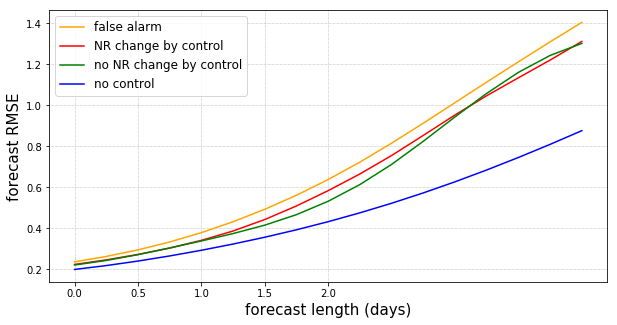

In [375]:
#draw the forecast error and spread for different situation
color = ['orange', 'red', 'green', 'blue']
label = ['false alarm', 'NR change by control', 'no NR change by control', 'no control']
plt.figure(figsize=(10,5))
for i in range(len(err_coll)):
    plt.plot(err_coll[i,:], color = color[i], label = label[i])
    #plt.plot(sprd_coll[i,:], color = color[i], label = label[i], linestyle='dashed')
plt.grid(color = 'grey', linestyle = ':', linewidth =0.5)
plt.xlabel('forecast length (days)', fontsize = 15)
plt.ylabel('forecast RMSE', fontsize = 15)
plt.xticks(np.arange(0,9,2), np.arange(0,2.1,0.5))
plt.legend(loc = 'best', fontsize = 12)
#plt.savefig('fcst_err_%s_%sday_rad%s_trial%s'%(int(10*rk+1e-6),days_before,per_rad,trial), bbox_inches = 'tight')

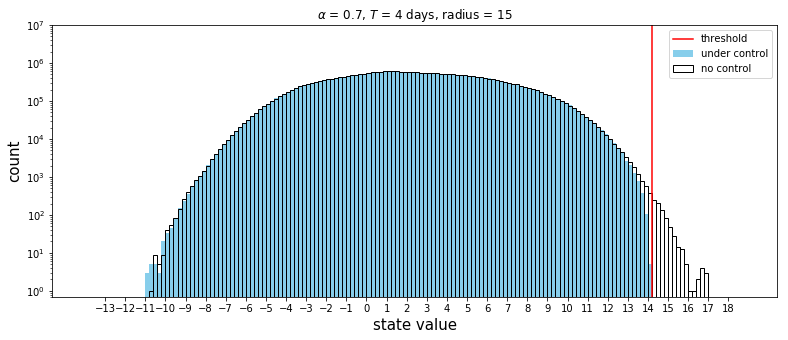

In [376]:
full_nature = sv.getTrajectory()
full_nature_flatten = full_nature.flatten()
evo_history_flatten = evo_history[:,:].flatten()
plt.figure(figsize = (13,5))
plt.hist(evo_history_flatten, bins = np.arange(-14,19,0.2),log = True, density = False, facecolor = 'skyblue', label = 'under control')
plt.hist(full_nature_flatten, bins = np.arange(-14,19,0.2),log = True, density = False, edgecolor = 'k', facecolor = 'None', label ='no control')
plt.xticks(np.arange(-13,19,1))
plt.ylim(1e0 - 0.3,1e7)
plt.axvline(x=threshold,color = 'r', label='threshold')
plt.xlabel('state value', fontsize = 15)
plt.ylabel('count', fontsize = 15)
plt.legend(loc='best')
plt.title(r'$\alpha$ = %s, $T$ = %s days, radius = %s'%(rk,days_before, per_rad))
plt.savefig('partial_perturbation/after_control_hist_%s_%sday_lrad%s_trial%s'%(int(10*rk+1e-6),days_before, per_rad,trial), bbox_inches = 'tight', dpi = 300)
plt.show()


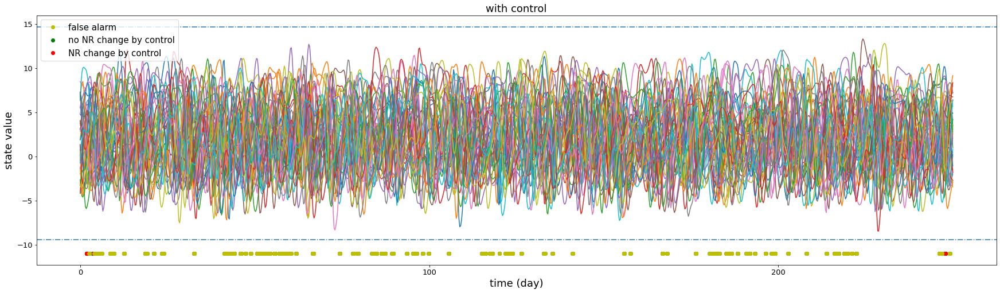

In [27]:
for i in range(xdim):
    plt.plot(np.arange(0,inter_step*experiment_step+1,inter_step),evo_history[i,::inter_step])
plt.axhline(y = ub, linestyle = '-.')
plt.axhline(y = lb, linestyle = '-.')
for j in range(len(perturbed_time)):
    plt.plot(perturbed_time[j],-11, linestyle = 'None', marker = 'o', color = 'g')
for j in range(len(success_perturbed_time)):
    plt.plot(success_perturbed_time[j],-11, linestyle = 'None', marker = 'o', color = 'r')
for j in range(len(false_alarm_perturbed_time)):
    plt.plot(false_alarm_perturbed_time[j],-11, linestyle = 'None', marker = 'o', color = 'y')
plt.plot([],linestyle = 'None', marker = 'o', color = 'y', label = 'false alarm')  
plt.plot([],linestyle = 'None', marker = 'o', color = 'g', label = 'no NR change by control') 
plt.plot([],linestyle = 'None', marker = 'o', color = 'r', label = 'NR change by control') 
plt.title('with control', fontsize = 18)
plt.xlabel('time (day)', fontsize = 18)
plt.xticks(np.arange(0,inter_step*experiment_step,100*20), np.arange(0,int(experiment_step/4 + 1e-6),100), fontsize = 13)
plt.yticks(fontsize = 13)
plt.ylabel('state value', fontsize = 18)
plt.legend(loc = 'best', fontsize = 15)
#plt.savefig('with_coutrol_oneline', bbox_inches = 'tight')
#plt.savefig('with_coutrol', bbox_inches = 'tight')

In [17]:
max(evo_history_flatten)

14.366977044335842

In [26]:
infile = 'lorenz96_run.pkl'
sv = state_vector()
sv = sv.load(infile)
full_nature = sv.getTrajectory()

In [46]:
np.shape(full_nature)

(40, 730001)

In [47]:
sorted(full_nature.flatten(),reverse = True)

[16.83482401397355,
 16.81424402201827,
 16.80506856059459,
 16.739092689923456,
 16.728064649223132,
 16.605742131255305,
 16.604103445466762,
 16.438964217109618,
 16.403210481303095,
 16.227699824947862,
 16.129885764881216,
 15.971257351248818,
 15.90586400859198,
 15.893159207631552,
 15.870349166871723,
 15.829120010747383,
 15.790899071241881,
 15.777560745180502,
 15.763405184621512,
 15.749203222789328,
 15.745909793440244,
 15.711979785920512,
 15.710657539151775,
 15.689200509853501,
 15.67273624008977,
 15.668557680510073,
 15.6544441059083,
 15.606970738533446,
 15.606127125811454,
 15.586131554907377,
 15.586086449293935,
 15.58516226105224,
 15.579931873066242,
 15.543382908795294,
 15.541429155845341,
 15.525726940428411,
 15.521755969676315,
 15.509537407730699,
 15.484240970049205,
 15.44095842808983,
 15.430452927004584,
 15.426832329594042,
 15.410224446145461,
 15.34424728425623,
 15.340097992603813,
 15.339714645405516,
 15.337829711027432,
 15.335135497980248,
 1

In [43]:
np.shape(x_nature)

(40, 146000)

In [44]:
np.shape(evo_history)

(40, 50001)

In [9]:
#time point of maximum and minimum
t_series_max = int(extreme_series[19,1,7]+0.0001)
t_series_min = int(extreme_series[6,1,4]+0.0001)
print('time point of maximum =', t_series_max)
print('time point of maximum =', t_series_min)

time point of maximum = 122724
time point of maximum = 27791


In [10]:
import matplotlib.colors as mcolors
mcolors.CSS4_COLORS

{'aliceblue': '#F0F8FF',
 'antiquewhite': '#FAEBD7',
 'aqua': '#00FFFF',
 'aquamarine': '#7FFFD4',
 'azure': '#F0FFFF',
 'beige': '#F5F5DC',
 'bisque': '#FFE4C4',
 'black': '#000000',
 'blanchedalmond': '#FFEBCD',
 'blue': '#0000FF',
 'blueviolet': '#8A2BE2',
 'brown': '#A52A2A',
 'burlywood': '#DEB887',
 'cadetblue': '#5F9EA0',
 'chartreuse': '#7FFF00',
 'chocolate': '#D2691E',
 'coral': '#FF7F50',
 'cornflowerblue': '#6495ED',
 'cornsilk': '#FFF8DC',
 'crimson': '#DC143C',
 'cyan': '#00FFFF',
 'darkblue': '#00008B',
 'darkcyan': '#008B8B',
 'darkgoldenrod': '#B8860B',
 'darkgray': '#A9A9A9',
 'darkgreen': '#006400',
 'darkgrey': '#A9A9A9',
 'darkkhaki': '#BDB76B',
 'darkmagenta': '#8B008B',
 'darkolivegreen': '#556B2F',
 'darkorange': '#FF8C00',
 'darkorchid': '#9932CC',
 'darkred': '#8B0000',
 'darksalmon': '#E9967A',
 'darkseagreen': '#8FBC8F',
 'darkslateblue': '#483D8B',
 'darkslategray': '#2F4F4F',
 'darkslategrey': '#2F4F4F',
 'darkturquoise': '#00CED1',
 'darkviolet': '#9400D3

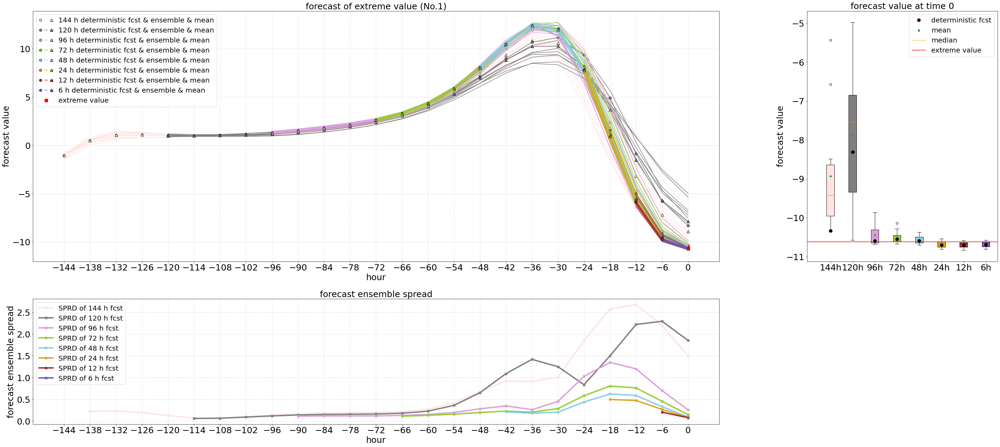

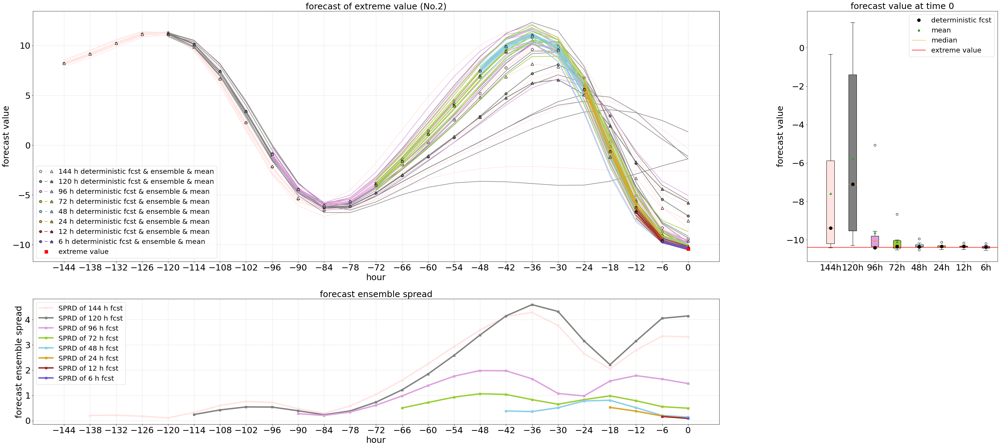

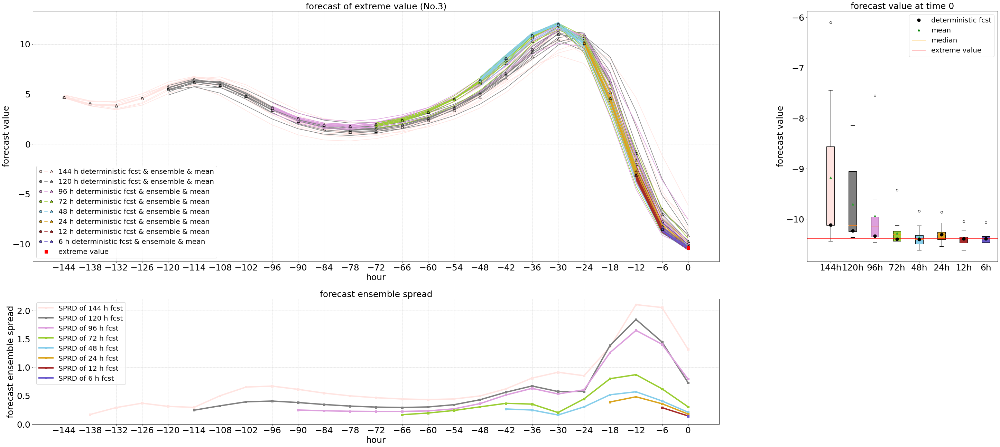

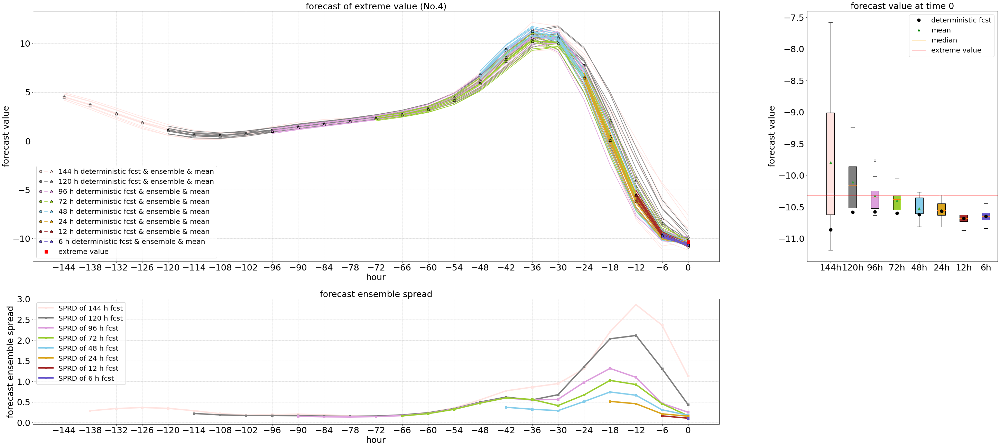

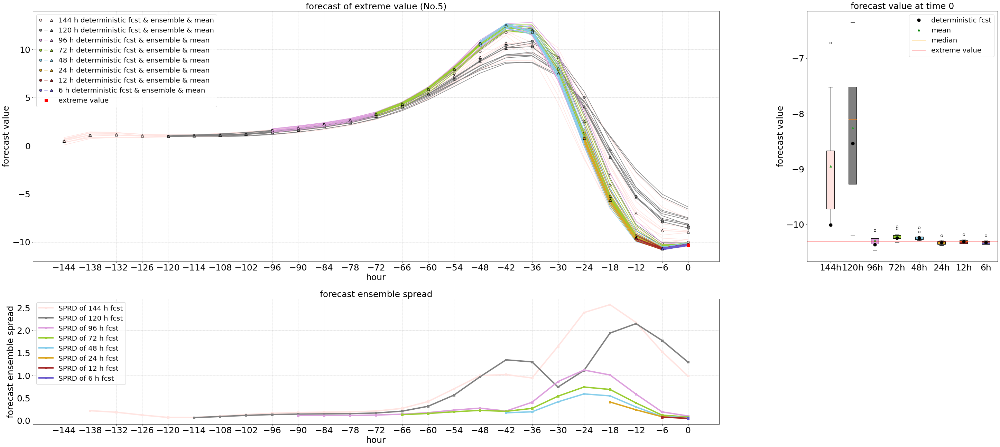

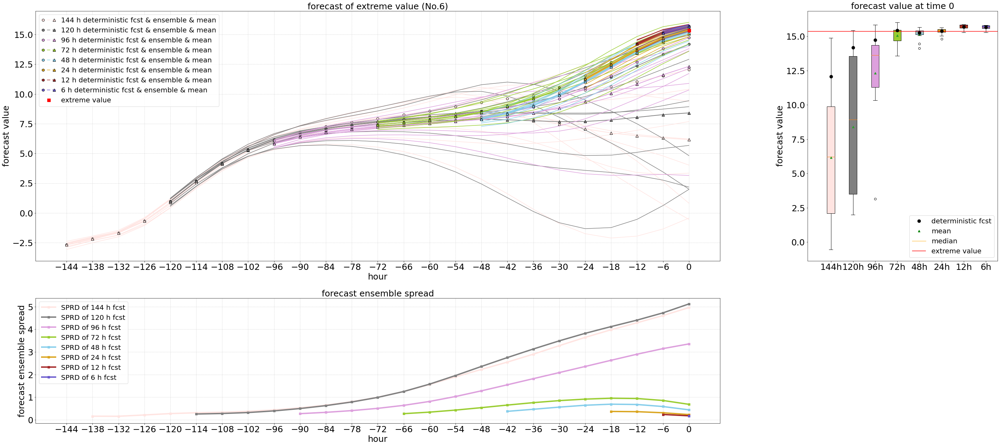

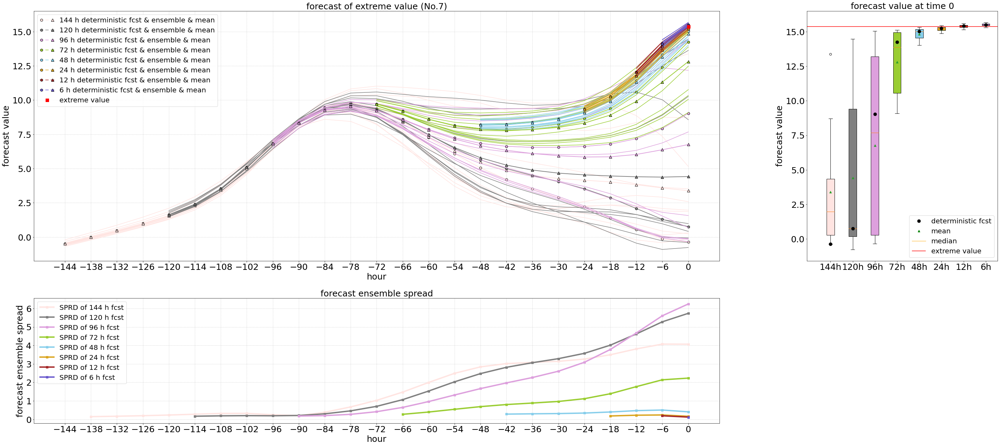

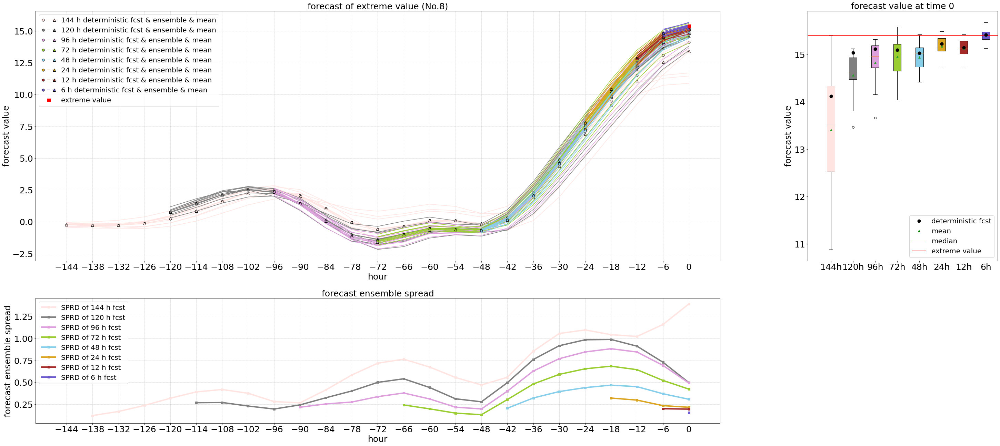

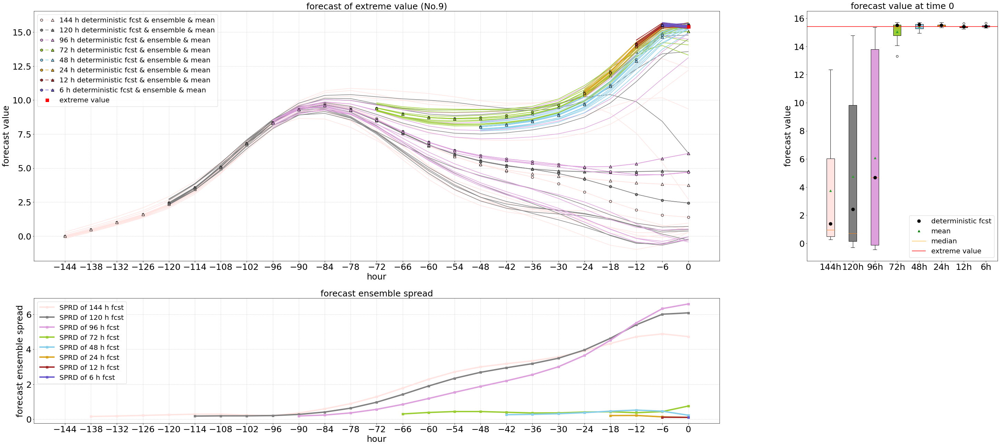

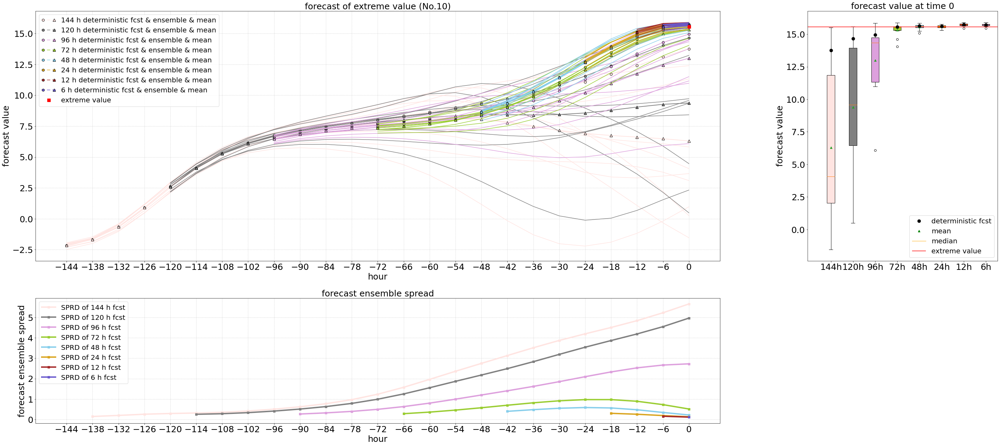

In [344]:
import matplotlib.ticker as mticker
import matplotlib
import pylab as pl
color = ['mistyrose','grey','#DDA0DD','yellowgreen','skyblue','goldenrod','brown','slateblue']
smd = LORENZ96(N = 40, F = 8)
def predict_extreme(p,extreme_time_point, state_number, Xanalysis_hist,Xforecast_hist, x_nature, filename = 'name'):
    figure, axes = plt.subplots(2, 2,figsize = (50,22), gridspec_kw={'width_ratios': [1.8,0.5],'height_ratios': [2,1]})
    iro_count = 0
    position = np.arange(-127,0,17)
    for i in [24, 20,16,12, 8, 4, 2, 1]:
        #Xa_initial = Xanalysis_hist[extreme_time_point - i, :, :]
        Xa_initial = np.hstack((Xanalysis_hist[extreme_time_point - i, :, :],(np.matrix(np.mean(Xanalysis_hist[extreme_time_point - i, :, :],axis=1))).T))
        Xa_initial = np.matrix(Xa_initial)
        t = np.arange(0,i + 0.1,0.2)
        for s in range(len(t)):
            t[s] = int(100*(t[s] / 20)+0.1)/100
            
        t_output = np.arange(0, i + 0.2, 1)
        for s in range(len(t_output)):
            t_output[s] = int(100*(t_output[s] / 20)+0.1)/100
        xf_4d_box= np.zeros((das.edim + 1 , das.xdim, i+1))
        
        for k in range(das.edim + 1):   
            xf_ens = smd.run(Xa_initial[:,k].A1, t, t_output)
            xf_ens = xf_ens.y # xdim * #(t_output)
            xf_4d_box[k,:,:] = xf_ens
            axes[0,0].plot(np.arange(-6*i,1,6),xf_4d_box[k,state_number-1,:], color=color[iro_count], linewidth = 1.5, label=('' if k==0 else '_') + '%s h deterministic fcst & ensemble & mean'%(i*6))         
        axes[0,0].plot(np.arange(-6*i,1,6),xf_4d_box[k,state_number-1,:], color=color[iro_count], linestyle = '-',marker = 'o', markersize = 7, markerfacecolor = color[iro_count], markeredgecolor = 'k', linewidth = 1.5, label=('%s h deterministic fcst & ensemble & mean'%(i*6)))    
        axes[0,0].plot(np.arange(-6*i,1,6),np.mean(xf_4d_box[:,state_number-1,:],axis = 0), marker = '^', markersize = 8, markerfacecolor = color[iro_count], markeredgecolor = 'k', color= color[iro_count], linewidth = 2, label=('%s h deterministic fcst & ensemble & mean'%(i*6)))
        axes[0,1].boxplot(xf_4d_box[:,state_number-1,-1], positions = [position[iro_count]], patch_artist=True,boxprops=dict(facecolor= color[iro_count],  # boxの塗りつぶし色の設定
                         color='black', linewidth=1), showmeans = True, widths = 6, zorder = 1)
        axes[0,1].plot(position[iro_count], xf_4d_box[k,state_number-1,-1], linestyle = 'None', marker = 'o', markersize = 9, markerfacecolor = 'k', markeredgecolor = 'k', label = ('' if iro_count==0 else '_') + 'deterministic fcst')
        axes[1,0]= plt.subplot(axes[1,0],sharex = axes[0,0])
        axes[1,0].plot(-i*6, 0.1, color = 'white')
        axes[1,0].plot(np.arange(-i*6+6,0+1,6),np.std(xf_4d_box[:,state_number-1,1:],axis = 0), color = color[iro_count], linewidth = 4, marker = 's', label = 'SPRD of %s h fcst'%(i*6))
        axes[1,0].set_xticks(np.arange(-144,2,6))
        axes[1,0].tick_params(axis='y', labelsize=25)
        axes[1,0].tick_params(axis='x', labelsize=25)
        axes[1,0].grid(color = 'grey', linestyle = ':', linewidth = 0.5)
        axes[1,0].set_xlabel('hour', fontsize = 25)
        axes[1,0].set_ylabel('forecast ensemble spread', fontsize = 25)
        axes[1,0].set_title('forecast ensemble spread',fontsize = 25)
        axes[1,0].legend(loc = 'best', fontsize = 20)
        iro_count = iro_count + 1
    axes[0,1].hlines(x_nature[state_number-1, extreme_time_point],xmin = -10000, xmax = 10000, color = 'red', linestyle = '-', label = 'extreme value' )
    axes[0,0].plot(0,x_nature[state_number-1, extreme_time_point], marker = 's', color = 'red', linestyle = 'None', markersize = 9, label = 'extreme value' )
    axes[0,0].plot([],[],linestyle = 'None', marker = 'None', label = 'extreme value' )
    axes[0,0].plot([],[],linestyle = 'None', marker = 'None', label = 'extreme value' )
    axes[0,1].set_xticklabels(['144h','120h', '96h', '72h', '48h', '24h', '12h', '6h'])
    axes[0,1].tick_params(axis='y', labelsize=25)
    axes[0,1].tick_params(axis='x', labelsize=25)
    axes[0,1].set_title('forecast value at time 0',fontsize = 25)
    axes[0,1].set_ylabel('forecast value', fontsize = 25)
    axes[0,1].plot([], [], '^', linewidth=1, color='green', label='mean')
    axes[0,1].plot([], [], '-', linewidth=1, color='orange', label='median')
    axes[0,1].legend(loc = 'best', fontsize = 20)
    axes[0,1].set_xlim([-145,1])
    axes[0,0].set_xticks(np.arange(-144,1,6))
    axes[0,0].tick_params(axis='y', labelsize=25)
    axes[0,0].tick_params(axis='x', labelsize=25)
    axes[0,0].set_xlabel('hour', fontsize = 25)
    axes[0,0].set_ylabel('forecast value', fontsize = 25)
    axes[0,0].set_title('forecast of extreme value (No.%s)'%(p+1),fontsize = 25)
    #axes[0,0].legend()
    h, l = axes[0,0].get_legend_handles_labels()
    axes[0,0].legend(handles=zip(h[1::3],h[::3],h[2::3]), labels=l[::3], handler_map = {tuple: matplotlib.legend_handler.HandlerTuple(None)},fontsize = 20)
    axes[0,0].grid(color = 'grey', linestyle = ':', linewidth = 0.5)
    axes[-1,-1].axis('off')
    plt.savefig(filename)
    plt.show()

for p in range(len(glo_extreme_series[0,:])):
#for p in range(3,4):
    predict_extreme(p,int(glo_extreme_series[2,p]+0.0001), int(glo_extreme_series[1,p]+0.0001), Xa_history, Xf_history, x_nature, filename = 'extreme_prediction_no%s'%(p+1))
    
    


In [294]:
normal_series = np.zeros((3,10))
for i in range(10):
    state = random.randint(1,40)
    timepoint = random.randint(0,146000)
    normal_series[:,i] = [x_nature[state-1,timepoint],state,timepoint]
print(normal_series)

[[ 2.48547474e+00  6.90843145e+00  5.76393112e+00  4.84323975e+00
  -5.07141699e+00  7.37037105e+00 -3.85807410e+00 -2.86293401e+00
   7.63657495e+00 -3.46682219e+00]
 [ 1.50000000e+01  1.60000000e+01  2.80000000e+01  1.40000000e+01
   2.10000000e+01  1.70000000e+01  1.10000000e+01  2.40000000e+01
   4.00000000e+00  3.10000000e+01]
 [ 8.97130000e+04  1.47680000e+04  4.36040000e+04  1.43463000e+05
   8.51900000e+04  1.01539000e+05  5.11920000e+04  1.21112000e+05
   1.25921000e+05  1.57320000e+04]]


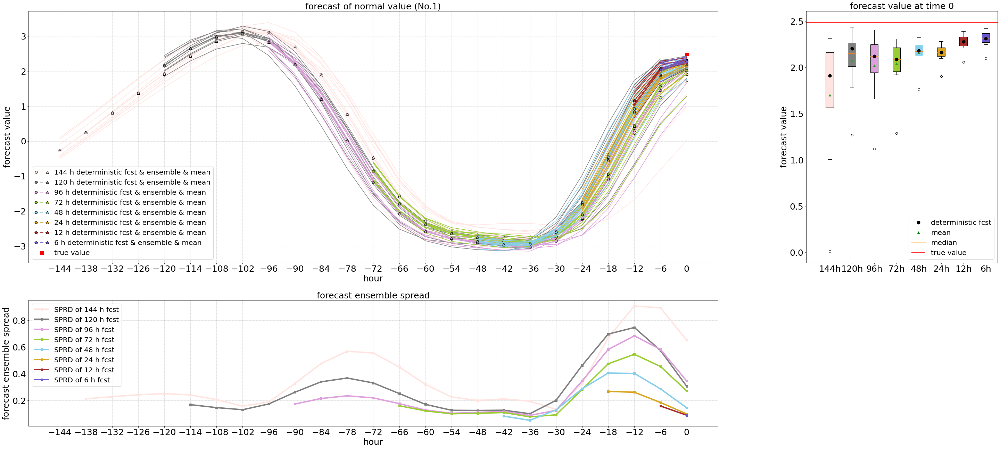

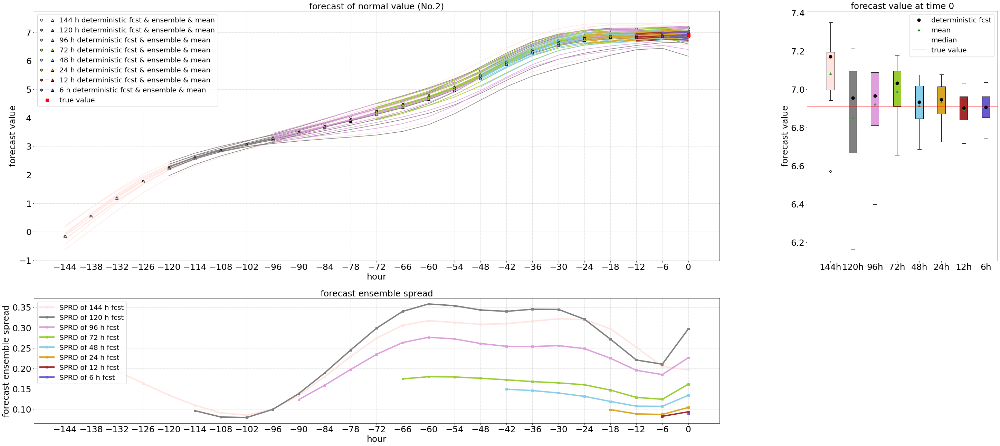

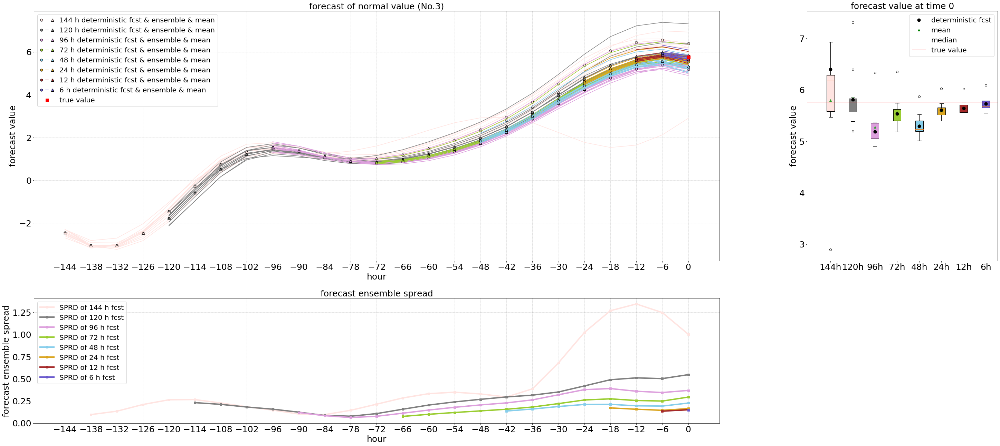

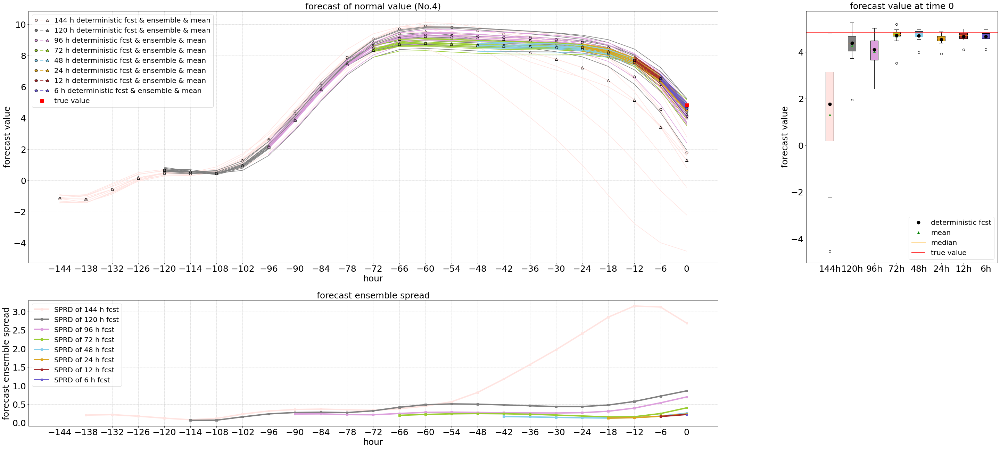

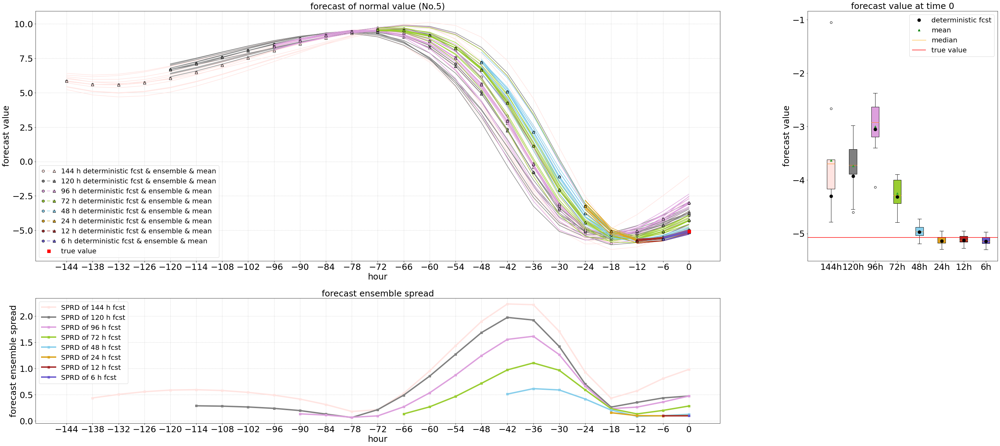

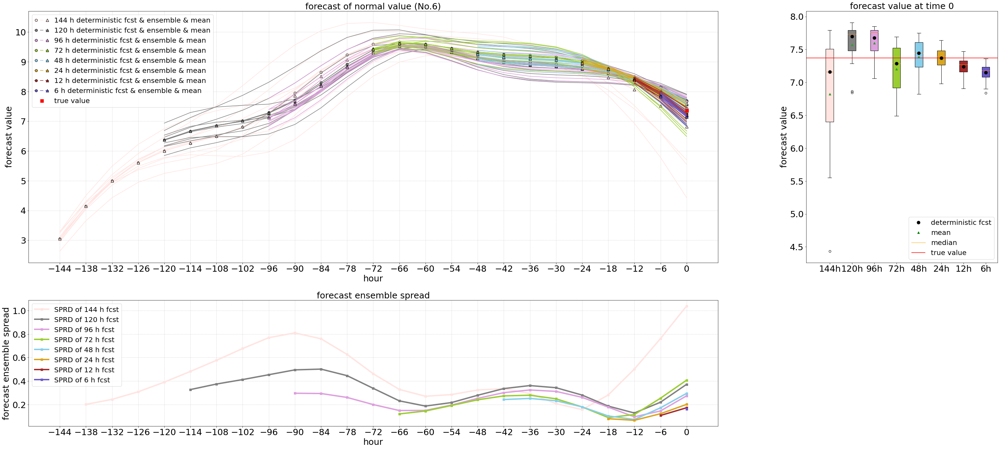

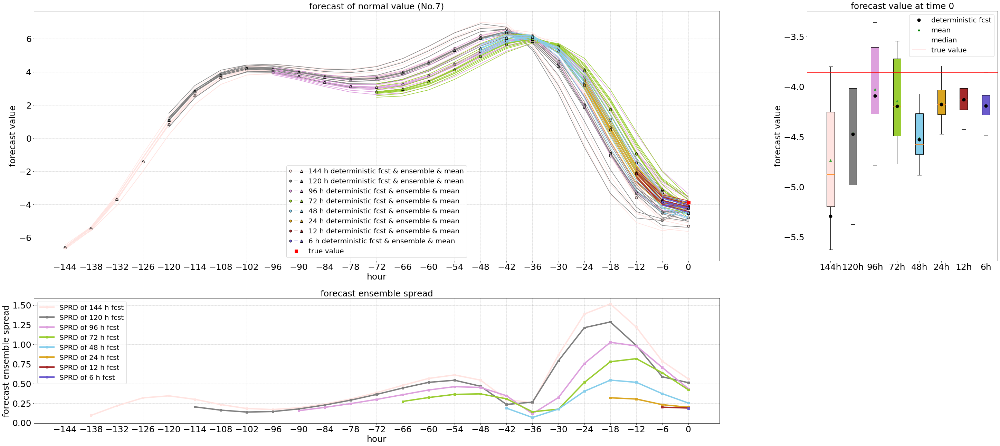

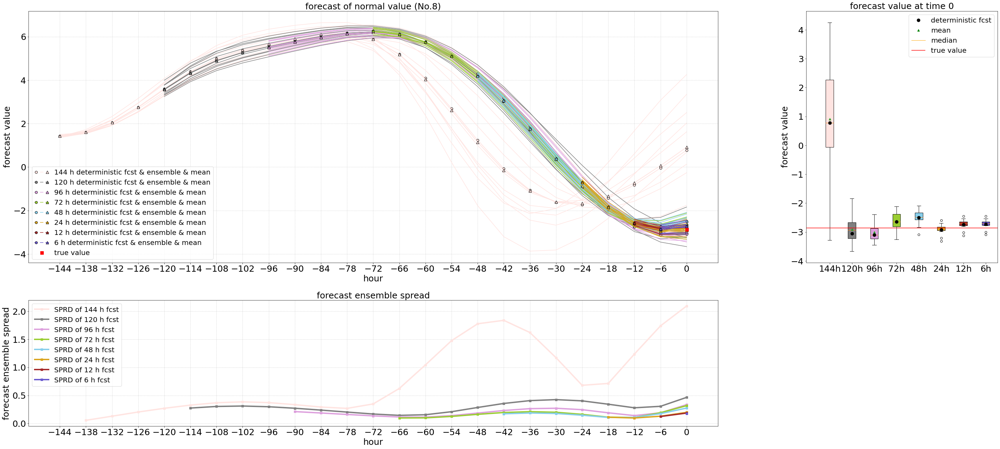

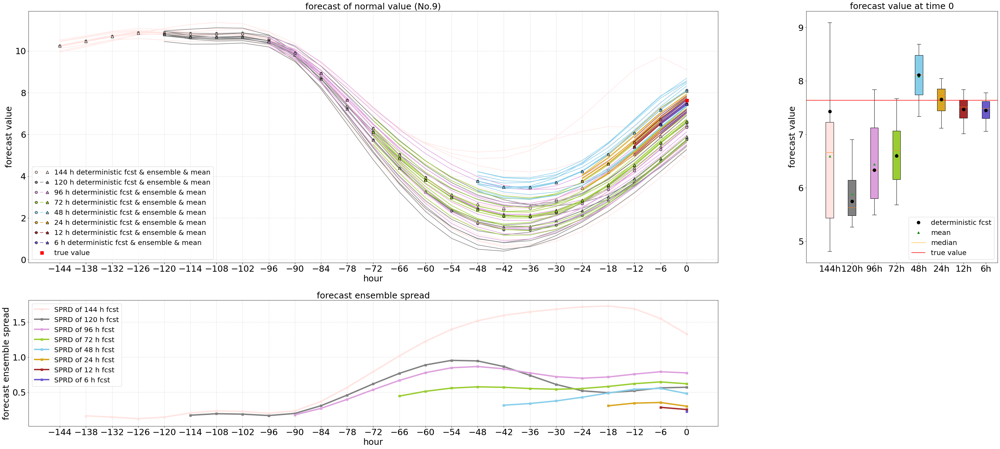

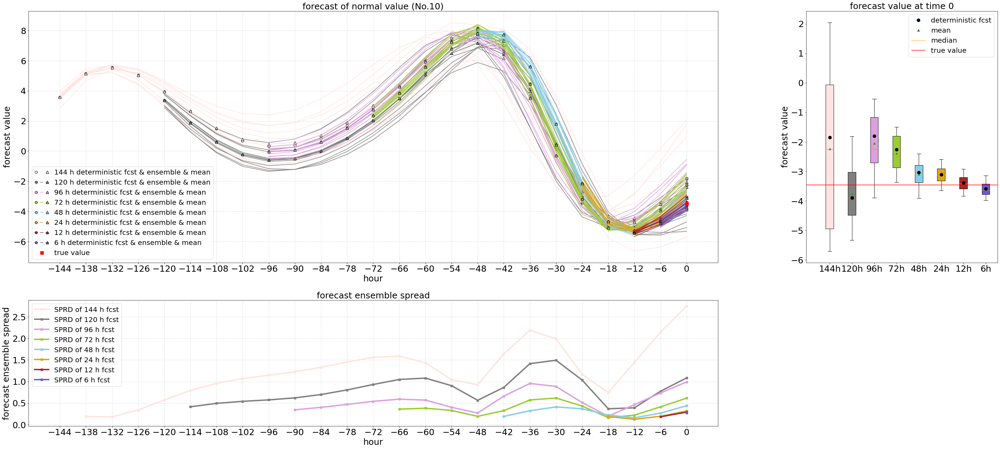

In [345]:
import matplotlib.ticker as mticker
import matplotlib
import pylab as pl
color = ['mistyrose','grey','#DDA0DD','yellowgreen','skyblue','goldenrod','brown','slateblue']
smd = LORENZ96(N = 40, F = 8)
def predict_normal(p,extreme_time_point, state_number, Xanalysis_hist,Xforecast_hist, x_nature, filename = 'name'):
    figure, axes = plt.subplots(2, 2,figsize = (50,22), gridspec_kw={'width_ratios': [1.8,0.5],'height_ratios': [2,1]})
    iro_count = 0
    position = np.arange(-127,0,17)
    for i in [24, 20,16,12, 8, 4, 2, 1]:
        #Xa_initial = Xanalysis_hist[extreme_time_point - i, :, :]
        Xa_initial = np.hstack((Xanalysis_hist[extreme_time_point - i, :, :],(np.matrix(np.mean(Xanalysis_hist[extreme_time_point - i, :, :],axis=1))).T))
        Xa_initial = np.matrix(Xa_initial)
        t = np.arange(0,i + 0.1,0.2)
        for s in range(len(t)):
            t[s] = int(100*(t[s] / 20)+0.1)/100
            
        t_output = np.arange(0, i + 0.2, 1)
        for s in range(len(t_output)):
            t_output[s] = int(100*(t_output[s] / 20)+0.1)/100
        xf_4d_box= np.zeros((das.edim + 1, das.xdim, i+1))
        
        for k in range(das.edim + 1):   
            xf_ens = smd.run(Xa_initial[:,k].A1, t, t_output)
            xf_ens = xf_ens.y # xdim * #(t_output)
            xf_4d_box[k,:,:] = xf_ens
            axes[0,0].plot(np.arange(-6*i,1,6),xf_4d_box[k,state_number-1,:], color=color[iro_count], linewidth = 1.5, label=('' if k==0 else '_') + '%s h deterministic fcst & ensemble & mean'%(i*6))         
            
        axes[0,0].plot(np.arange(-6*i,1,6),xf_4d_box[k,state_number-1,:], color=color[iro_count], marker = 'o', markersize = 7, markerfacecolor = color[iro_count], markeredgecolor = 'k', linewidth = 1.5, label=('%s h deterministic fcst & ensemble & mean'%(i*6)))
        axes[0,0].plot(np.arange(-6*i,1,6),np.mean(xf_4d_box[:,state_number-1,:],axis = 0), marker = '^', markersize = 8, markerfacecolor = color[iro_count], markeredgecolor = 'k', color= color[iro_count], linewidth = 2, label=('%s h deterministic fcst & ensemble & mean'%(i*6)))
        axes[0,1].boxplot(xf_4d_box[:,state_number-1,-1], positions = [position[iro_count]], patch_artist=True,boxprops=dict(facecolor= color[iro_count],  # boxの塗りつぶし色の設定
                         color='black', linewidth=1), showmeans = True, widths = 6, zorder = 1)
        axes[0,1].plot(position[iro_count], xf_4d_box[k,state_number-1,-1], linestyle = 'None', marker = 'o', markersize = 9, markerfacecolor = 'k', markeredgecolor = 'k', label = ('' if iro_count==0 else '_') + 'deterministic fcst')
        axes[1,0]= plt.subplot(axes[1,0],sharex = axes[0,0])
        axes[1,0].plot(-i*6, 0.1, color = 'white')
        axes[1,0].plot(np.arange(-i*6+6,0+1,6),np.std(xf_4d_box[:,state_number-1,1:],axis = 0), color = color[iro_count], linewidth = 4, marker = 's', label = 'SPRD of %s h fcst'%(i*6))
        axes[1,0].set_xticks(np.arange(-144,2,6))
        axes[1,0].tick_params(axis='y', labelsize=25)
        axes[1,0].tick_params(axis='x', labelsize=25)
        axes[1,0].grid(color = 'grey', linestyle = ':', linewidth = 0.5)
        axes[1,0].set_xlabel('hour', fontsize = 25)
        axes[1,0].set_ylabel('forecast ensemble spread', fontsize = 25)
        axes[1,0].set_title('forecast ensemble spread',fontsize = 25)
        axes[1,0].legend(loc = 'best', fontsize = 20)
        iro_count = iro_count + 1
    axes[0,1].hlines(x_nature[state_number-1, extreme_time_point],xmin = -10000, xmax = 10000, color = 'red', linestyle = '-', label = 'true value' )
    axes[0,0].plot(0,x_nature[state_number-1, extreme_time_point], marker = 's', color = 'red', linestyle = 'None', markersize = 9, label = 'true value' )
    axes[0,0].plot([],[],linestyle = 'None', marker = 'None', label = 'true value' )
    axes[0,0].plot([],[],linestyle = 'None', marker = 'None', label = 'true value' )
    axes[0,1].set_xticklabels(['144h','120h', '96h', '72h', '48h', '24h', '12h', '6h'])
    axes[0,1].tick_params(axis='y', labelsize=25)
    axes[0,1].tick_params(axis='x', labelsize=25)
    axes[0,1].set_title('forecast value at time 0',fontsize = 25)
    axes[0,1].set_ylabel('forecast value', fontsize = 25)
    axes[0,1].plot([], [], '^', linewidth=1, color='green', label='mean')
    axes[0,1].plot([], [], '-', linewidth=1, color='orange', label='median')
    axes[0,1].legend(loc = 'best', fontsize = 20)
    axes[0,1].set_xlim([-145,1])
    axes[0,0].set_xticks(np.arange(-144,1,6))
    axes[0,0].tick_params(axis='y', labelsize=25)
    axes[0,0].tick_params(axis='x', labelsize=25)
    axes[0,0].set_xlabel('hour', fontsize = 25)
    axes[0,0].set_ylabel('forecast value', fontsize = 25)
    axes[0,0].set_title('forecast of normal value (No.%s)'%(p+1),fontsize = 25)
    h, l = axes[0,0].get_legend_handles_labels()
    axes[0,0].legend(handles=zip(h[1::3],h[::3],h[2::3]), labels=l[::3], handler_map = {tuple: matplotlib.legend_handler.HandlerTuple(None)},fontsize = 20)
    axes[0,0].grid(color = 'grey', linestyle = ':', linewidth = 0.5)
    axes[-1,-1].axis('off')
    plt.savefig(filename)
    plt.show()  

for p in range(len(normal_series[0,:])):
    predict_normal(p,int(normal_series[2,p]+0.0001), int(normal_series[1,p]+0.0001), Xa_history, Xf_history, x_nature, filename = 'normal_prediction_no%s'%(p+1))
    
    

In [11]:
np.shape(Xa_history)

(146000, 40, 10)

In [42]:
a = (np.mean(Xa_history, axis = 2) - x_nature.T)[0:146000,:]

In [43]:
b =np.sqrt((np.sum(np.square(a),axis = 1))/40)

In [44]:
np.mean(b)

0.1989093841730834

In [45]:
sprd=[]
for i in range(146001):
    sprd.append(np.mean(np.std(Xa_history[i,:,:], axis = 1)))
np.mean(sprd)

0.19139705726729558